![UCA](https://univ-cotedazur.fr/medias/fichier/uca-logo-ligne-mono-bleu_1594383427225-)
# **Lab session 2: Backpropagation on neural networks**

## **Course: Optimization for data science**


#### Lab session proposed by
------------------------------------------------

### Rémy Sun
# Warning :
# "File -> Save a copy in Drive" before starting to modify the notebook, otherwise changes won't be saved.

In [3]:
!wget https://remysun.github.io/uploads/TPBackprop.zip
!unzip -j TPBackprop.zip
!wget https://remysun.github.io/uploads/utils-data.py

SyntaxError: invalid syntax (801024058.py, line 1)

In [2]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
%run 'utils-data.py'

C:\Users\praba\anaconda3\Lib\site-packages\IPython\core\magics\execution.py:726: UserWarning: For Windows, use double quotes to wrap a filename: %run "mypath\myfile.py"
  warn('For Windows, use double quotes to wrap a filename: %run "mypath\\myfile.py"')


Exception: File `"'utils-data.py'"` not found.

# Part 1 : Fully manual backprop

We start by initializing the weights! It is done for you here, no need to code anything.

**Question: Why do we initialize with random values here?**

**Answer**

we intialize the weights with random variable so the hidden layer can be symmetric.if we initialized with the same value, say zeroes, each neuron in the layer will get the same signal and the same update during training phase. As such, it becomes impossile for different neurons to learn different features. By using these random values, our neurons can starts in slighly different place, which can promote efficient learning.

In [ ]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    params["Wh"] = torch.randn((nh, nx))*0.3
    params["Wy"] = torch.randn((ny, nh))*0.3
    params["bh"] = torch.zeros((nh,1))
    params["by"] = torch.zeros((ny,1))

    return params

Now we need to put the weight together into an actual neural network. Implement the forward function.

In [ ]:
def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params['Wh'].size(0)
    ny = params['Wy'].size(0)
    outputs = {}

    outputs["X"] = X
    outputs["htilde"] = torch.mm(X, params["Wh"].T) + params["bh"].T
    outputs["h"] = torch.tanh(outputs["htilde"])
    outputs["ytilde"] = torch.mm(outputs["h"], params["Wy"].T) + params["by"].T
    outputs["yhat"] = torch.exp(outputs["ytilde"])
    outputs["yhat"] = outputs["yhat"] / outputs["yhat"].sum(dim=-1, keepdim=True)

    return outputs['yhat'], outputs

An additional part of computations is also to compute the loss functions, but this has little bearing on this lab session so it is done for you here.

In [ ]:
def loss_accuracy(Yhat, Y):


    L = - torch.mean((Y * torch.log(Yhat)).sum(dim=1)) # mean for the batch

    _, indYhat = torch.max(Yhat, 1)
    _, indY = torch.max(Y, 1)

    acc = torch.sum(indY == indYhat) * 100. / indY.size(0);


    return L, acc

And now we need to implement the actual backpropagation algorithm: time to get the gradients!

**Question: How do you get gradients for the different weights?**

Answer:

we get the gradients for the different weights by Computing the Gradient of the Loss with Respect to the Outputs (dL/d^y), Output Layer Gradients (Weights Wy and Biases by) and the Hidden Layer Gradients (Weights Wh and Biases bh).

In [ ]:
def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}

    #derivative of the cross entropy loss
    dL_dyhat = outputs['yhat'] - Y

    # Gradients of weights and biases in the output layer
    grads["Wy"] = torch.mm(dL_dyhat.T, outputs['h'])

    dL_dh = torch.mm(dL_dyhat, params["Wy"])
    dL_dhtilde = dL_dh * (1 - outputs['h']**2)
    grads["Wh"] = torch.mm(dL_dhtilde.T, outputs['X'])/bsize
    grads["by"] = dL_dyhat.sum(dim=0, keepdim=True).T / bsize
    grads["bh"] = dL_dhtilde.sum(dim=0, keepdim=True).T/bsize
    return grads

Finally we have to implement and SGD step, which you already did in the last practical.

In [ ]:
def sgd(params, grads, eta):
# Update each parameter in params by subtracting the gradient times the learning rate
    params['Wy'] -= eta * grads['Wy']
    params['Wh'] -= eta * grads['Wh']
    params['by'] -= eta * grads['by']
    params['bh'] -= eta * grads['bh']

    return params


## Manual global learning algorithm

We now put everything together to train the model!

**Question: Describe what happens during trainig (comment on the colors for instance)**


Answer:
as the training proceed, the model learns to distinguish between different classes of data by adjusting its parameters, weights and biases to minimize the loss function. The colors seem to represent the decision boundary it uses to differentiate. At the early stages, the boundary starts to form, but it's imprecise and doesn't separate the classes well. As the training continues, the decision boundary becomes more defined. The network starts to learn where to draw the line between the classes and at the end, the boundary is very obvious.

The plot curve shows the training and testing accurary and loss over the iterations. The trend shows an increasing acruracy and decreasing loss.

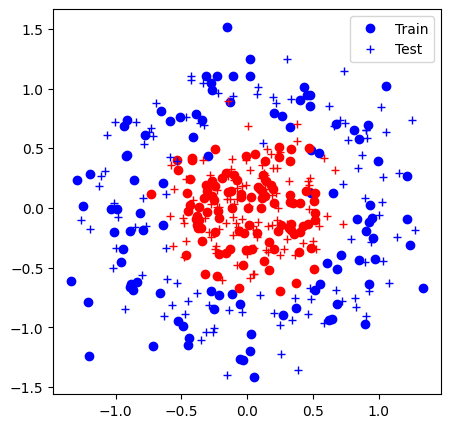

Iter 0: Acc train 51.5% (0.69), acc test 51.0% (0.70)


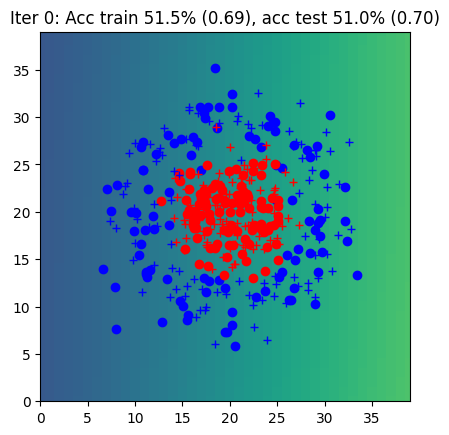

Iter 1: Acc train 52.5% (0.69), acc test 53.0% (0.69)


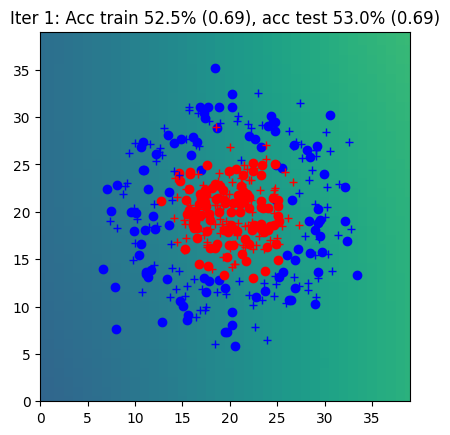

Iter 2: Acc train 56.0% (0.69), acc test 60.5% (0.69)


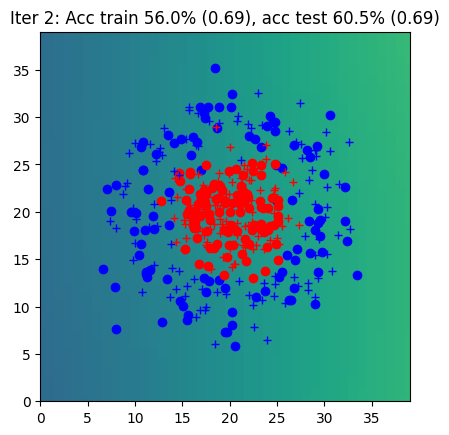

Iter 3: Acc train 55.0% (0.69), acc test 57.5% (0.69)


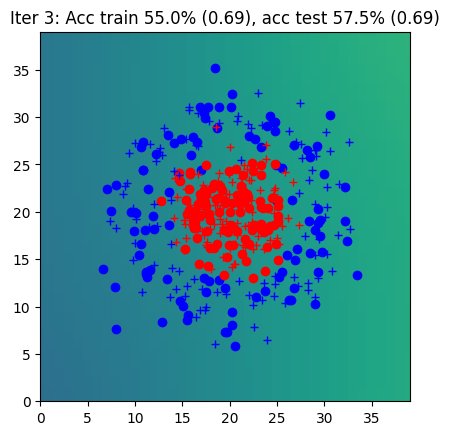

Iter 4: Acc train 52.0% (0.69), acc test 53.5% (0.69)


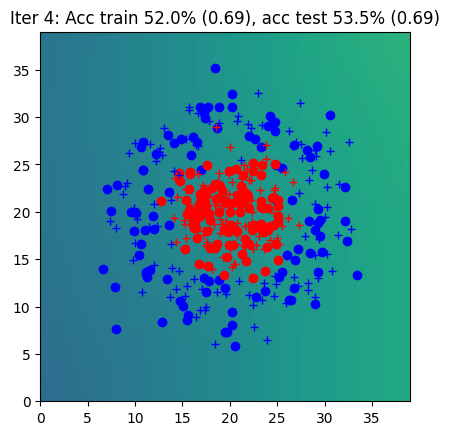

Iter 5: Acc train 51.5% (0.69), acc test 50.0% (0.69)


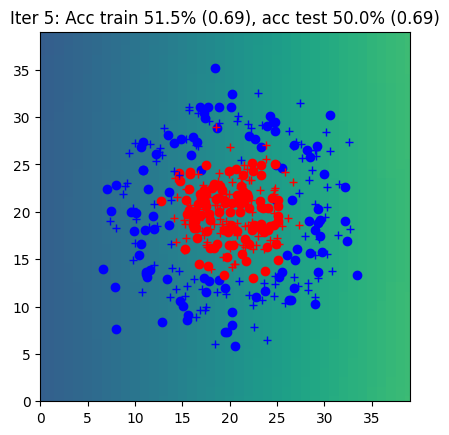

Iter 6: Acc train 53.0% (0.69), acc test 51.0% (0.69)


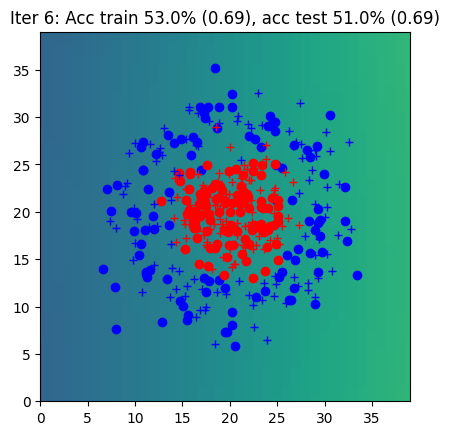

Iter 7: Acc train 49.5% (0.69), acc test 52.0% (0.69)


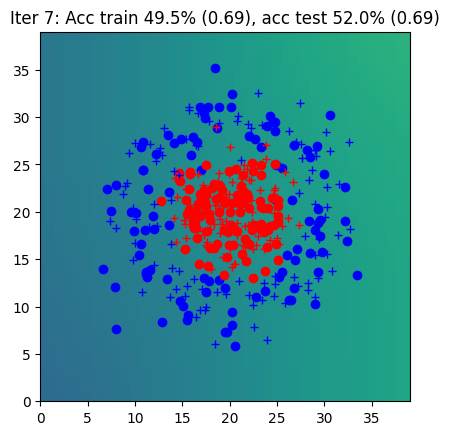

Iter 8: Acc train 54.0% (0.69), acc test 53.0% (0.69)


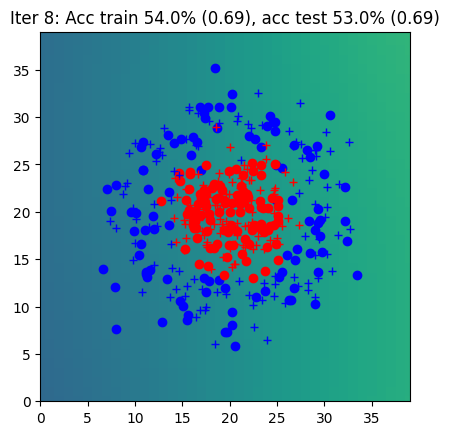

Iter 9: Acc train 55.5% (0.69), acc test 57.0% (0.69)


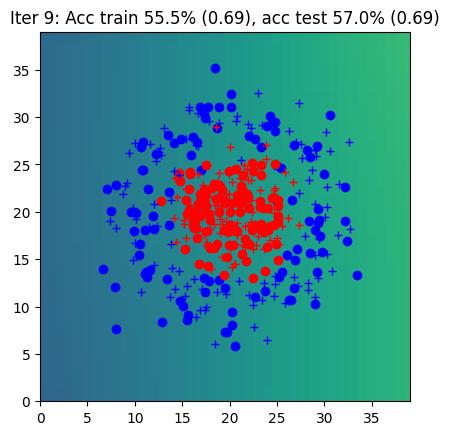

Iter 10: Acc train 54.5% (0.69), acc test 56.5% (0.69)


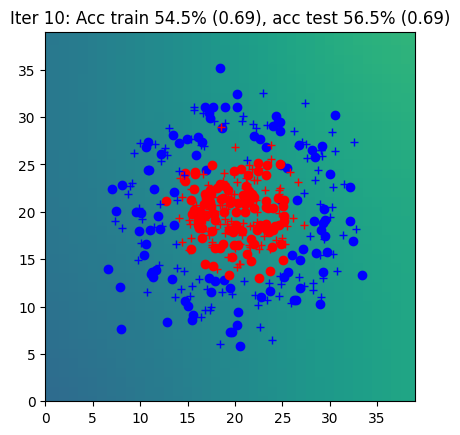

Iter 11: Acc train 53.5% (0.69), acc test 56.5% (0.69)


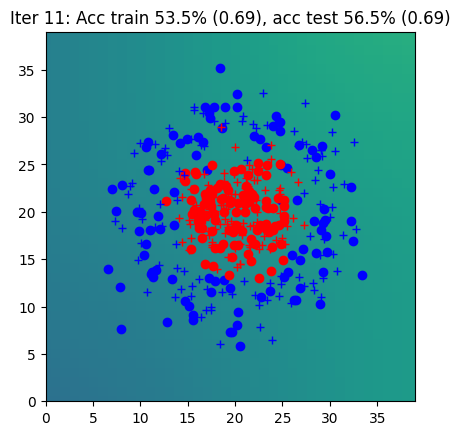

Iter 12: Acc train 51.0% (0.69), acc test 50.5% (0.69)


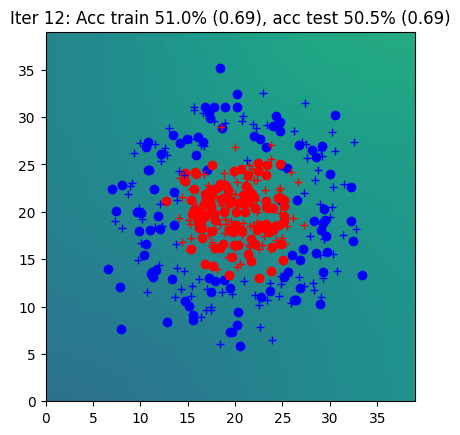

Iter 13: Acc train 47.5% (0.69), acc test 50.5% (0.69)


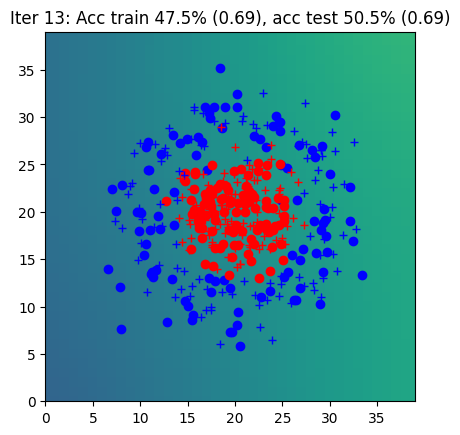

Iter 14: Acc train 57.5% (0.69), acc test 61.0% (0.69)


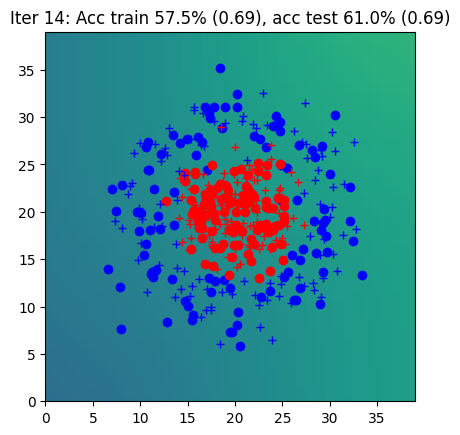

Iter 15: Acc train 56.5% (0.69), acc test 59.5% (0.69)


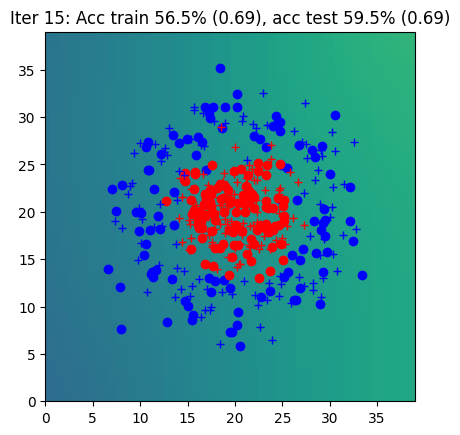

Iter 16: Acc train 55.5% (0.69), acc test 60.5% (0.69)


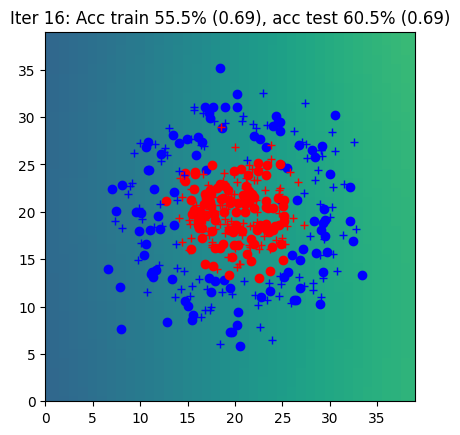

Iter 17: Acc train 56.0% (0.69), acc test 58.0% (0.69)


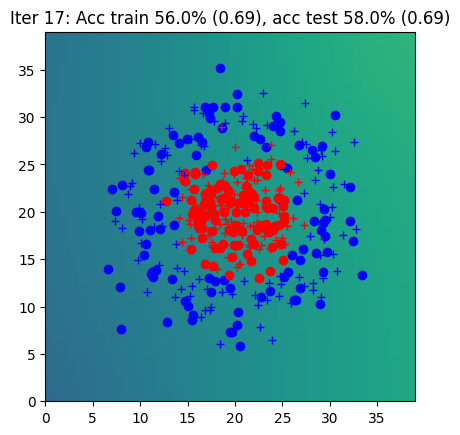

Iter 18: Acc train 55.5% (0.69), acc test 58.5% (0.69)


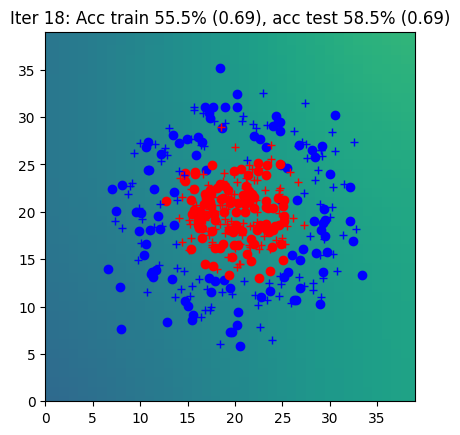

Iter 19: Acc train 53.5% (0.69), acc test 53.0% (0.69)


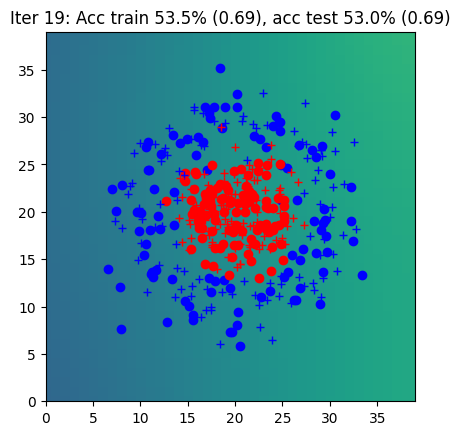

Iter 20: Acc train 54.0% (0.69), acc test 51.0% (0.69)


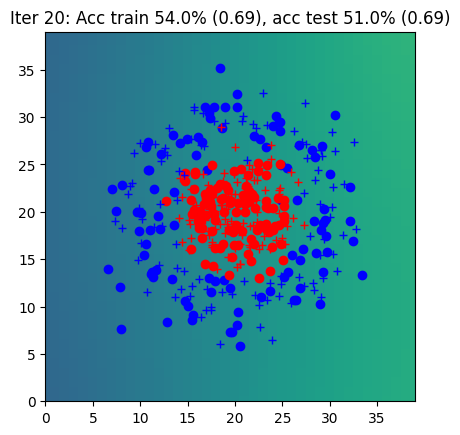

Iter 21: Acc train 58.0% (0.69), acc test 61.5% (0.69)


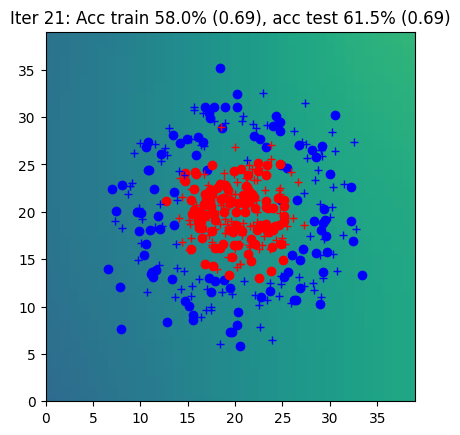

Iter 22: Acc train 64.5% (0.69), acc test 62.5% (0.69)


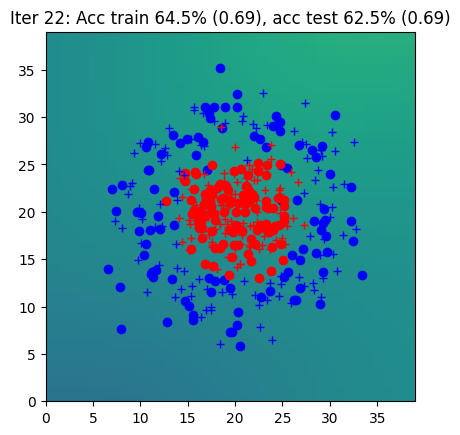

Iter 23: Acc train 57.5% (0.69), acc test 60.5% (0.69)


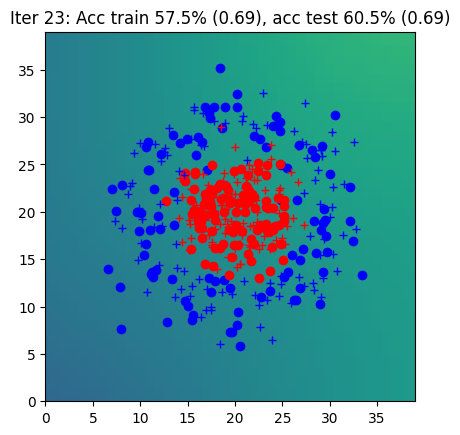

Iter 24: Acc train 54.5% (0.69), acc test 57.0% (0.69)


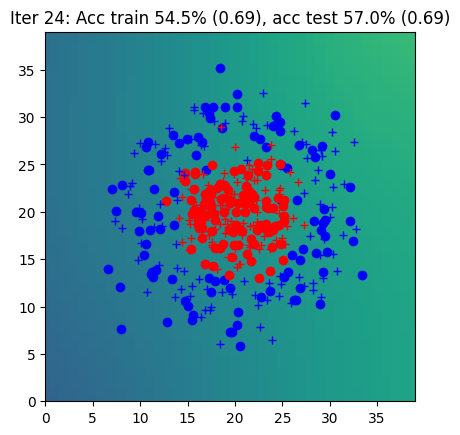

Iter 25: Acc train 54.5% (0.69), acc test 56.0% (0.69)


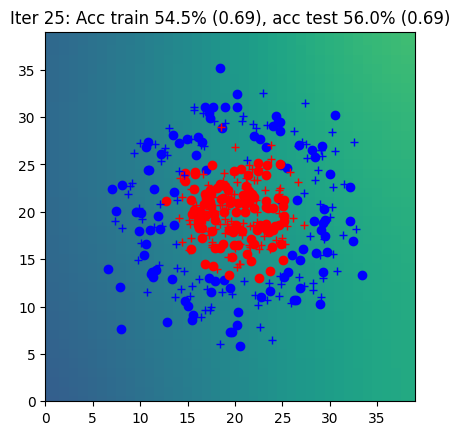

Iter 26: Acc train 56.0% (0.69), acc test 55.5% (0.69)


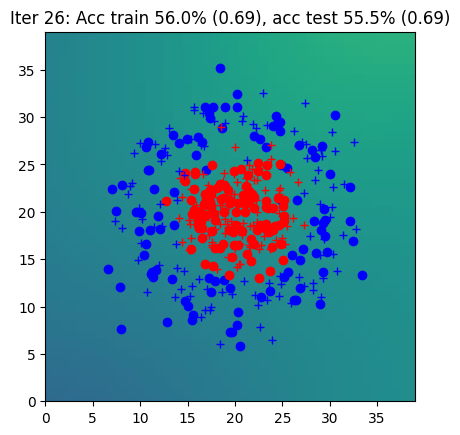

Iter 27: Acc train 55.0% (0.69), acc test 55.0% (0.69)


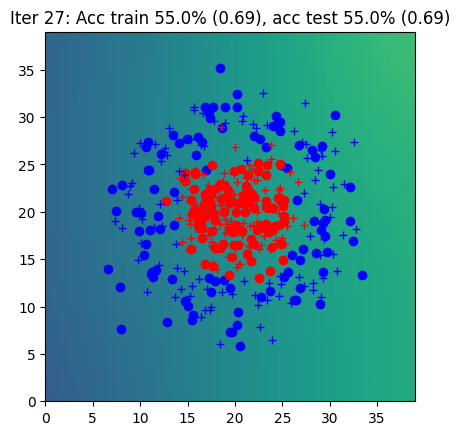

Iter 28: Acc train 59.5% (0.69), acc test 61.5% (0.69)


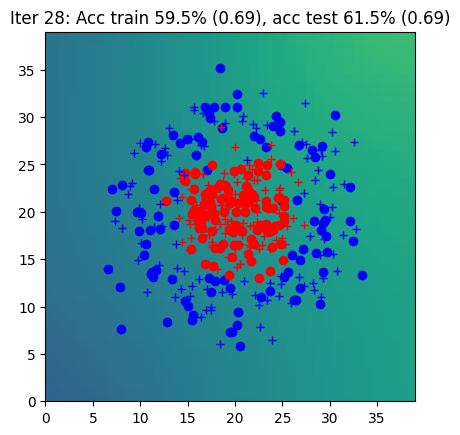

Iter 29: Acc train 66.0% (0.69), acc test 64.0% (0.69)


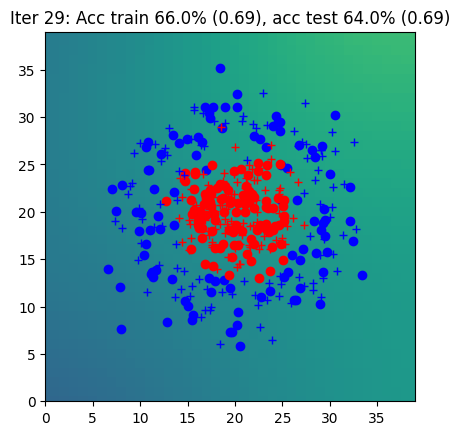

Iter 30: Acc train 67.5% (0.69), acc test 65.0% (0.69)


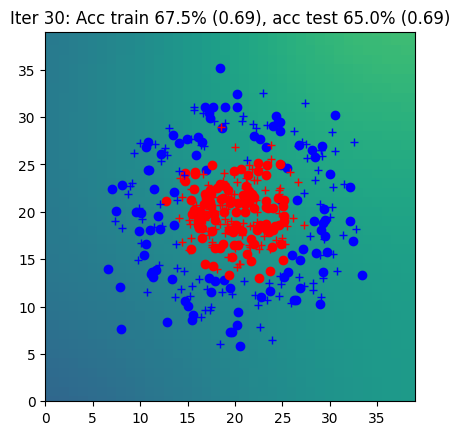

Iter 31: Acc train 62.5% (0.69), acc test 63.0% (0.69)


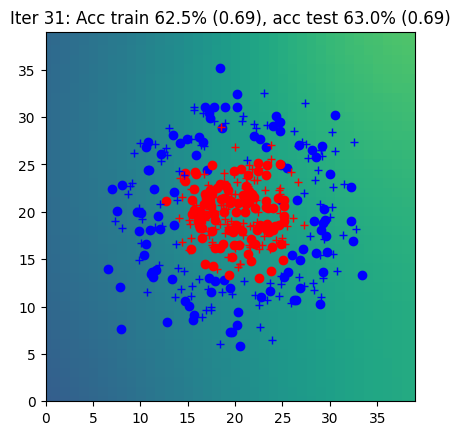

Iter 32: Acc train 56.5% (0.69), acc test 60.5% (0.69)


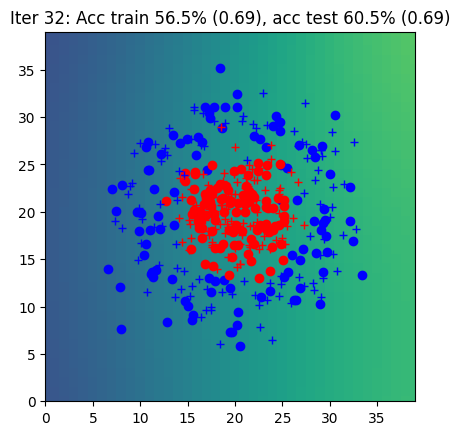

Iter 33: Acc train 62.0% (0.69), acc test 63.0% (0.69)


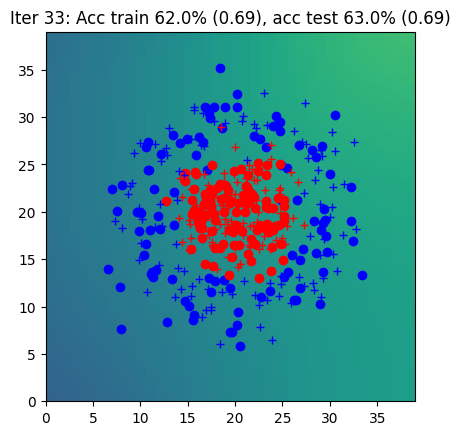

Iter 34: Acc train 64.0% (0.69), acc test 63.5% (0.69)


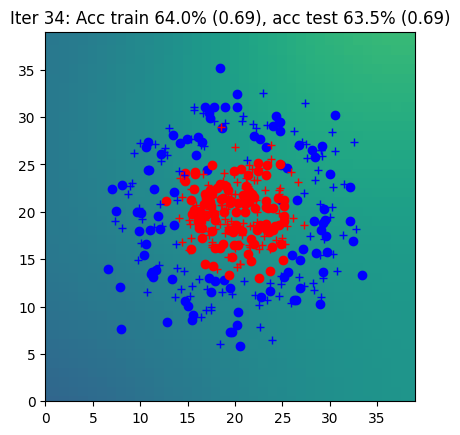

Iter 35: Acc train 60.0% (0.69), acc test 62.0% (0.69)


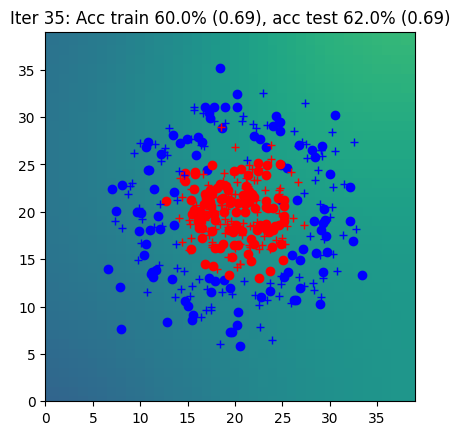

Iter 36: Acc train 60.5% (0.69), acc test 62.0% (0.69)


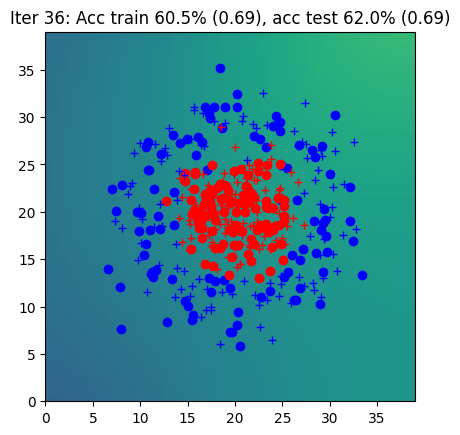

Iter 37: Acc train 62.5% (0.69), acc test 62.0% (0.69)


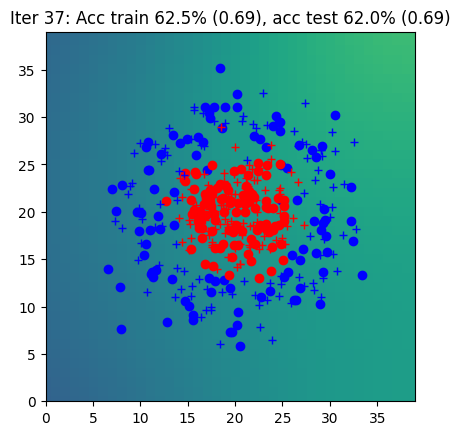

Iter 38: Acc train 58.0% (0.69), acc test 62.5% (0.69)


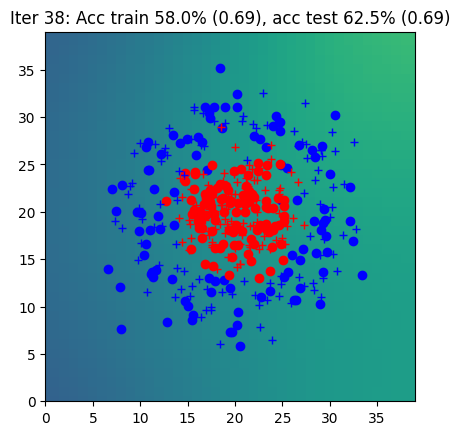

Iter 39: Acc train 57.5% (0.69), acc test 58.5% (0.69)


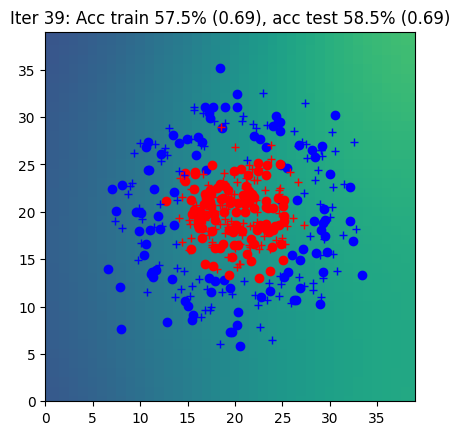

Iter 40: Acc train 62.5% (0.69), acc test 64.0% (0.69)


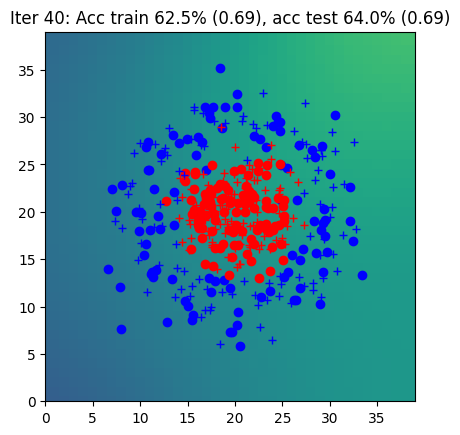

Iter 41: Acc train 61.5% (0.69), acc test 64.5% (0.69)


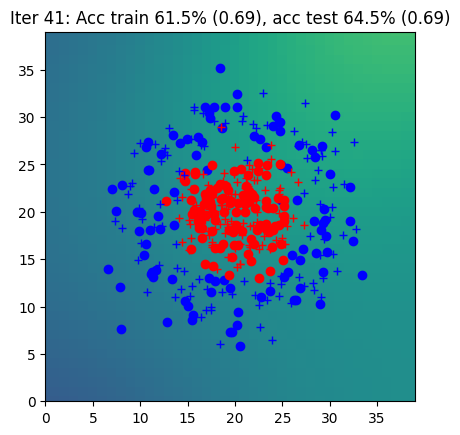

Iter 42: Acc train 60.5% (0.69), acc test 63.0% (0.69)


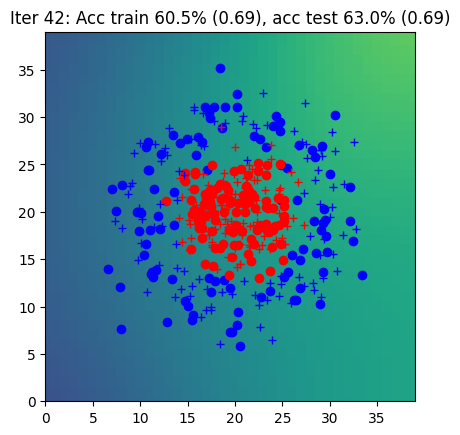

Iter 43: Acc train 61.0% (0.69), acc test 62.5% (0.69)


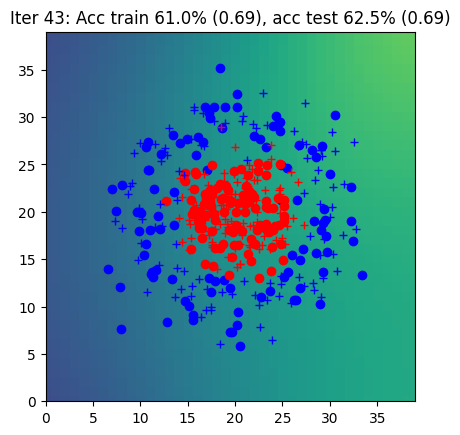

Iter 44: Acc train 59.5% (0.69), acc test 61.5% (0.69)


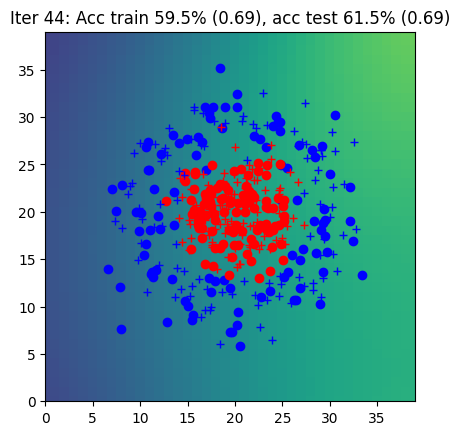

Iter 45: Acc train 60.0% (0.69), acc test 61.5% (0.69)


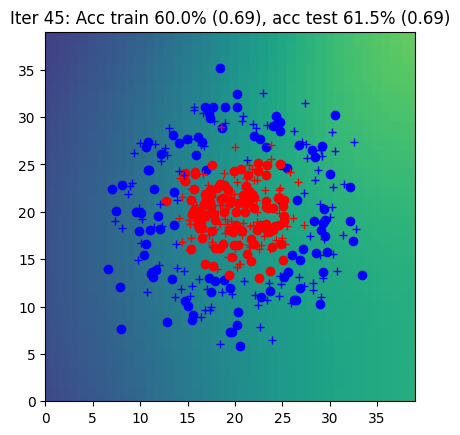

Iter 46: Acc train 63.0% (0.69), acc test 64.0% (0.69)


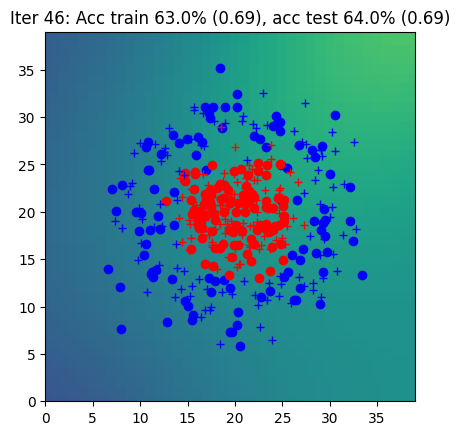

Iter 47: Acc train 64.5% (0.69), acc test 68.0% (0.69)


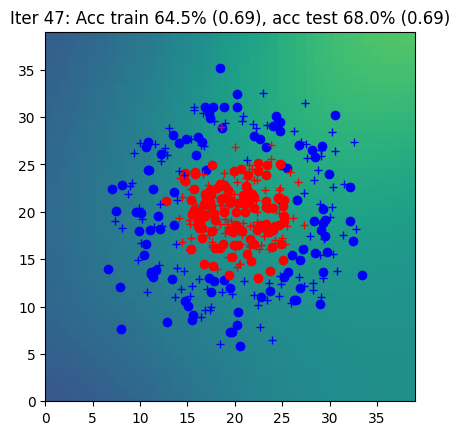

Iter 48: Acc train 68.0% (0.69), acc test 67.0% (0.68)


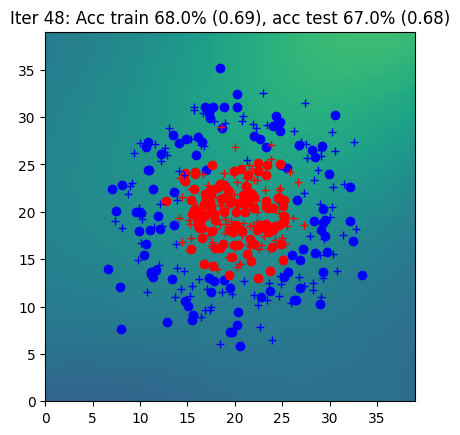

Iter 49: Acc train 68.5% (0.68), acc test 66.5% (0.68)


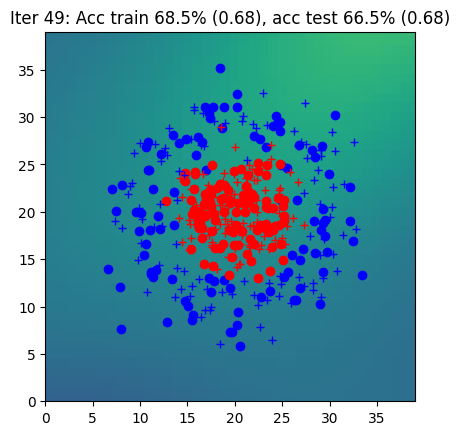

Iter 50: Acc train 66.0% (0.68), acc test 69.5% (0.68)


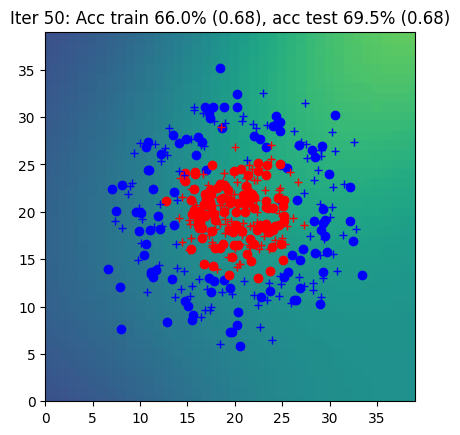

Iter 51: Acc train 72.5% (0.68), acc test 69.5% (0.68)


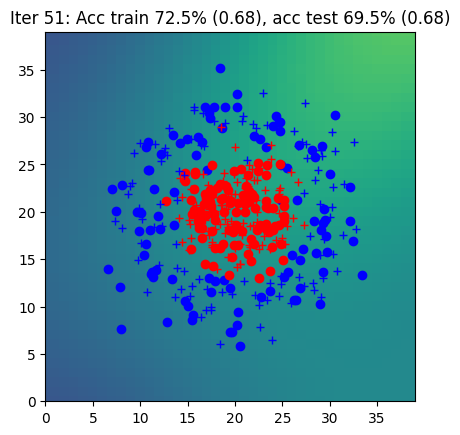

Iter 52: Acc train 68.5% (0.68), acc test 67.0% (0.68)


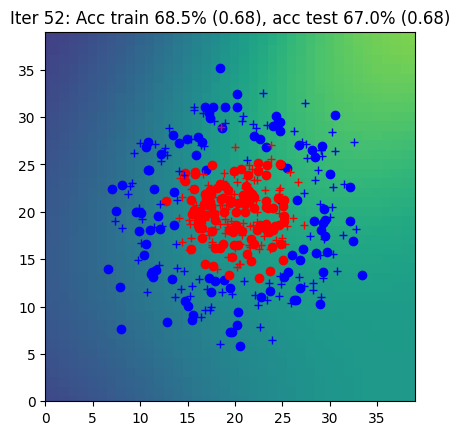

Iter 53: Acc train 69.5% (0.68), acc test 69.5% (0.68)


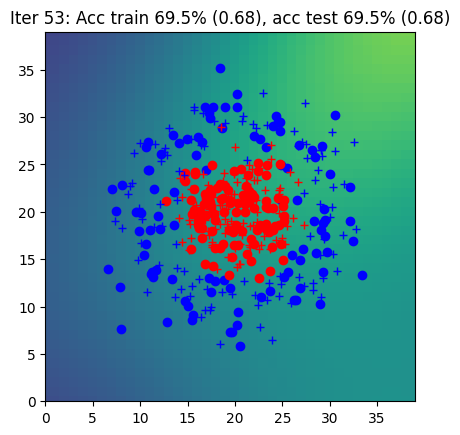

Iter 54: Acc train 66.0% (0.68), acc test 68.5% (0.68)


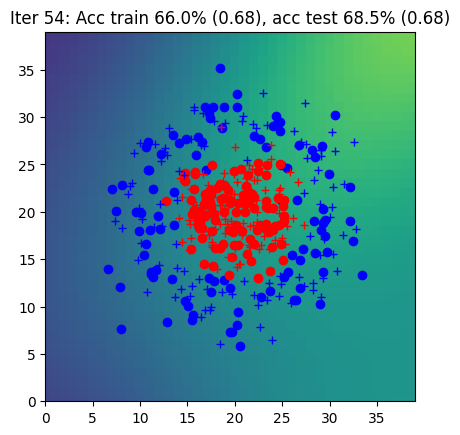

Iter 55: Acc train 67.5% (0.68), acc test 67.5% (0.68)


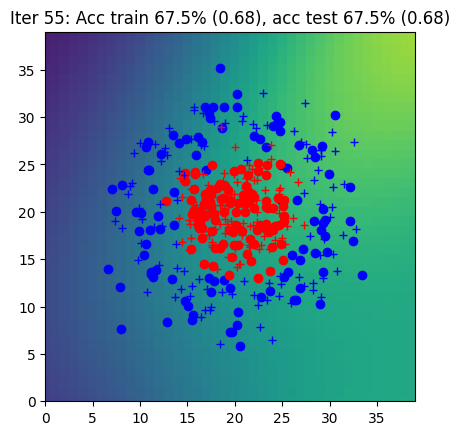

Iter 56: Acc train 68.0% (0.68), acc test 68.0% (0.68)


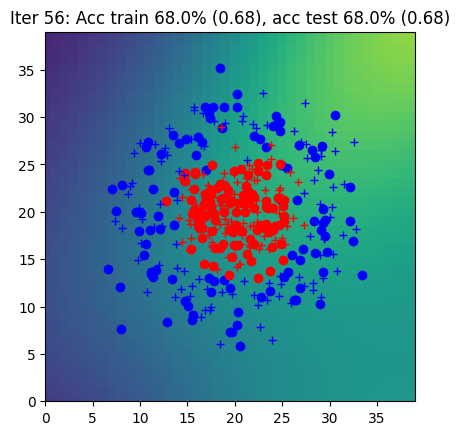

Iter 57: Acc train 74.0% (0.68), acc test 76.5% (0.68)


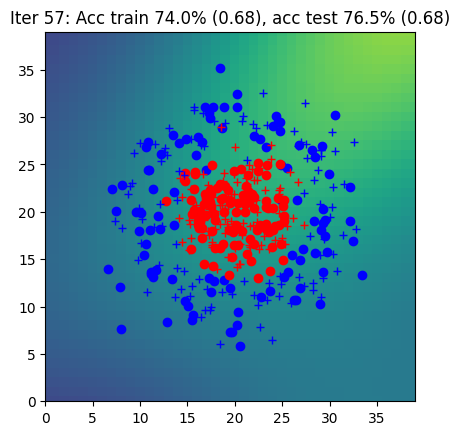

Iter 58: Acc train 68.5% (0.68), acc test 71.5% (0.68)


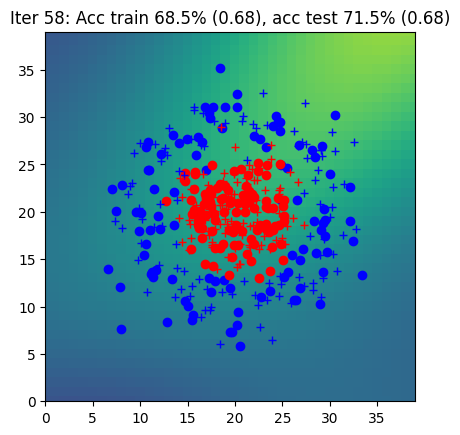

Iter 59: Acc train 67.0% (0.68), acc test 65.5% (0.67)


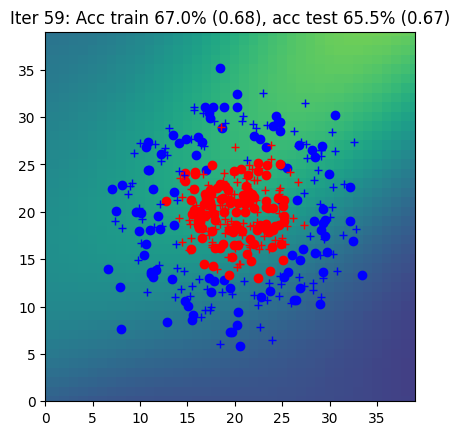

Iter 60: Acc train 77.0% (0.67), acc test 80.0% (0.67)


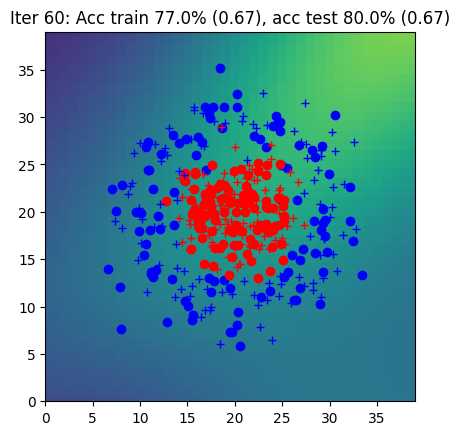

Iter 61: Acc train 73.5% (0.67), acc test 74.5% (0.67)


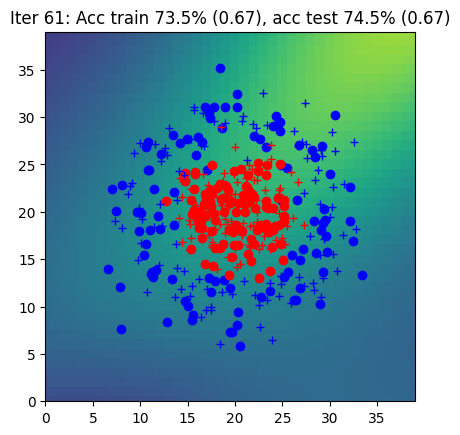

Iter 62: Acc train 72.0% (0.67), acc test 73.0% (0.67)


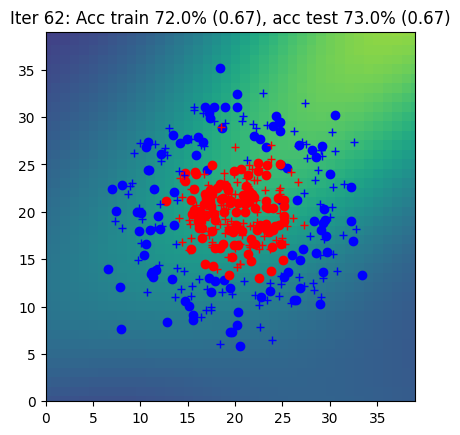

Iter 63: Acc train 70.0% (0.67), acc test 73.0% (0.67)


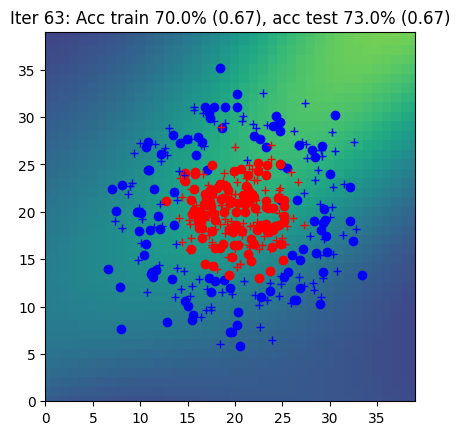

Iter 64: Acc train 68.0% (0.67), acc test 70.0% (0.66)


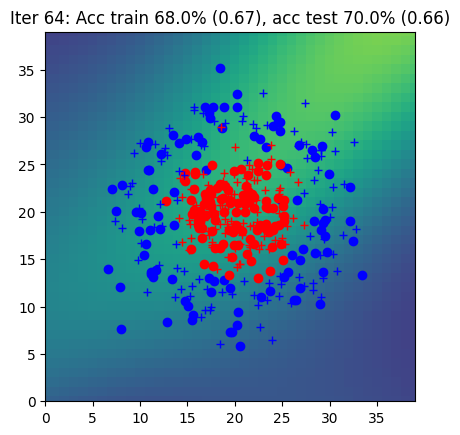

Iter 65: Acc train 68.0% (0.66), acc test 68.5% (0.66)


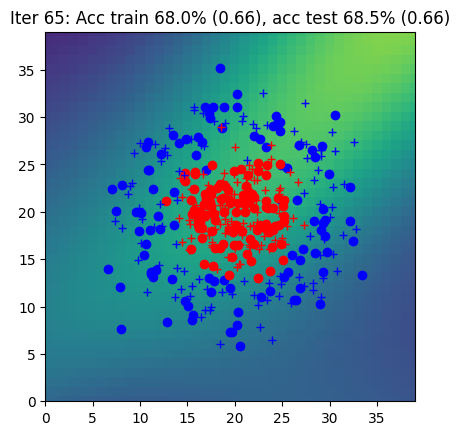

Iter 66: Acc train 71.0% (0.66), acc test 72.0% (0.66)


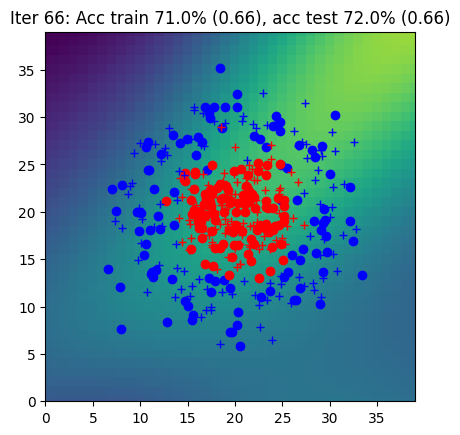

Iter 67: Acc train 71.5% (0.66), acc test 70.5% (0.66)


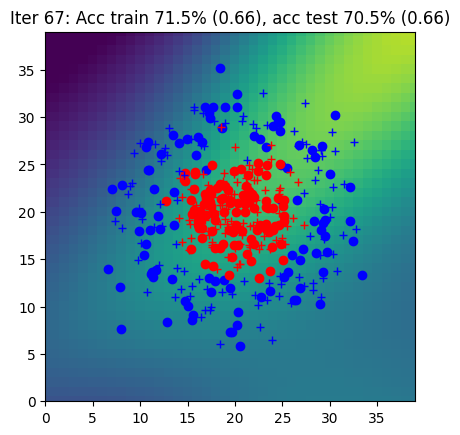

Iter 68: Acc train 75.5% (0.66), acc test 72.5% (0.66)


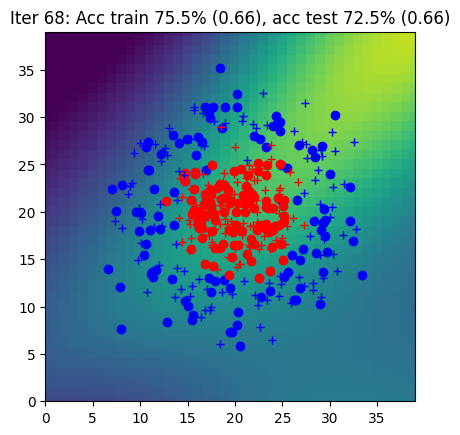

Iter 69: Acc train 74.0% (0.65), acc test 75.0% (0.65)


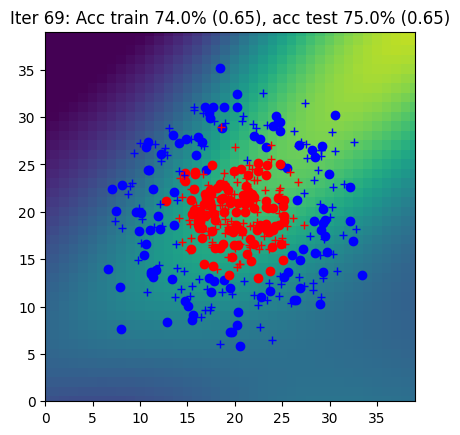

Iter 70: Acc train 75.0% (0.65), acc test 77.0% (0.65)


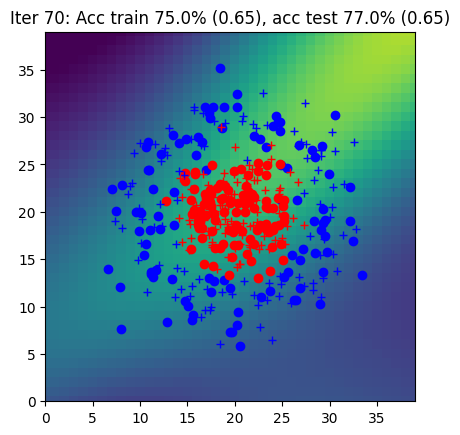

Iter 71: Acc train 73.5% (0.65), acc test 77.0% (0.64)


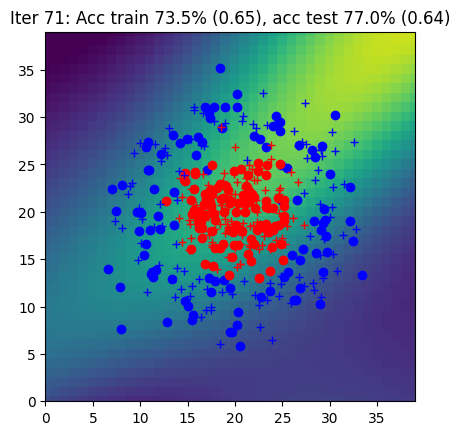

Iter 72: Acc train 82.5% (0.64), acc test 83.0% (0.64)


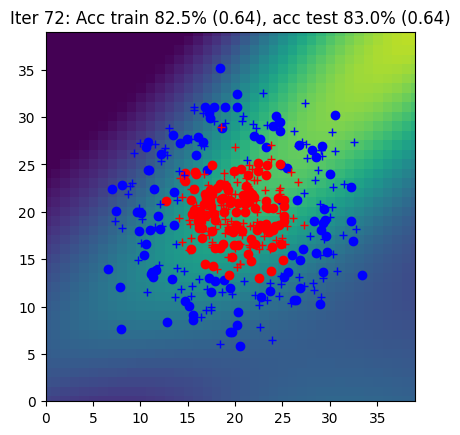

Iter 73: Acc train 78.5% (0.64), acc test 80.0% (0.64)


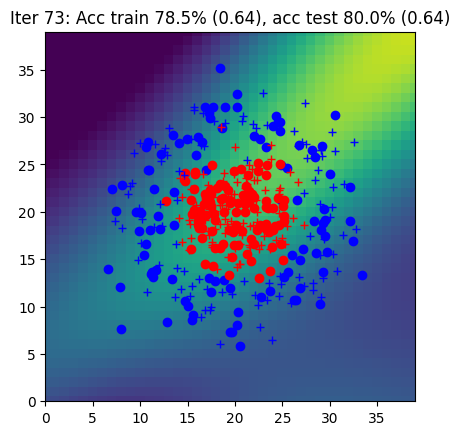

Iter 74: Acc train 79.0% (0.63), acc test 79.0% (0.63)


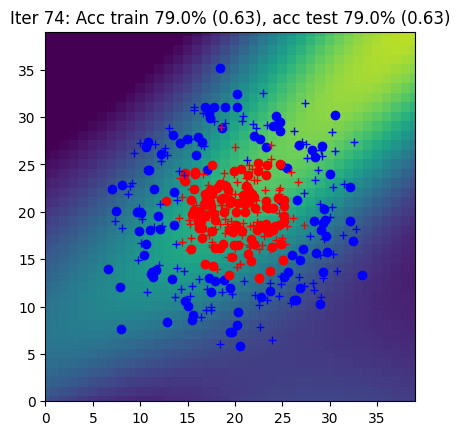

Iter 75: Acc train 80.5% (0.63), acc test 81.0% (0.63)


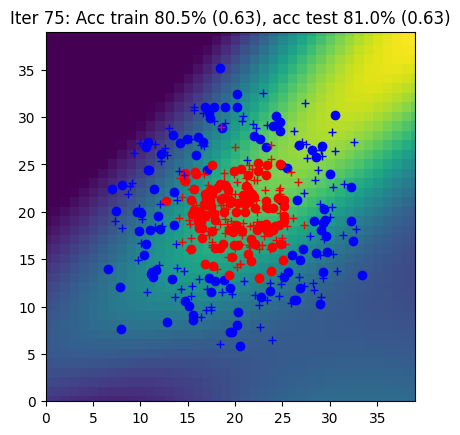

Iter 76: Acc train 79.0% (0.62), acc test 78.5% (0.62)


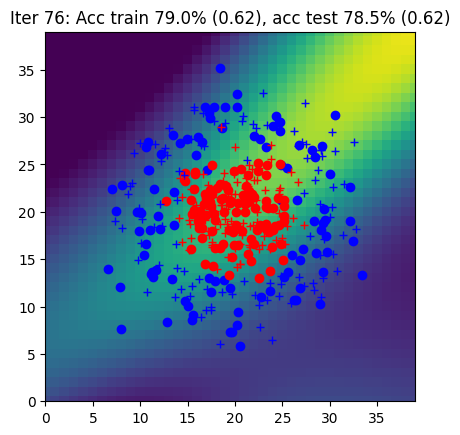

Iter 77: Acc train 78.0% (0.62), acc test 77.0% (0.61)


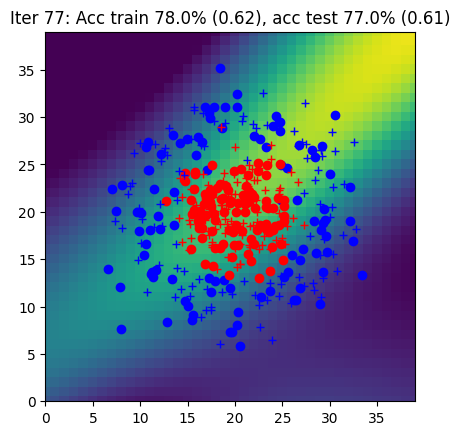

Iter 78: Acc train 79.5% (0.61), acc test 78.0% (0.61)


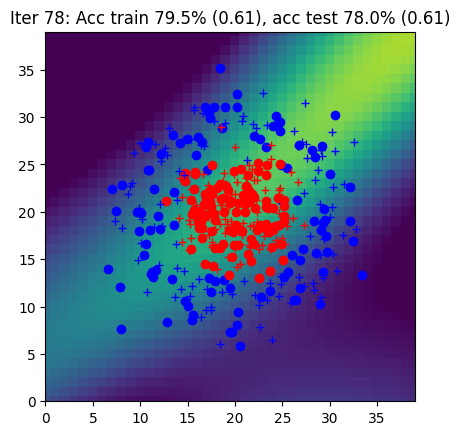

Iter 79: Acc train 80.0% (0.61), acc test 77.5% (0.60)


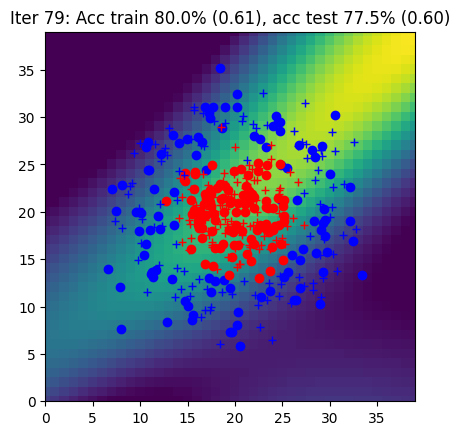

Iter 80: Acc train 79.5% (0.60), acc test 77.5% (0.60)


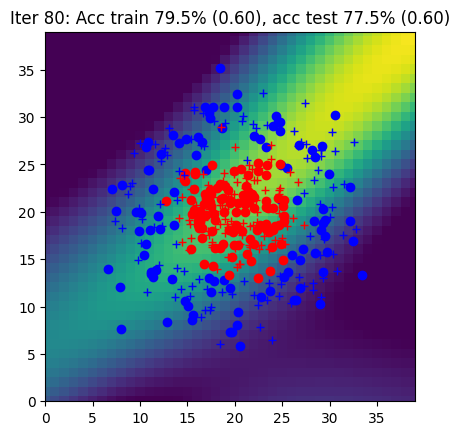

Iter 81: Acc train 78.0% (0.60), acc test 77.5% (0.59)


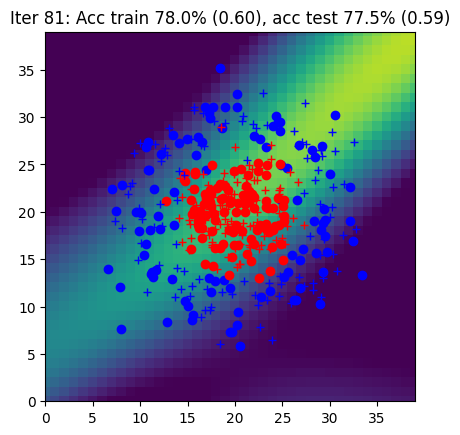

Iter 82: Acc train 78.0% (0.59), acc test 78.0% (0.59)


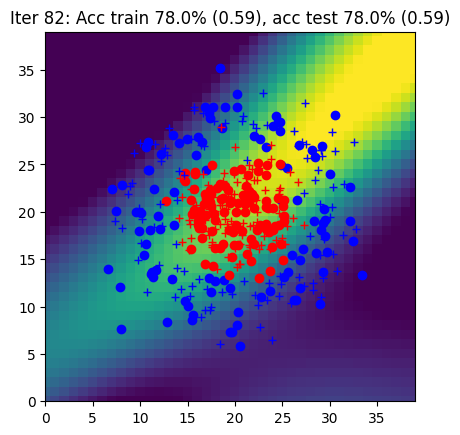

Iter 83: Acc train 78.0% (0.58), acc test 79.0% (0.58)


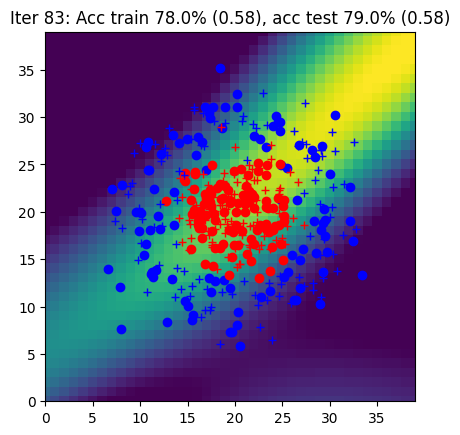

Iter 84: Acc train 79.5% (0.58), acc test 82.0% (0.57)


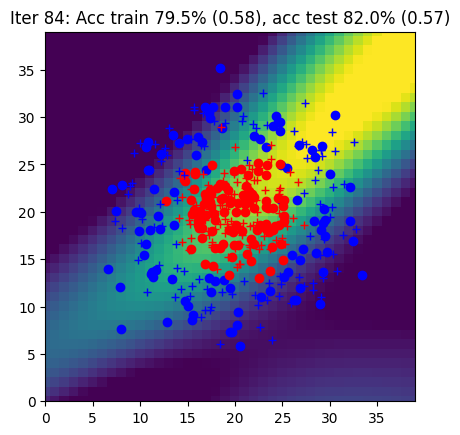

Iter 85: Acc train 76.0% (0.57), acc test 78.0% (0.57)


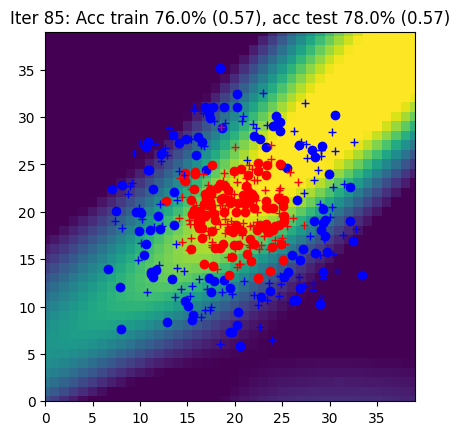

Iter 86: Acc train 76.0% (0.57), acc test 78.5% (0.57)


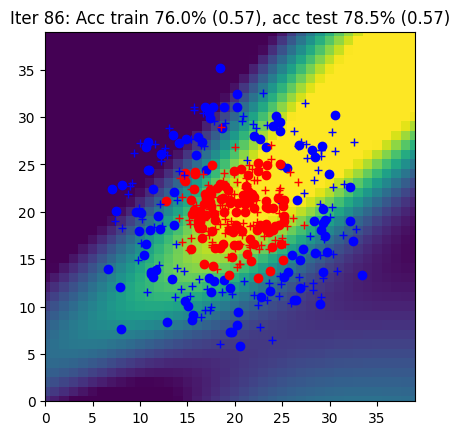

Iter 87: Acc train 78.0% (0.56), acc test 79.0% (0.55)


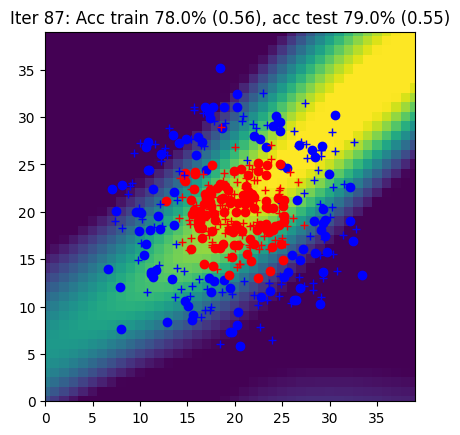

Iter 88: Acc train 76.5% (0.55), acc test 76.5% (0.55)


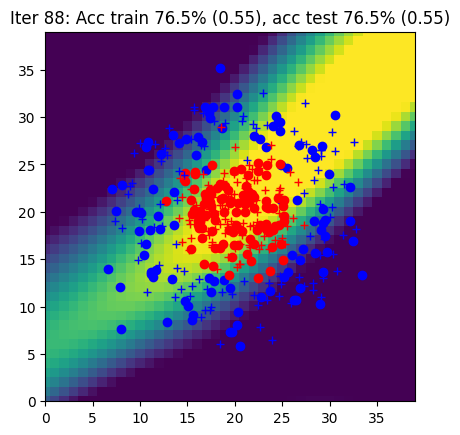

Iter 89: Acc train 77.0% (0.54), acc test 79.0% (0.54)


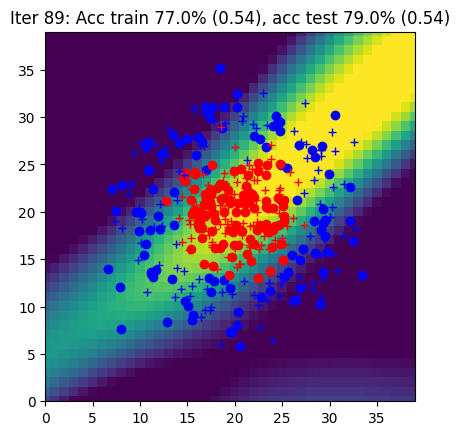

Iter 90: Acc train 77.0% (0.54), acc test 79.0% (0.54)


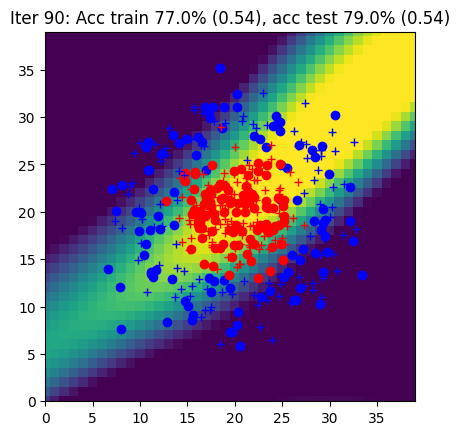

Iter 91: Acc train 76.0% (0.53), acc test 79.5% (0.53)


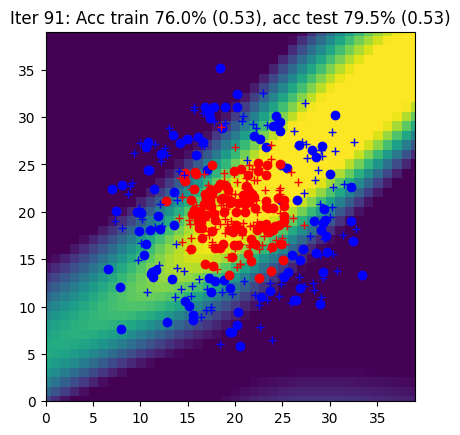

Iter 92: Acc train 79.0% (0.53), acc test 80.0% (0.53)


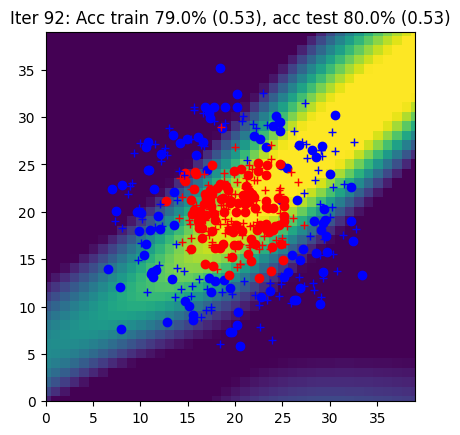

Iter 93: Acc train 77.0% (0.52), acc test 79.0% (0.52)


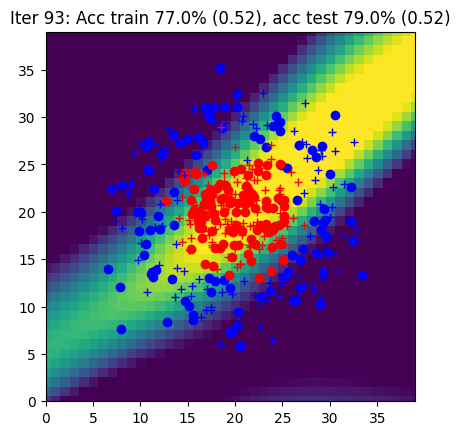

Iter 94: Acc train 76.5% (0.52), acc test 79.0% (0.51)


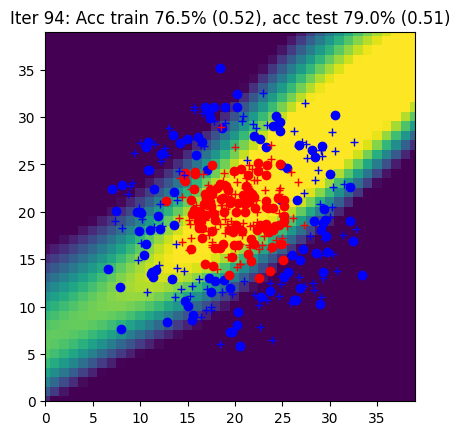

Iter 95: Acc train 77.5% (0.51), acc test 80.0% (0.50)


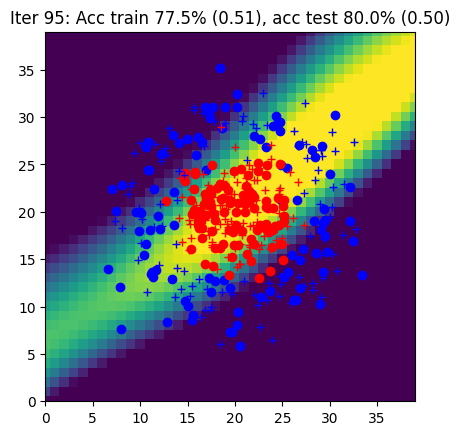

Iter 96: Acc train 78.0% (0.50), acc test 79.0% (0.50)


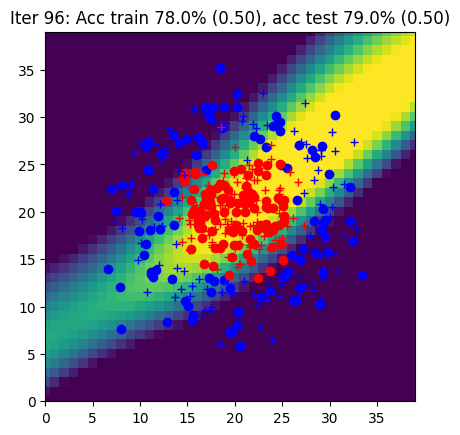

Iter 97: Acc train 82.0% (0.51), acc test 77.5% (0.50)


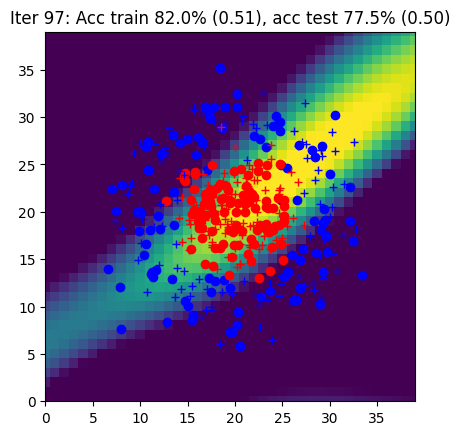

Iter 98: Acc train 79.5% (0.49), acc test 78.5% (0.49)


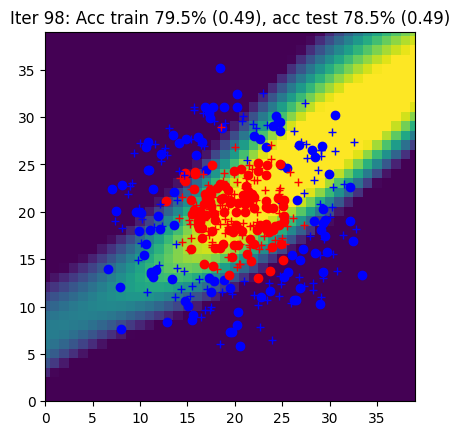

Iter 99: Acc train 78.0% (0.49), acc test 78.0% (0.48)


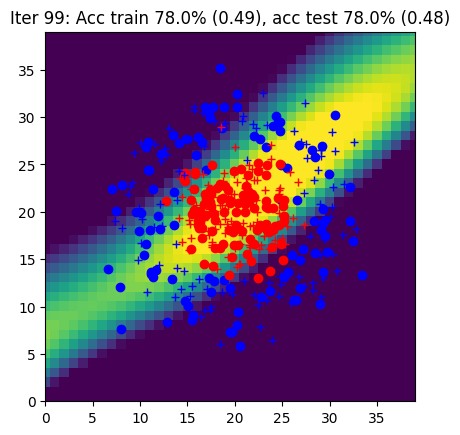

Iter 100: Acc train 77.5% (0.48), acc test 78.5% (0.48)


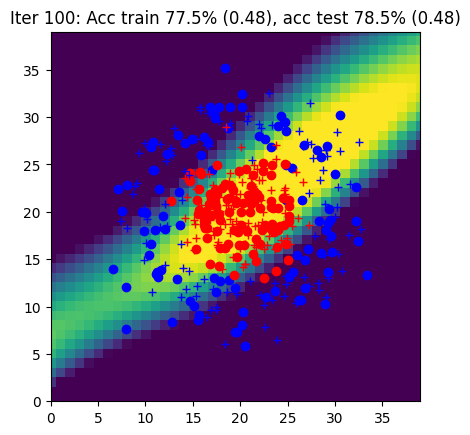

Iter 101: Acc train 78.0% (0.47), acc test 79.5% (0.47)


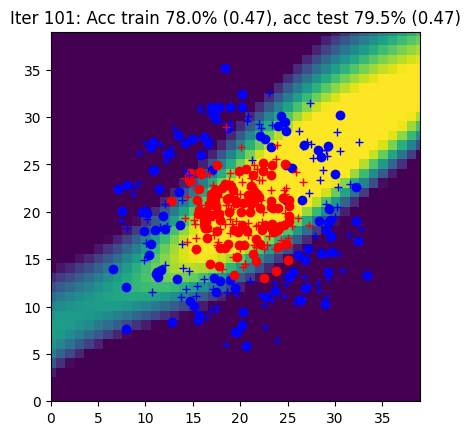

Iter 102: Acc train 77.5% (0.47), acc test 80.0% (0.47)


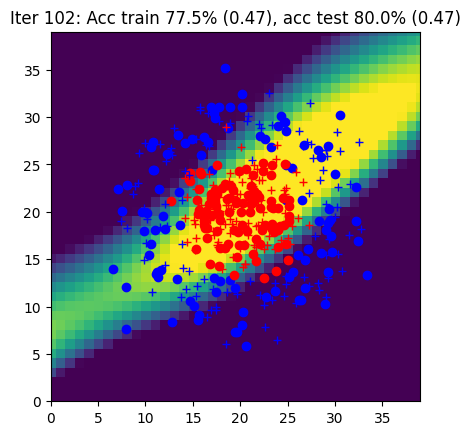

Iter 103: Acc train 78.0% (0.46), acc test 79.0% (0.46)


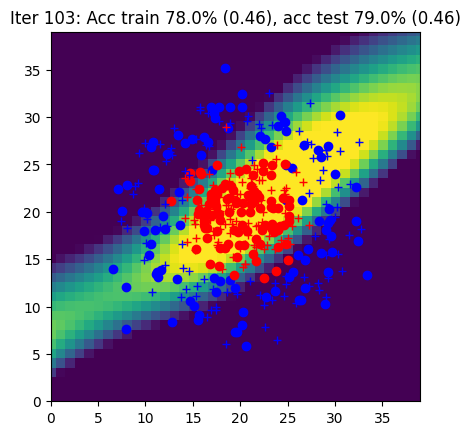

Iter 104: Acc train 78.5% (0.46), acc test 80.0% (0.45)


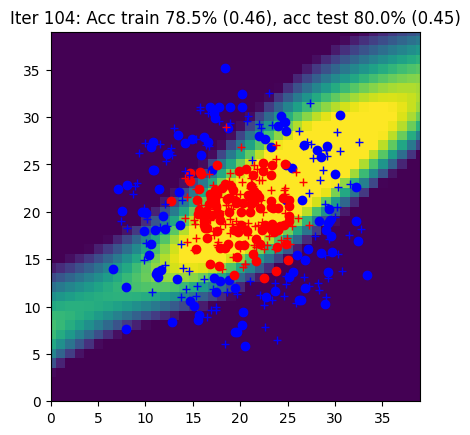

Iter 105: Acc train 79.5% (0.45), acc test 81.0% (0.45)


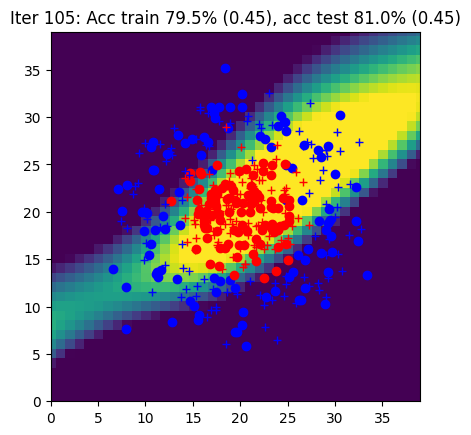

Iter 106: Acc train 79.0% (0.45), acc test 80.5% (0.44)


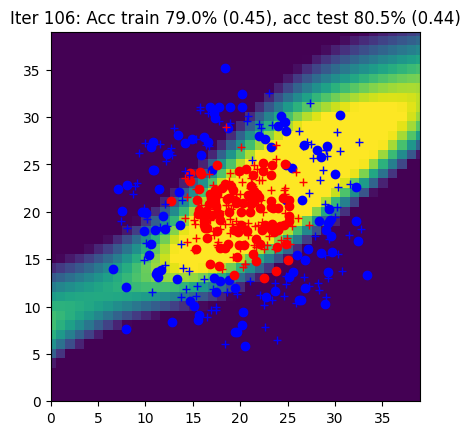

Iter 107: Acc train 79.0% (0.44), acc test 81.5% (0.43)


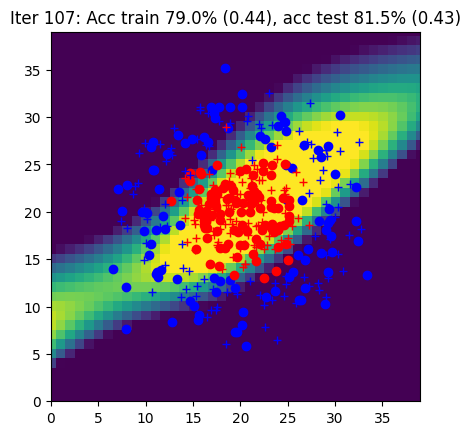

Iter 108: Acc train 78.5% (0.43), acc test 81.0% (0.43)


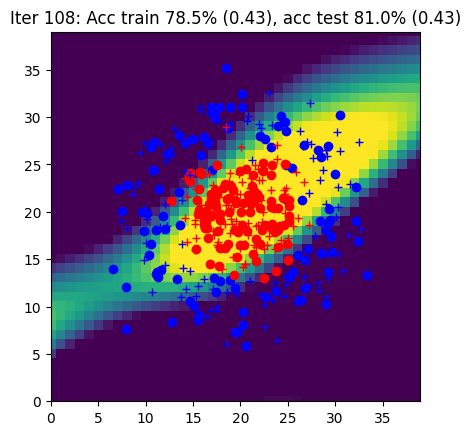

Iter 109: Acc train 81.0% (0.42), acc test 81.0% (0.42)


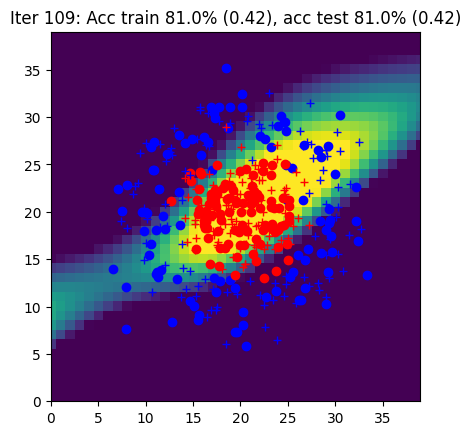

Iter 110: Acc train 87.5% (0.43), acc test 81.5% (0.42)


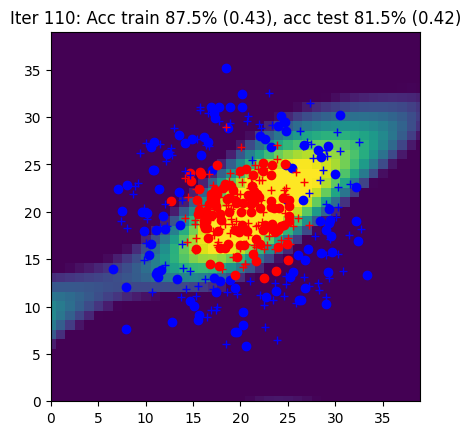

Iter 111: Acc train 83.0% (0.40), acc test 83.0% (0.39)


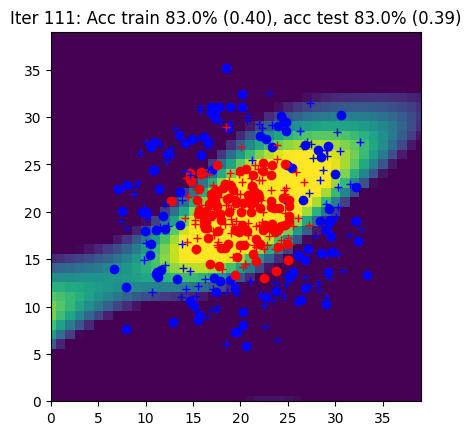

Iter 112: Acc train 82.5% (0.39), acc test 83.5% (0.38)


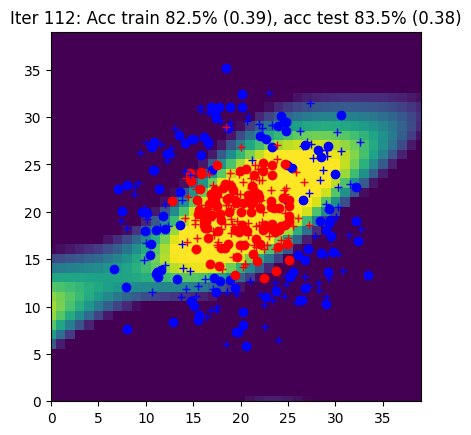

Iter 113: Acc train 84.5% (0.38), acc test 84.0% (0.37)


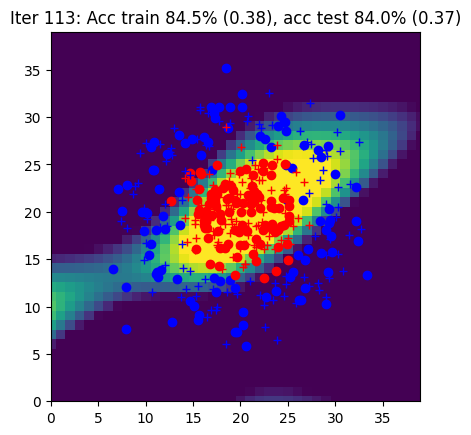

Iter 114: Acc train 88.0% (0.37), acc test 86.0% (0.36)


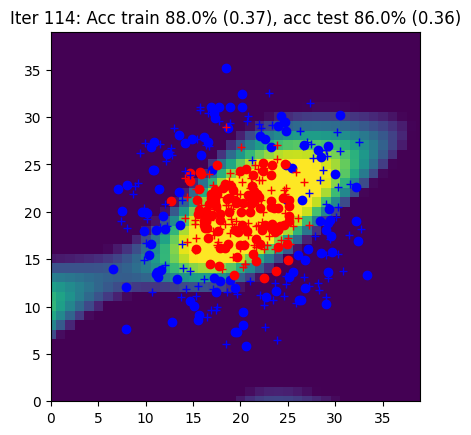

Iter 115: Acc train 81.5% (0.37), acc test 85.0% (0.36)


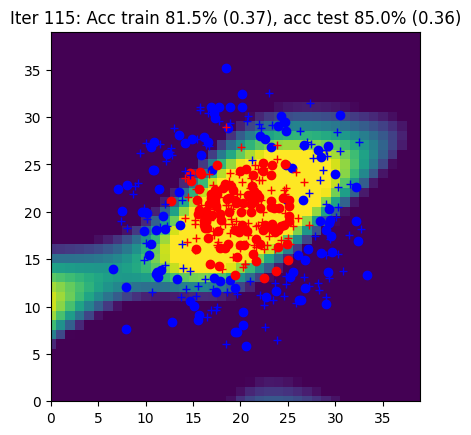

Iter 116: Acc train 83.0% (0.36), acc test 86.0% (0.34)


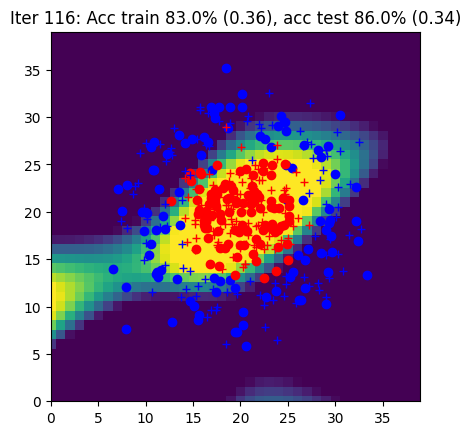

Iter 117: Acc train 83.5% (0.35), acc test 88.0% (0.34)


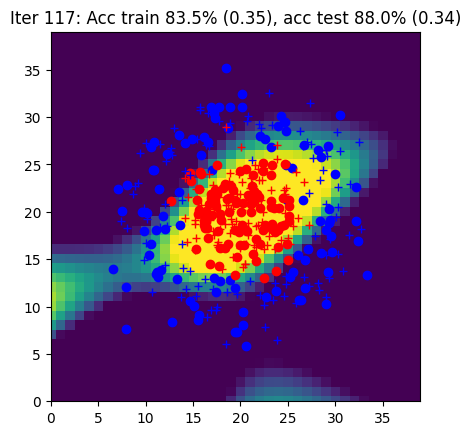

Iter 118: Acc train 86.5% (0.33), acc test 88.5% (0.32)


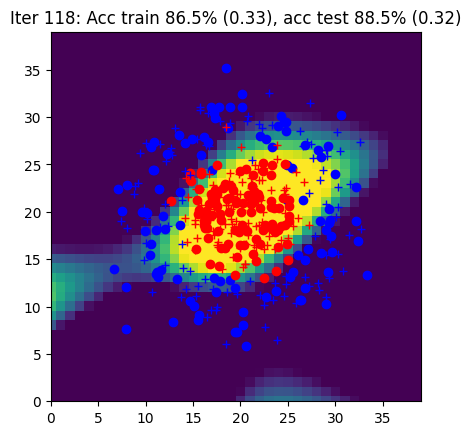

Iter 119: Acc train 89.5% (0.32), acc test 89.5% (0.31)


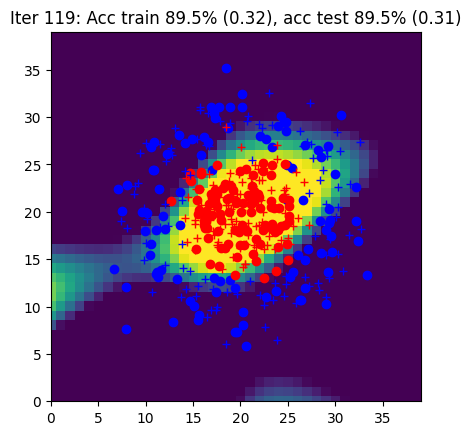

Iter 120: Acc train 91.0% (0.32), acc test 91.5% (0.30)


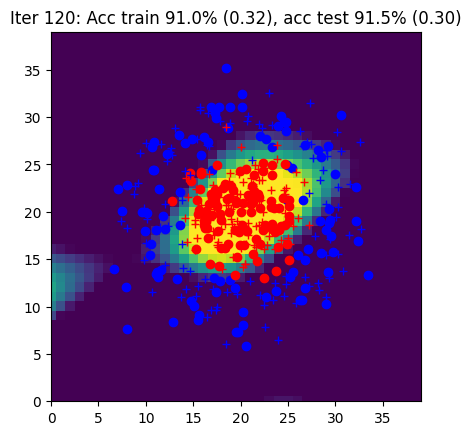

Iter 121: Acc train 91.0% (0.30), acc test 92.0% (0.28)


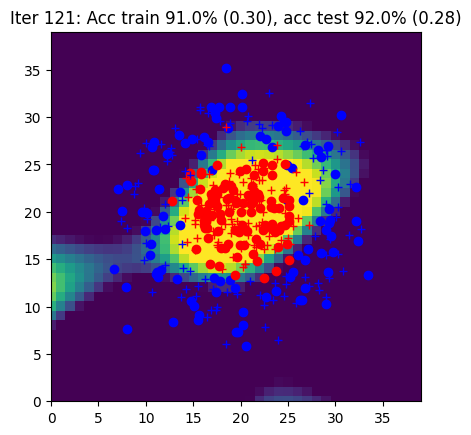

Iter 122: Acc train 91.0% (0.29), acc test 92.5% (0.27)


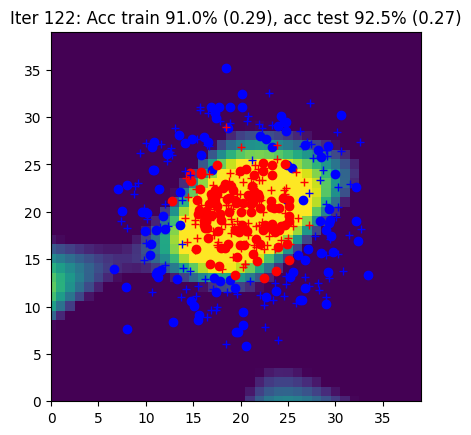

Iter 123: Acc train 92.5% (0.28), acc test 93.5% (0.27)


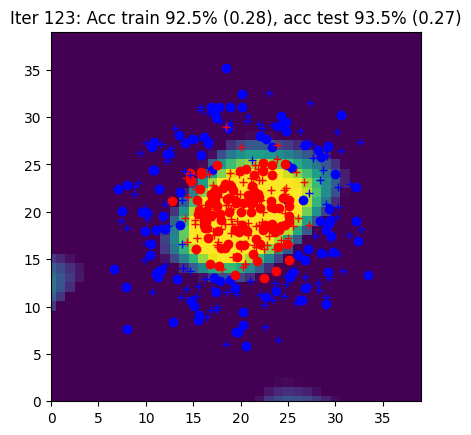

Iter 124: Acc train 93.5% (0.27), acc test 95.0% (0.25)


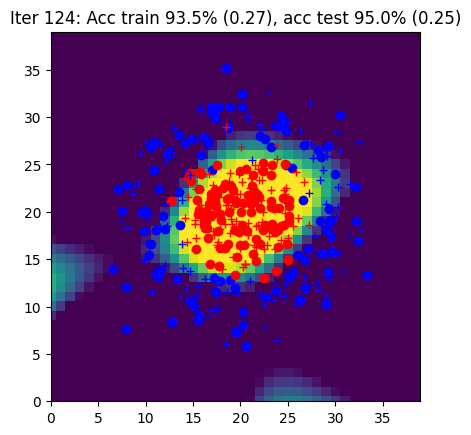

Iter 125: Acc train 93.0% (0.26), acc test 95.0% (0.25)


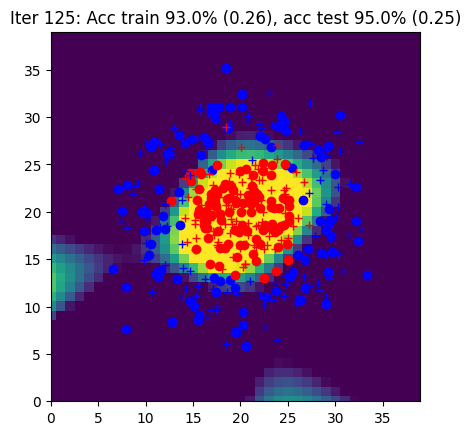

Iter 126: Acc train 94.5% (0.25), acc test 95.5% (0.24)


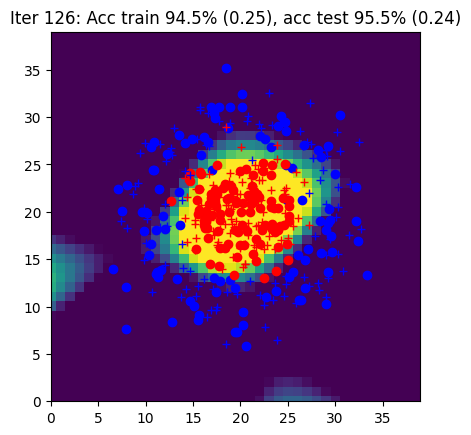

Iter 127: Acc train 94.0% (0.24), acc test 95.5% (0.23)


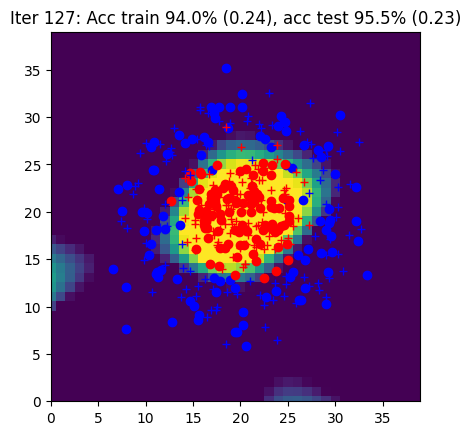

Iter 128: Acc train 94.5% (0.23), acc test 95.5% (0.22)


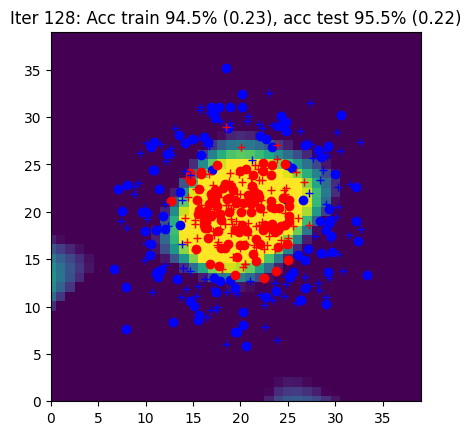

Iter 129: Acc train 94.0% (0.23), acc test 95.5% (0.22)


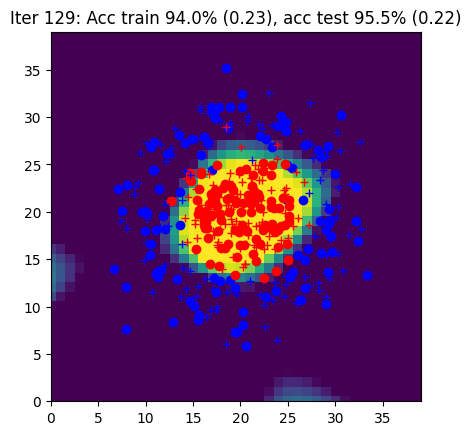

Iter 130: Acc train 94.0% (0.22), acc test 95.0% (0.21)


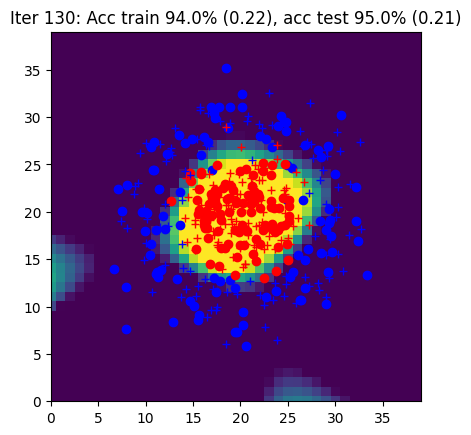

Iter 131: Acc train 94.5% (0.21), acc test 95.0% (0.21)


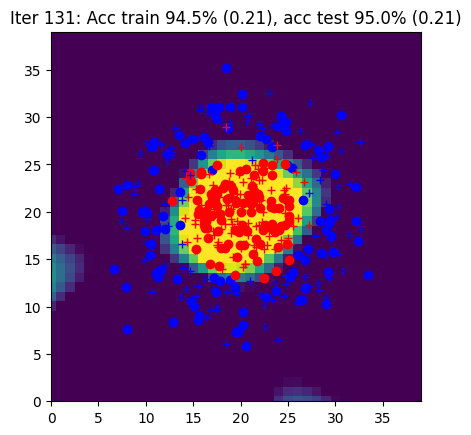

Iter 132: Acc train 94.0% (0.21), acc test 93.5% (0.21)


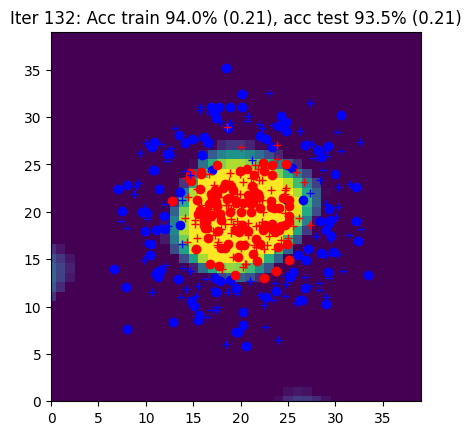

Iter 133: Acc train 94.5% (0.21), acc test 94.0% (0.20)


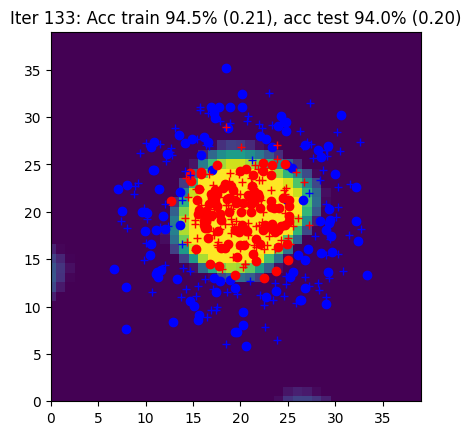

Iter 134: Acc train 94.5% (0.20), acc test 96.0% (0.19)


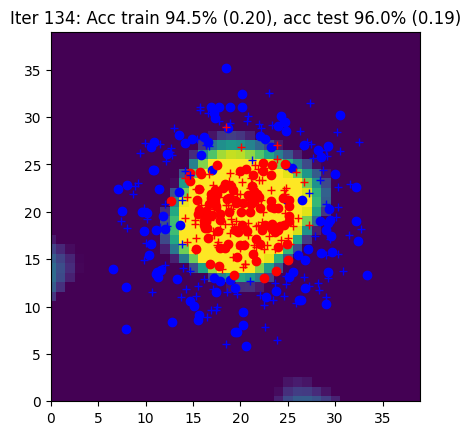

Iter 135: Acc train 94.5% (0.20), acc test 95.5% (0.20)


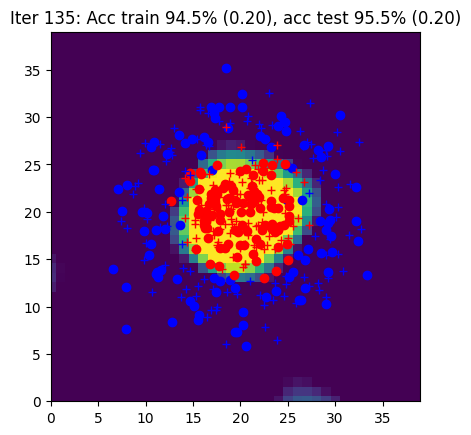

Iter 136: Acc train 94.5% (0.20), acc test 94.5% (0.19)


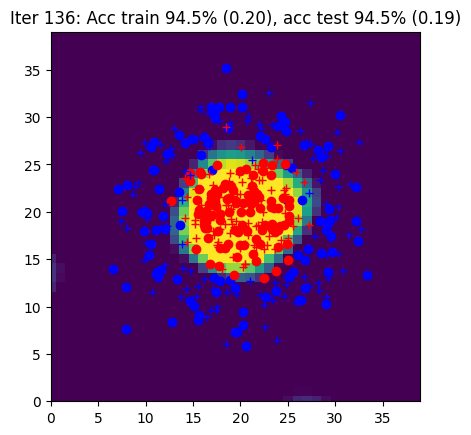

Iter 137: Acc train 95.0% (0.19), acc test 94.5% (0.18)


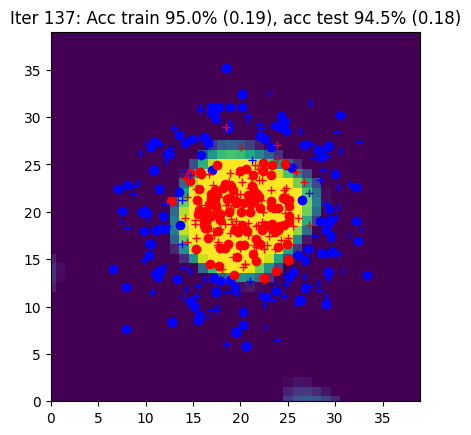

Iter 138: Acc train 94.5% (0.19), acc test 95.0% (0.19)


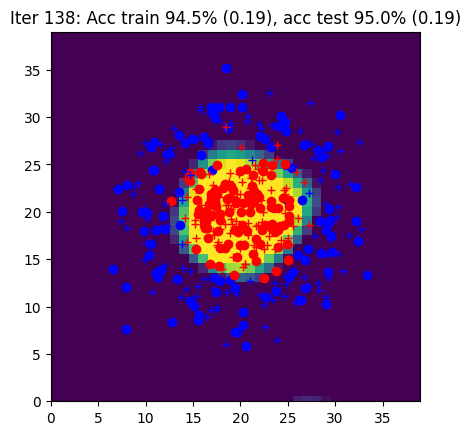

Iter 139: Acc train 95.0% (0.18), acc test 94.0% (0.18)


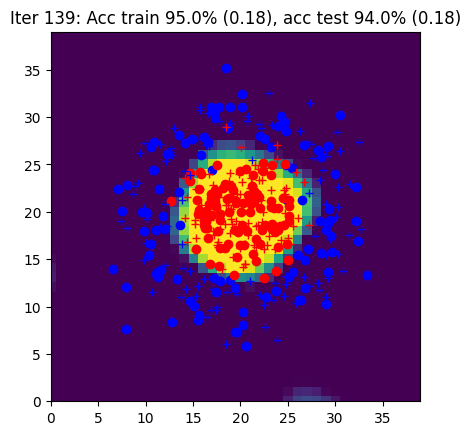

Iter 140: Acc train 95.0% (0.18), acc test 94.0% (0.18)


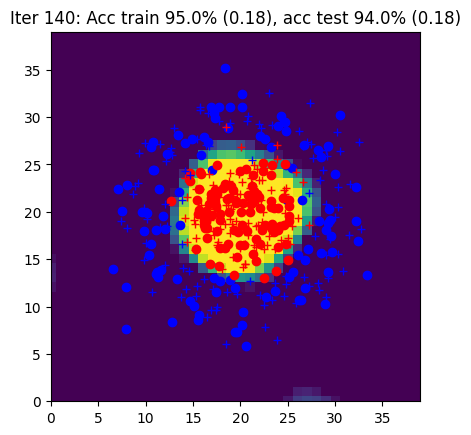

Iter 141: Acc train 95.0% (0.17), acc test 93.5% (0.17)


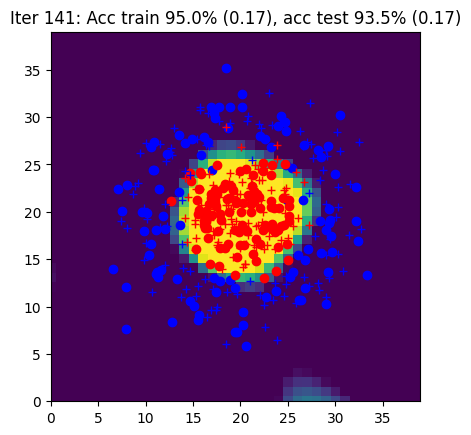

Iter 142: Acc train 95.0% (0.17), acc test 94.0% (0.17)


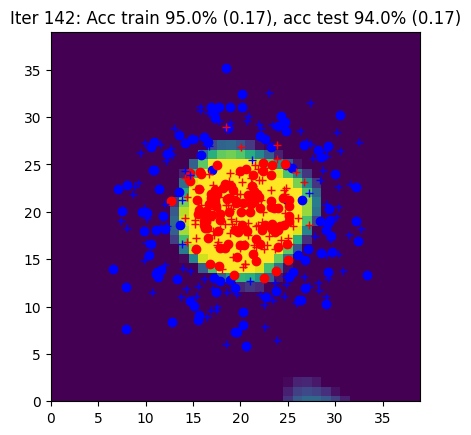

Iter 143: Acc train 95.5% (0.17), acc test 93.5% (0.17)


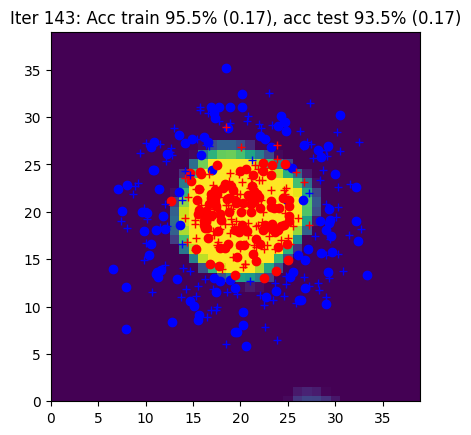

Iter 144: Acc train 95.0% (0.17), acc test 94.5% (0.17)


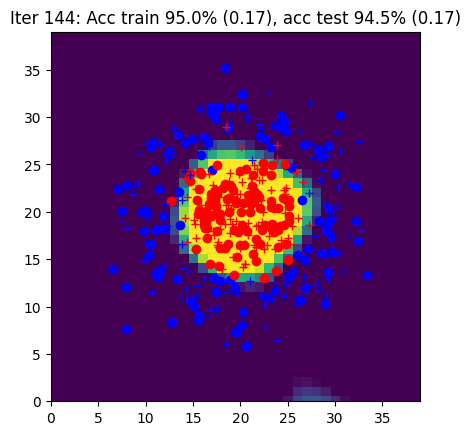

Iter 145: Acc train 94.5% (0.17), acc test 94.5% (0.16)


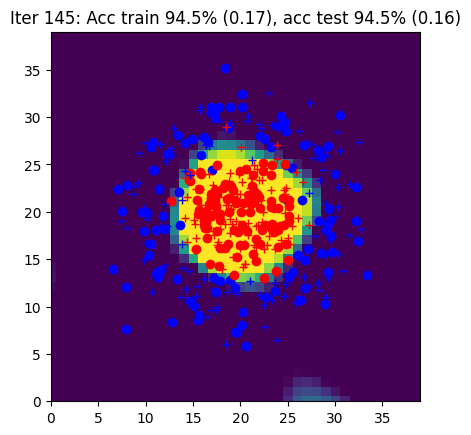

Iter 146: Acc train 95.5% (0.16), acc test 93.5% (0.17)


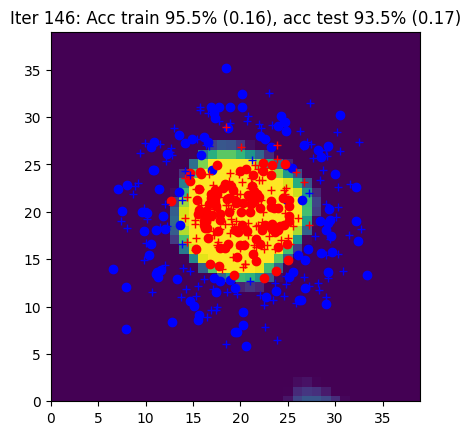

Iter 147: Acc train 95.0% (0.17), acc test 94.5% (0.16)


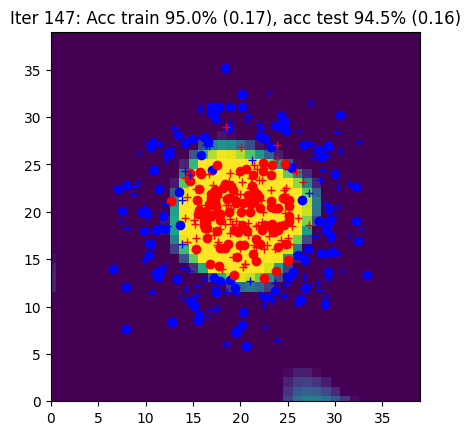

Iter 148: Acc train 95.5% (0.16), acc test 94.5% (0.16)


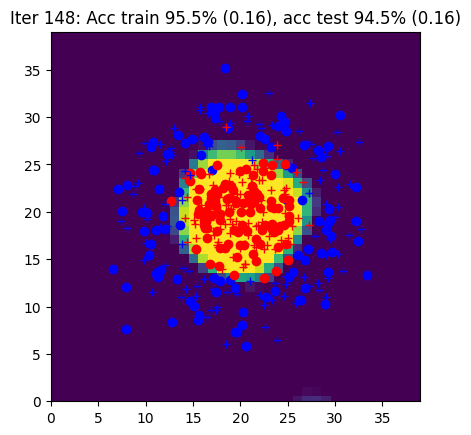

Iter 149: Acc train 94.5% (0.16), acc test 93.5% (0.16)


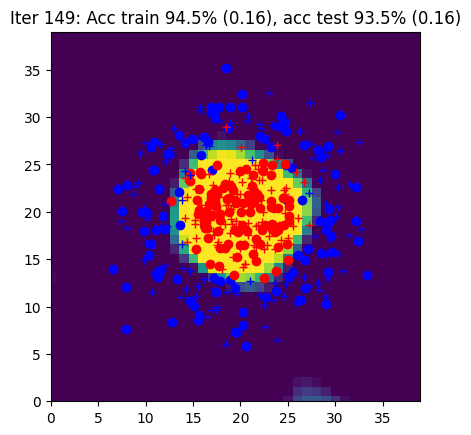

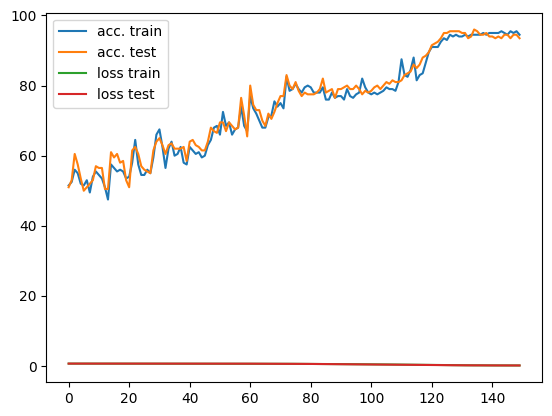

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        Y_hat, outputs = forward(params, X)
        loss, accuracy = loss_accuracy(Y_hat, Y)
        grads = backward(params, outputs, Y)
        params = sgd(params, grads, eta)


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)

fig = plt.figure()
plt.plot(curves[0], label="acc. train")
plt.plot(curves[1], label="acc. test")
plt.plot(curves[2], label="loss train")
plt.plot(curves[3], label="loss test")
plt.legend()
plt.show()

# Part 2 : Simplify backward with `torch.autograd`

`torch.autograd` saves us a lot of hassle by computing gradients for us!

For that however, we need to tell pytorch the parameter tensors are part of a tracked computational graph by specifying they require gradients.


In [ ]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    params["Wh"] = torch.randn(nh, nx) * 0.3
    params["Wh"].requires_grad = True
    params["Wy"] = torch.randn(ny, nh) * 0.3
    params["Wy"].requires_grad = True

    params["bh"] = torch.zeros(nh,1, requires_grad=True)
    params["by"] = torch.zeros(ny,1, requires_grad=True)

    return params

`forward` and `loss_accuracy` are the same as before.

`backward` is not necessary anymore thanks to pytorch.

In [ ]:
def sgd(params, eta):

    #####################
    ## Your code here  ##
    #####################

    # Update parameters with a SGD step
    # Take care to take this off the computation graph with torch.no_grad()
    # And remember to reset the gradients after use with .grad.zero_()

    with torch.no_grad():
        for param in params.values():
            # Check if the parameter has a gradient
            if param.grad is not None:
                # Subtract the gradient scaled by the learning rate from the parameter
                param -= eta * param.grad
                # After the update, gradients need to be zeroed out
                param.grad.zero_()
    return params

And we put it all together in a training loop again.

**Question: What is the difference this time?**

both methods should yield the same result. The gradients computed manually should be equivalent to those computed by torch.autograd for the same network and data. The plot curves are also similar accordingly

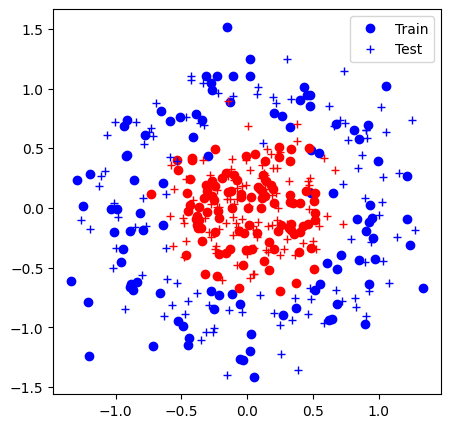

<ipython-input-11-98f3762e4c15>:34: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  X_tensor = torch.tensor(X, dtype=torch.float32)
<ipython-input-11-98f3762e4c15>:35: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  Y_tensor = torch.tensor(Y, dtype=torch.float32)


Iter 0: Acc train 56.0% (0.69), acc test 61.5% (0.69)


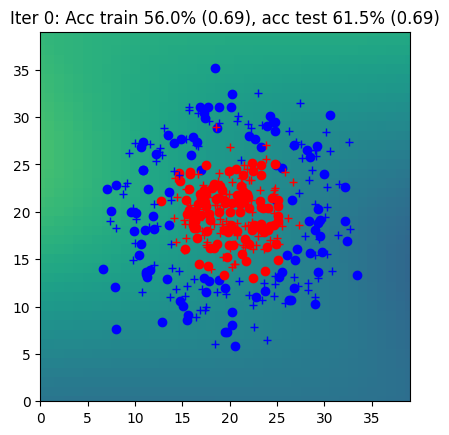

Iter 1: Acc train 62.0% (0.69), acc test 65.0% (0.69)


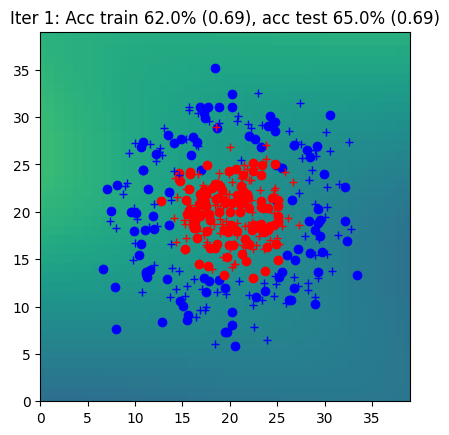

Iter 2: Acc train 66.0% (0.69), acc test 64.5% (0.69)


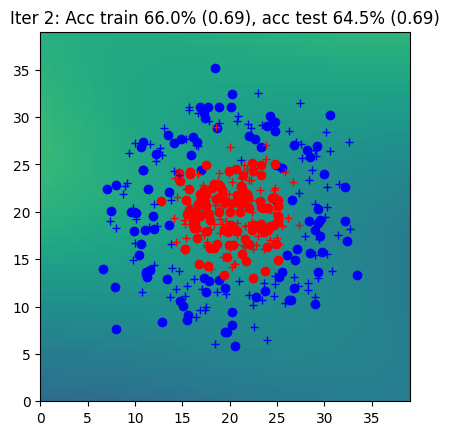

Iter 3: Acc train 68.5% (0.69), acc test 69.5% (0.69)


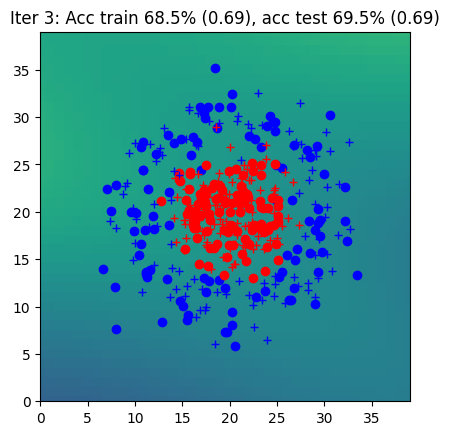

Iter 4: Acc train 65.0% (0.69), acc test 66.5% (0.69)


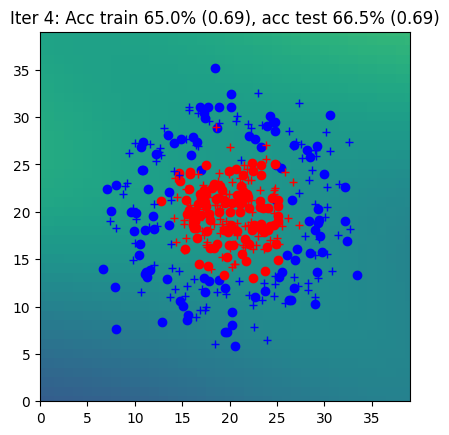

Iter 5: Acc train 58.0% (0.69), acc test 58.5% (0.69)


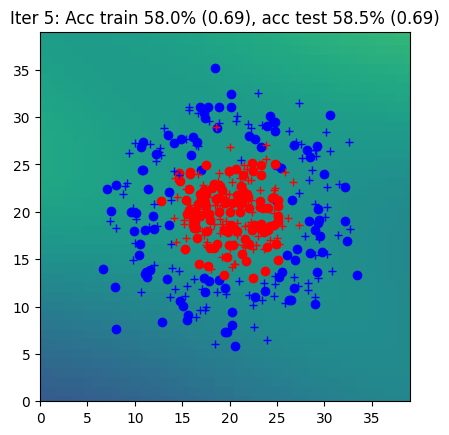

Iter 6: Acc train 64.5% (0.69), acc test 63.0% (0.69)


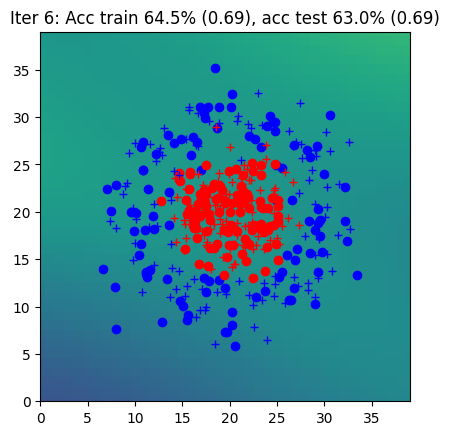

Iter 7: Acc train 59.5% (0.69), acc test 57.0% (0.69)


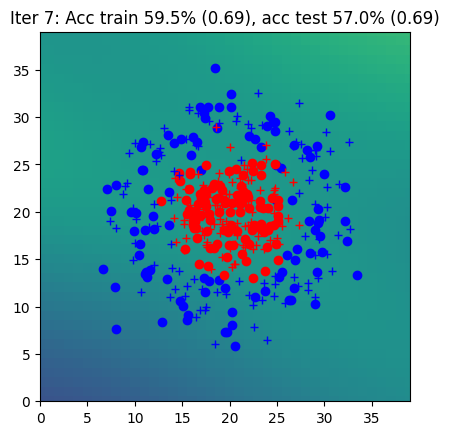

Iter 8: Acc train 56.0% (0.69), acc test 54.5% (0.69)


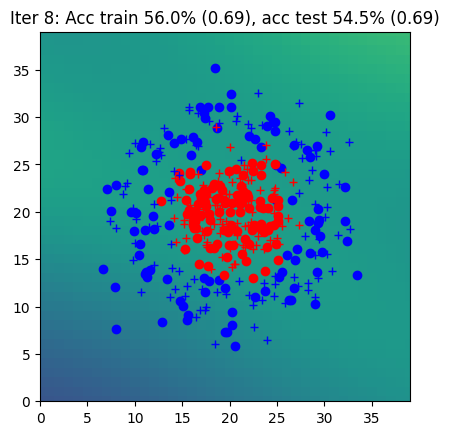

Iter 9: Acc train 58.5% (0.69), acc test 55.5% (0.69)


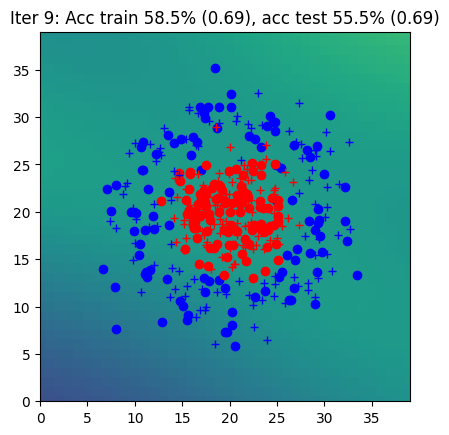

Iter 10: Acc train 60.0% (0.68), acc test 58.5% (0.69)


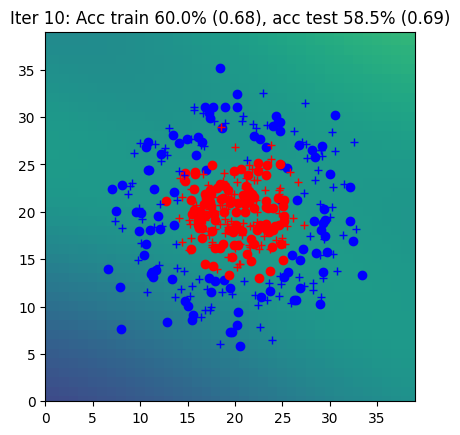

Iter 11: Acc train 60.0% (0.68), acc test 60.5% (0.69)


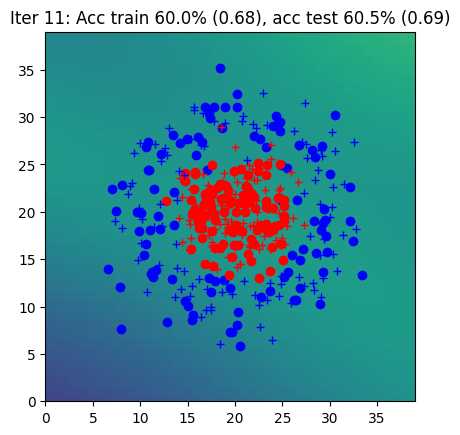

Iter 12: Acc train 60.0% (0.68), acc test 60.0% (0.69)


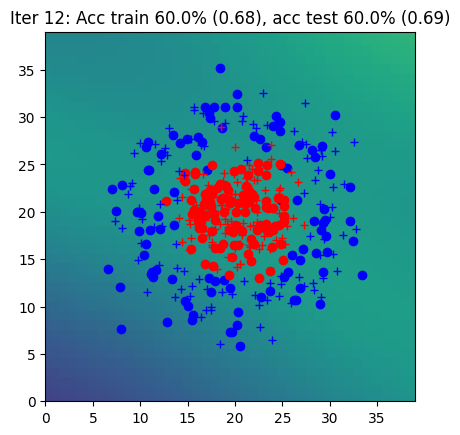

Iter 13: Acc train 60.0% (0.68), acc test 59.5% (0.68)


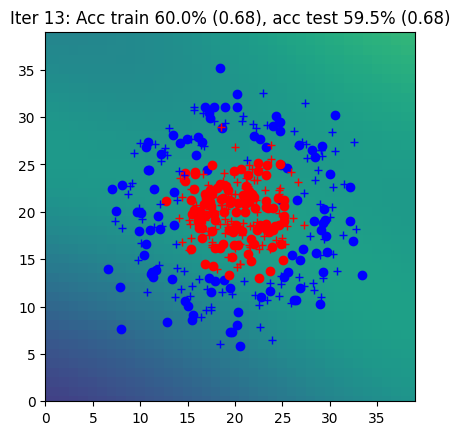

Iter 14: Acc train 60.0% (0.68), acc test 58.0% (0.68)


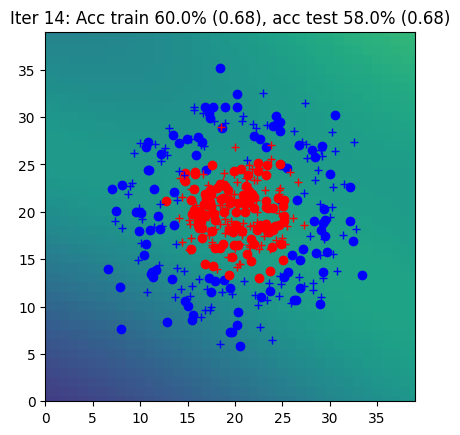

Iter 15: Acc train 63.5% (0.68), acc test 63.0% (0.68)


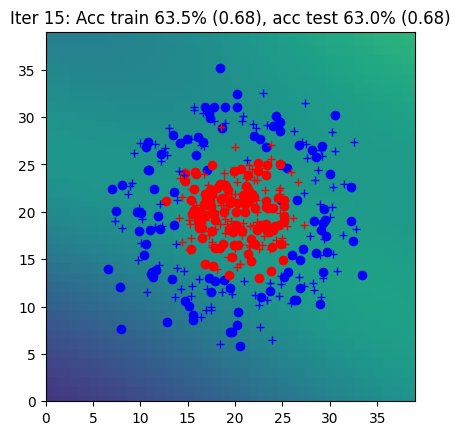

Iter 16: Acc train 63.0% (0.68), acc test 61.5% (0.68)


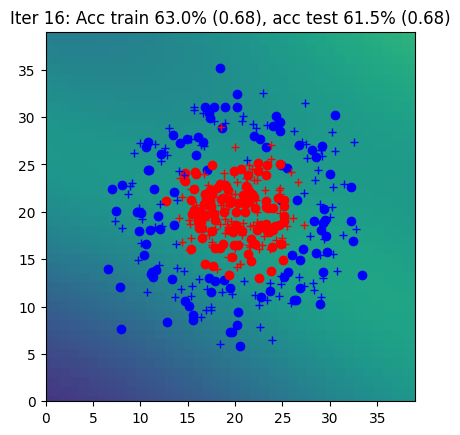

Iter 17: Acc train 64.5% (0.68), acc test 64.5% (0.68)


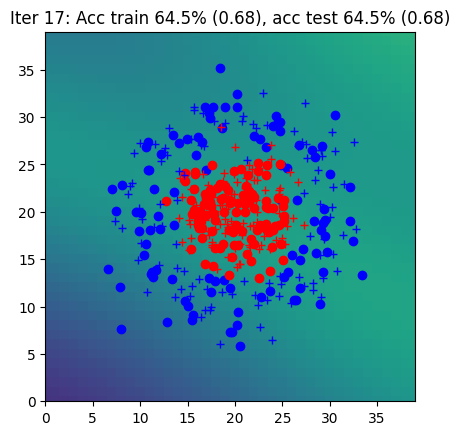

Iter 18: Acc train 65.0% (0.68), acc test 65.0% (0.68)


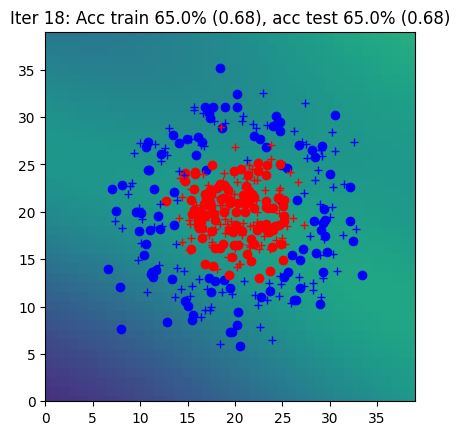

Iter 19: Acc train 64.0% (0.68), acc test 63.5% (0.68)


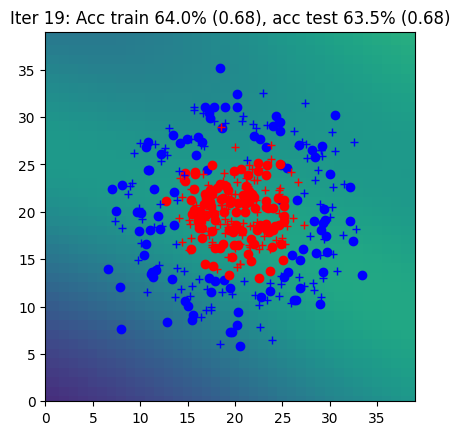

Iter 20: Acc train 72.0% (0.68), acc test 68.5% (0.68)


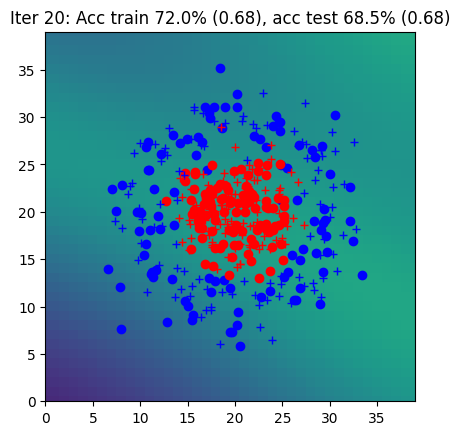

Iter 21: Acc train 71.0% (0.67), acc test 68.5% (0.68)


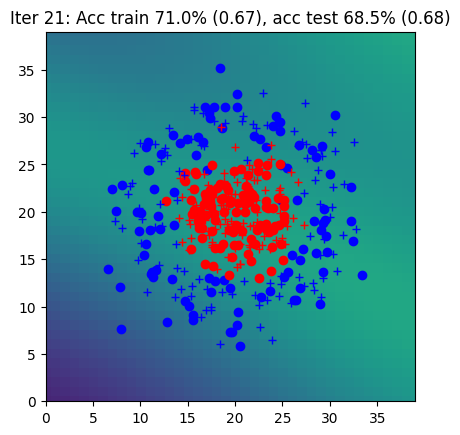

Iter 22: Acc train 73.0% (0.67), acc test 70.5% (0.68)


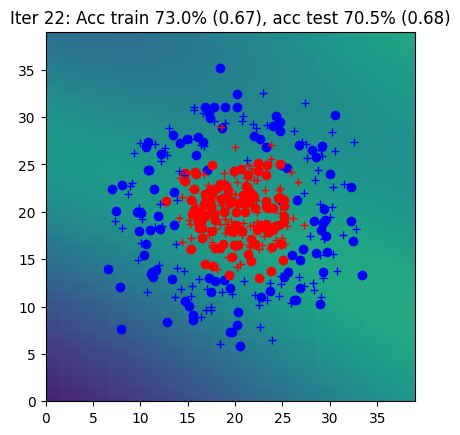

Iter 23: Acc train 68.5% (0.67), acc test 66.5% (0.68)


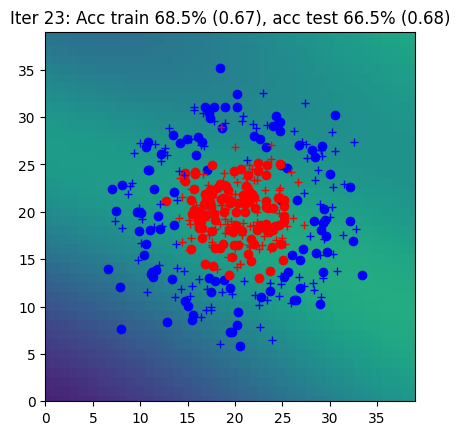

Iter 24: Acc train 75.0% (0.67), acc test 73.0% (0.67)


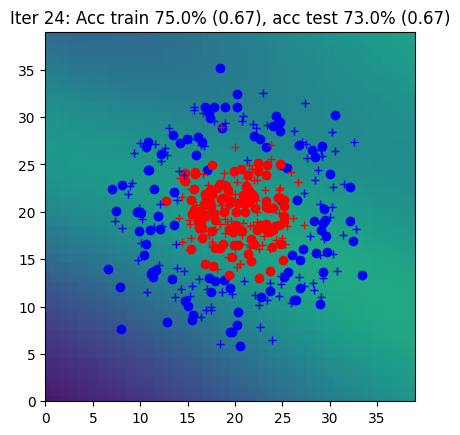

Iter 25: Acc train 74.5% (0.67), acc test 72.5% (0.67)


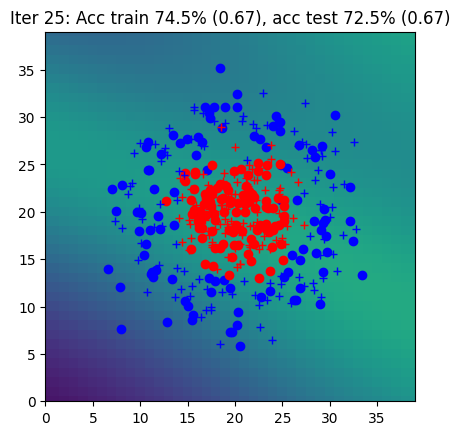

Iter 26: Acc train 76.0% (0.67), acc test 74.0% (0.67)


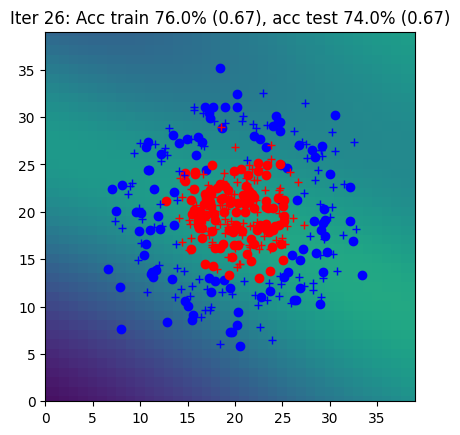

Iter 27: Acc train 77.0% (0.67), acc test 75.0% (0.67)


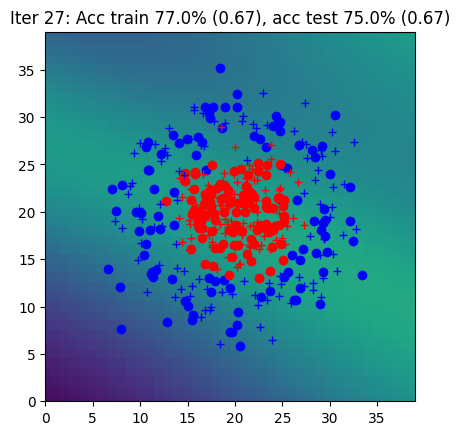

Iter 28: Acc train 73.5% (0.66), acc test 72.5% (0.67)


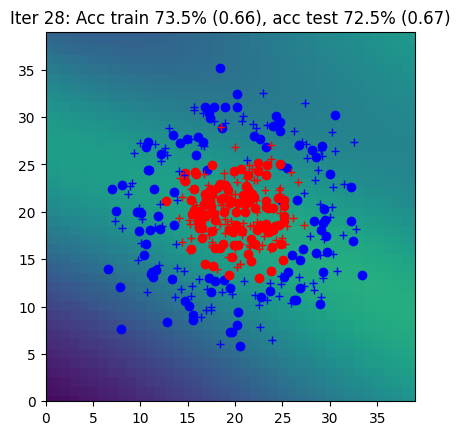

Iter 29: Acc train 75.0% (0.66), acc test 73.0% (0.67)


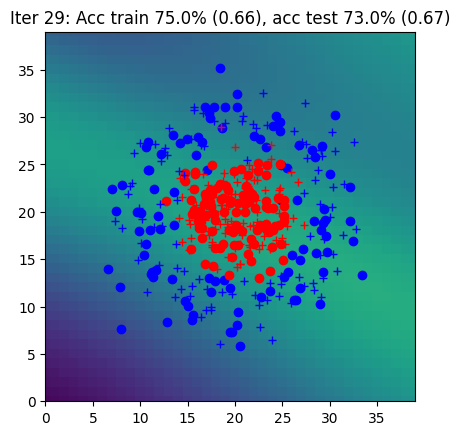

Iter 30: Acc train 76.0% (0.66), acc test 73.0% (0.67)


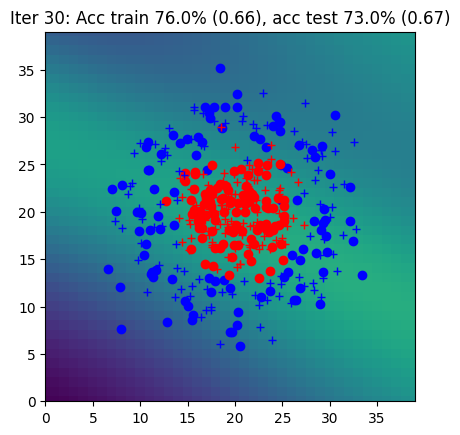

Iter 31: Acc train 75.5% (0.66), acc test 73.0% (0.66)


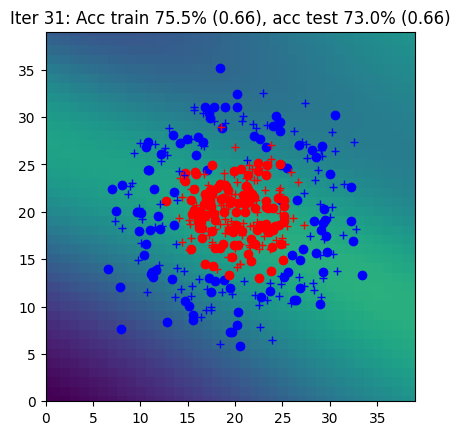

Iter 32: Acc train 73.5% (0.66), acc test 72.0% (0.66)


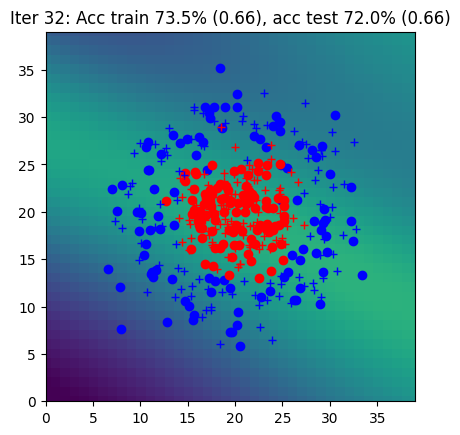

Iter 33: Acc train 77.0% (0.65), acc test 74.0% (0.66)


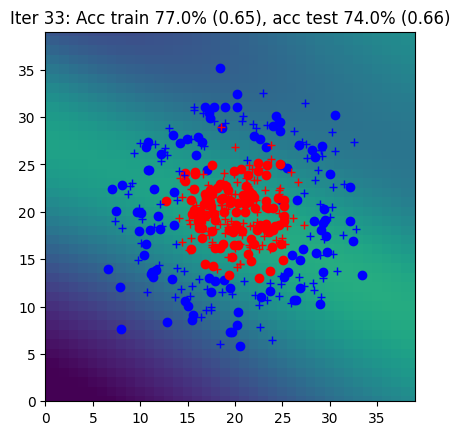

Iter 34: Acc train 75.5% (0.65), acc test 72.5% (0.66)


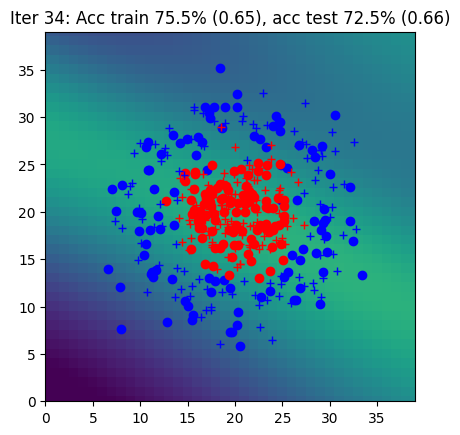

Iter 35: Acc train 75.0% (0.65), acc test 73.0% (0.66)


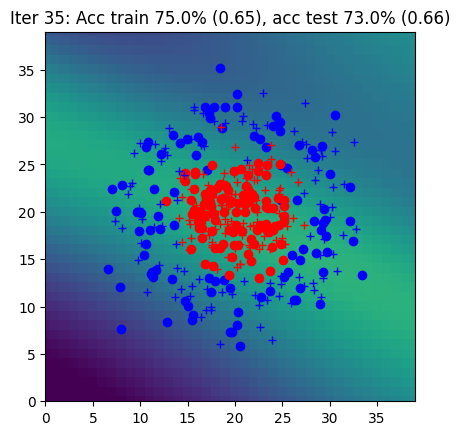

Iter 36: Acc train 75.5% (0.65), acc test 74.5% (0.65)


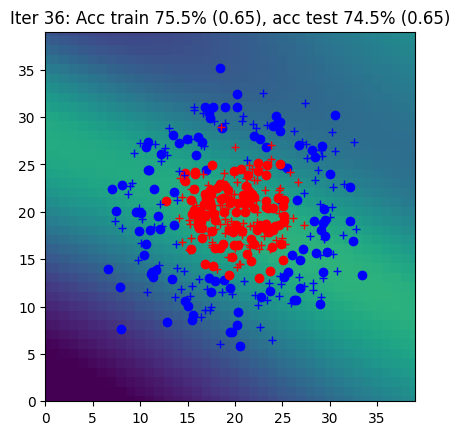

Iter 37: Acc train 76.0% (0.65), acc test 74.5% (0.65)


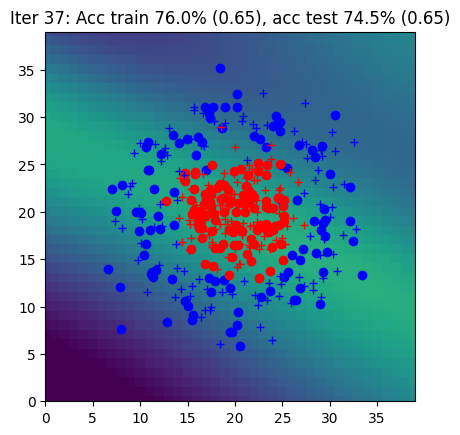

Iter 38: Acc train 76.0% (0.64), acc test 74.0% (0.65)


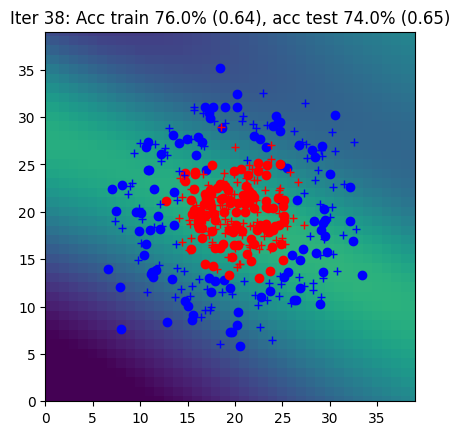

Iter 39: Acc train 75.0% (0.64), acc test 74.0% (0.65)


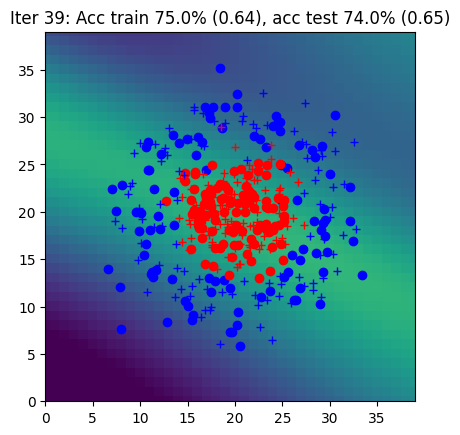

Iter 40: Acc train 76.0% (0.64), acc test 74.0% (0.64)


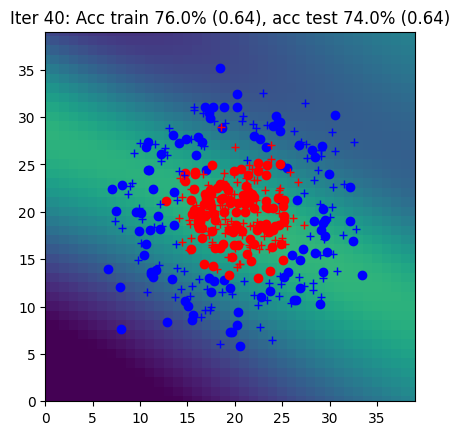

Iter 41: Acc train 76.5% (0.63), acc test 74.5% (0.64)


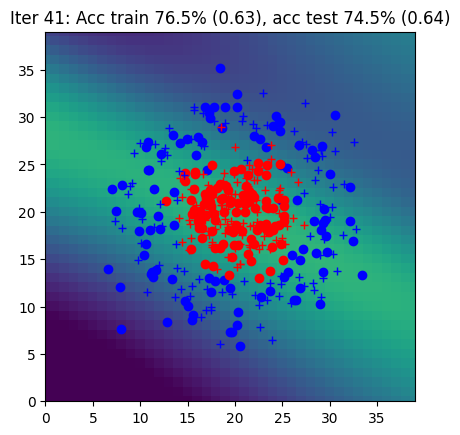

Iter 42: Acc train 75.0% (0.63), acc test 74.5% (0.64)


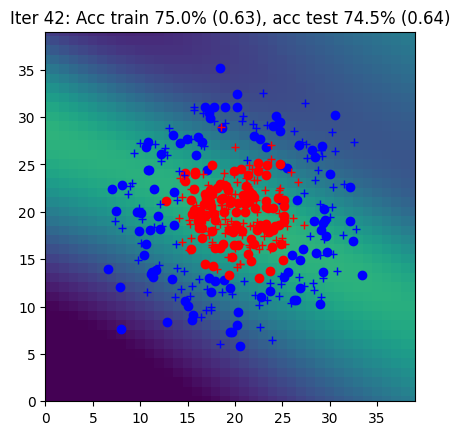

Iter 43: Acc train 74.5% (0.63), acc test 75.0% (0.64)


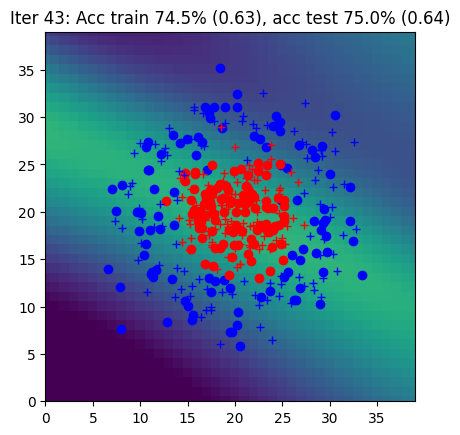

Iter 44: Acc train 74.5% (0.63), acc test 75.0% (0.64)


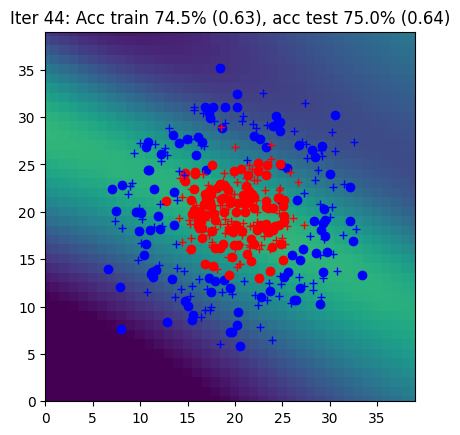

Iter 45: Acc train 75.0% (0.62), acc test 73.5% (0.63)


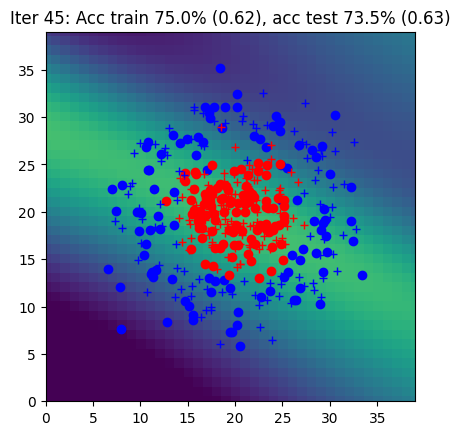

Iter 46: Acc train 76.0% (0.62), acc test 74.5% (0.63)


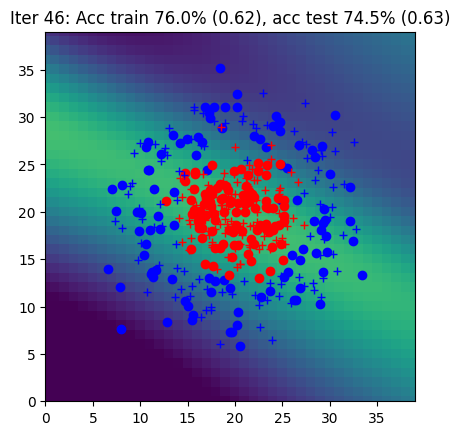

Iter 47: Acc train 75.5% (0.62), acc test 73.5% (0.63)


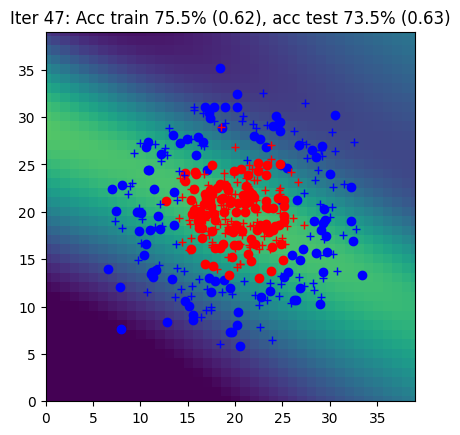

Iter 48: Acc train 75.0% (0.61), acc test 75.0% (0.62)


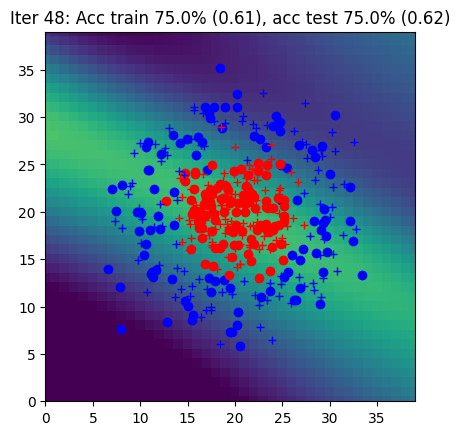

Iter 49: Acc train 74.0% (0.61), acc test 75.0% (0.62)


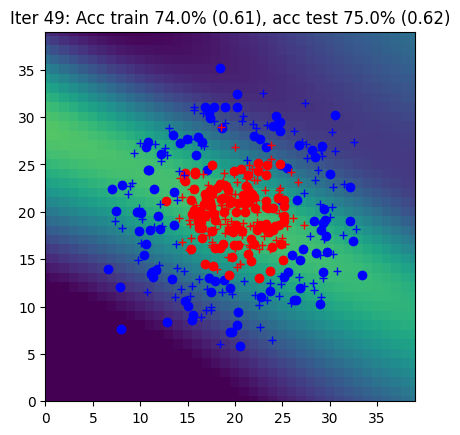

Iter 50: Acc train 74.0% (0.61), acc test 74.5% (0.62)


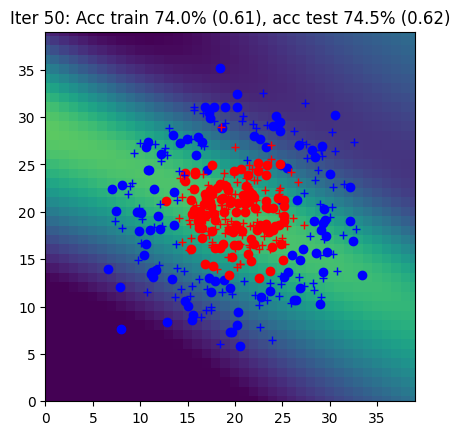

Iter 51: Acc train 75.0% (0.61), acc test 73.5% (0.62)


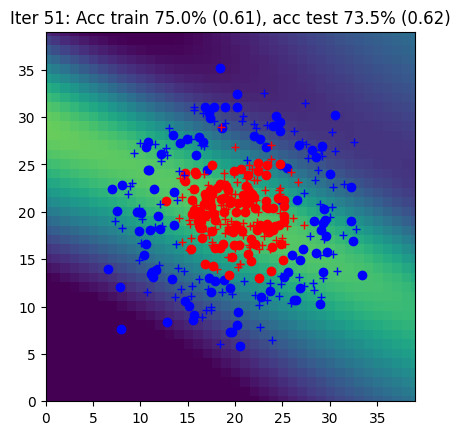

Iter 52: Acc train 75.5% (0.60), acc test 73.0% (0.61)


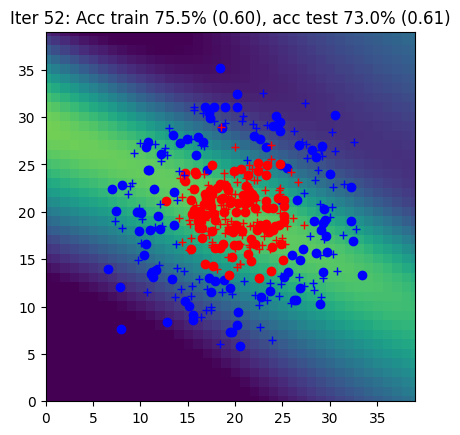

Iter 53: Acc train 75.0% (0.60), acc test 74.5% (0.61)


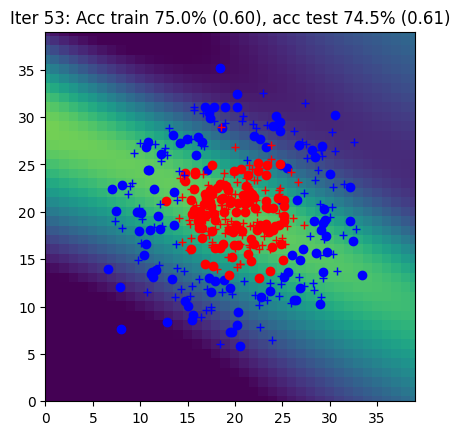

Iter 54: Acc train 75.5% (0.60), acc test 73.5% (0.61)


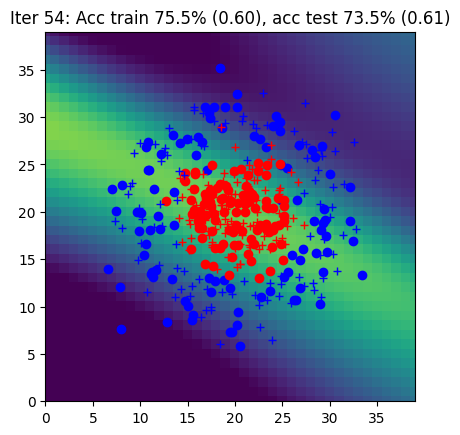

Iter 55: Acc train 74.5% (0.59), acc test 76.5% (0.61)


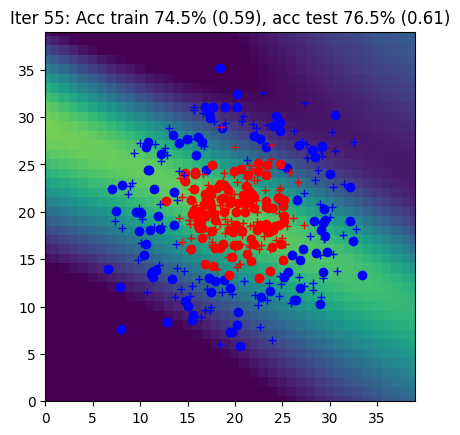

Iter 56: Acc train 76.0% (0.59), acc test 76.5% (0.60)


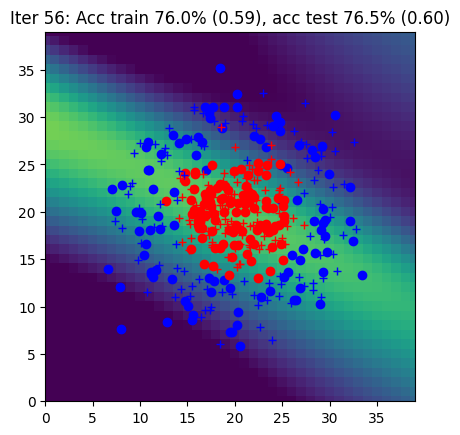

Iter 57: Acc train 76.5% (0.59), acc test 77.0% (0.60)


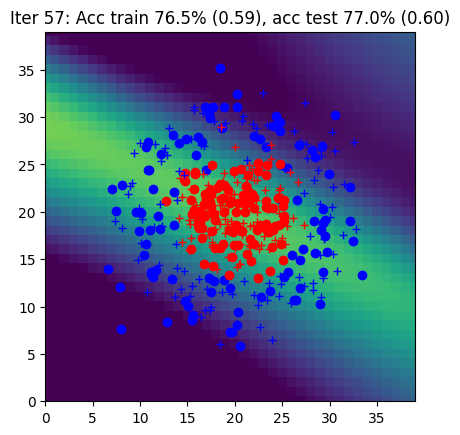

Iter 58: Acc train 76.0% (0.58), acc test 77.0% (0.60)


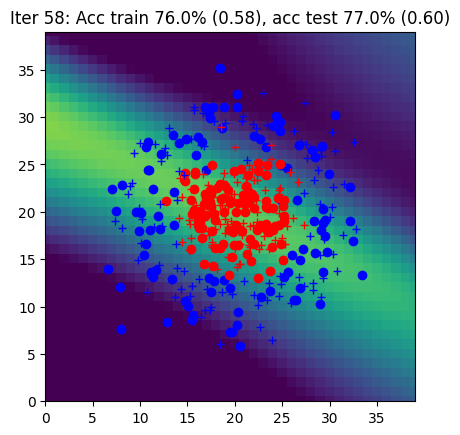

Iter 59: Acc train 74.5% (0.58), acc test 77.0% (0.59)


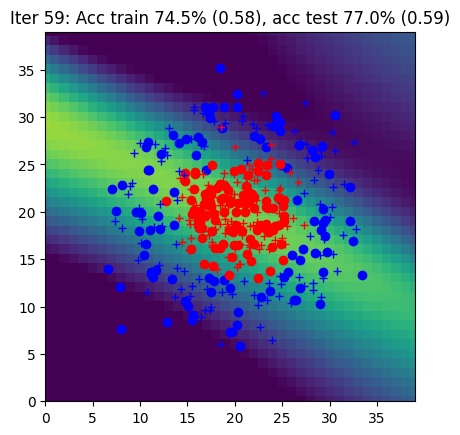

Iter 60: Acc train 74.5% (0.58), acc test 77.0% (0.59)


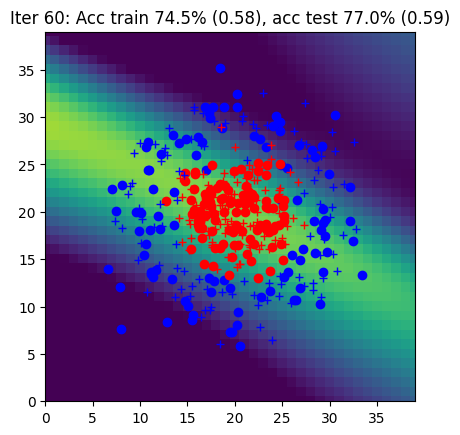

Iter 61: Acc train 76.0% (0.57), acc test 77.0% (0.59)


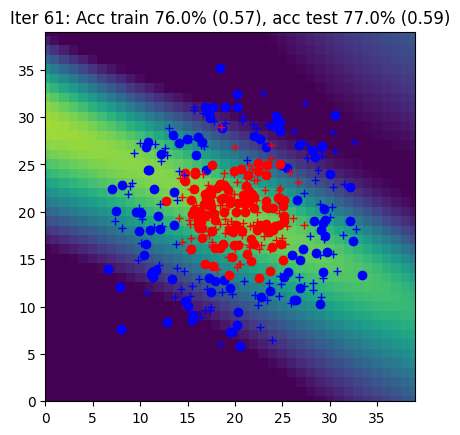

Iter 62: Acc train 74.5% (0.57), acc test 77.0% (0.59)


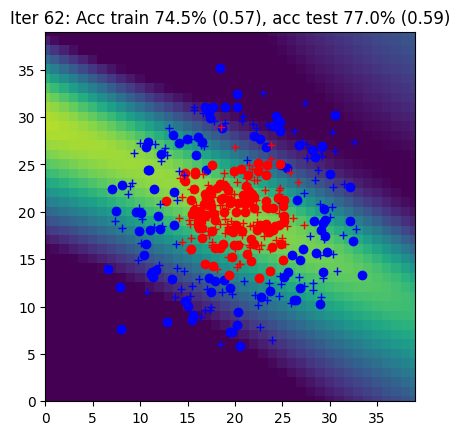

Iter 63: Acc train 74.5% (0.57), acc test 76.5% (0.58)


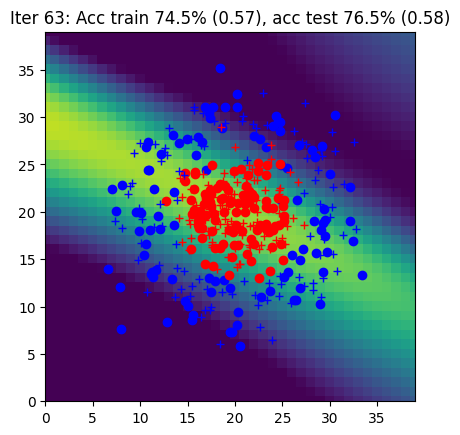

Iter 64: Acc train 75.0% (0.57), acc test 76.5% (0.58)


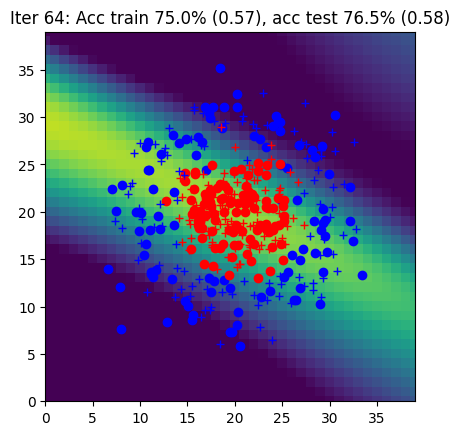

Iter 65: Acc train 74.5% (0.56), acc test 76.0% (0.58)


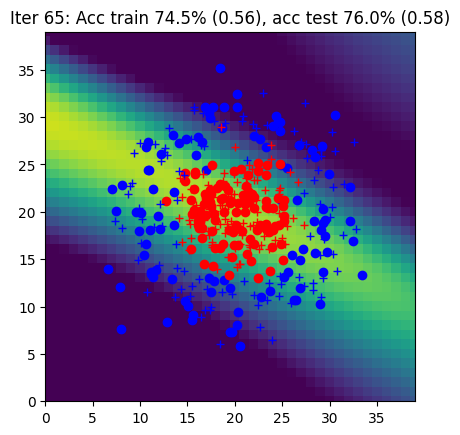

Iter 66: Acc train 74.5% (0.56), acc test 75.5% (0.58)


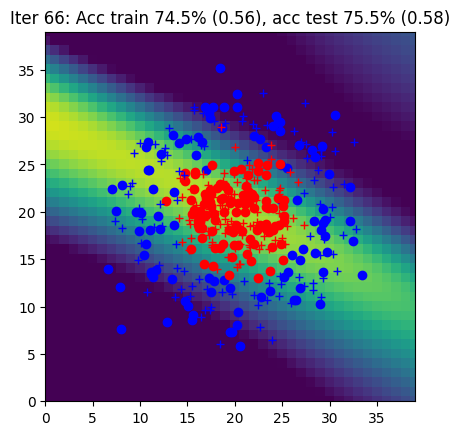

Iter 67: Acc train 74.5% (0.56), acc test 76.0% (0.57)


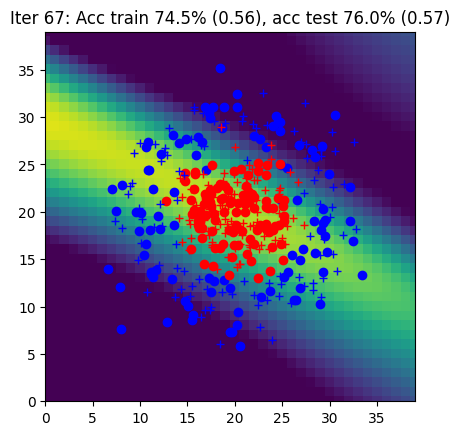

Iter 68: Acc train 75.5% (0.55), acc test 77.5% (0.57)


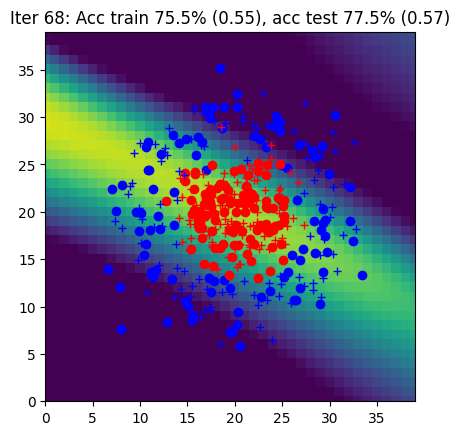

Iter 69: Acc train 75.0% (0.55), acc test 75.5% (0.57)


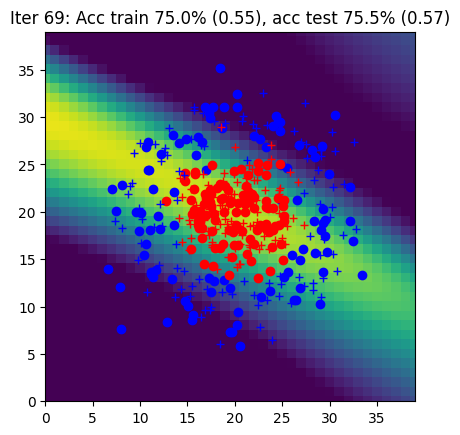

Iter 70: Acc train 76.0% (0.55), acc test 77.0% (0.57)


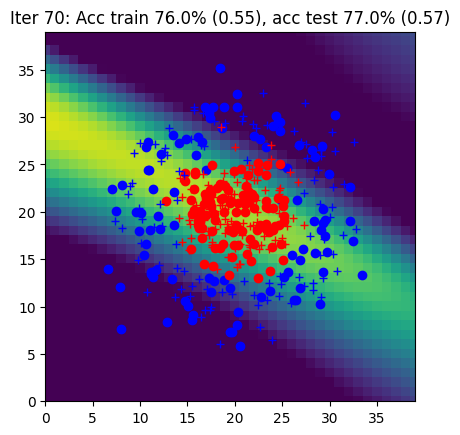

Iter 71: Acc train 76.0% (0.55), acc test 77.5% (0.56)


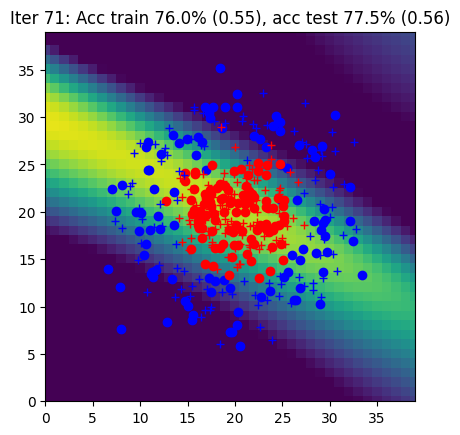

Iter 72: Acc train 76.0% (0.54), acc test 77.0% (0.56)


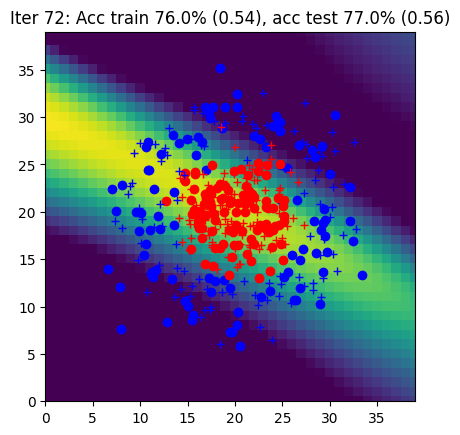

Iter 73: Acc train 76.0% (0.54), acc test 77.0% (0.56)


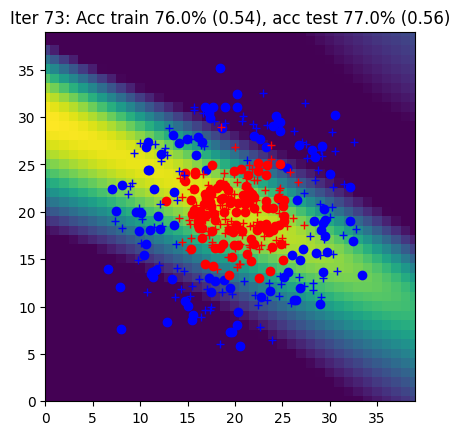

Iter 74: Acc train 76.0% (0.54), acc test 77.5% (0.56)


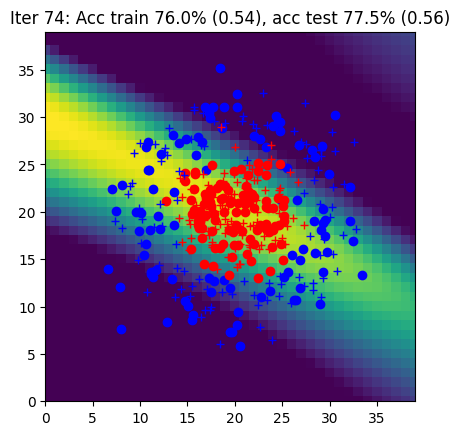

Iter 75: Acc train 76.0% (0.53), acc test 78.0% (0.55)


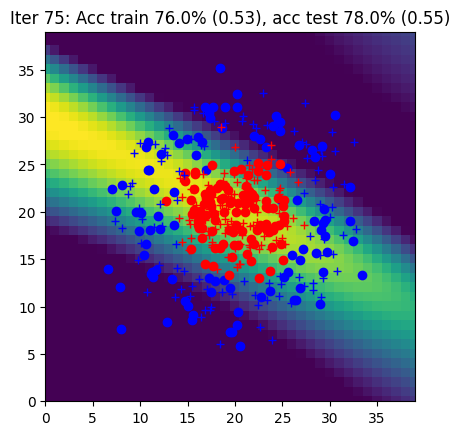

Iter 76: Acc train 76.0% (0.53), acc test 77.5% (0.55)


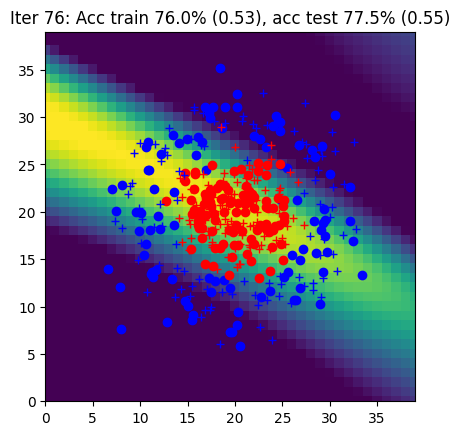

Iter 77: Acc train 76.5% (0.53), acc test 77.0% (0.55)


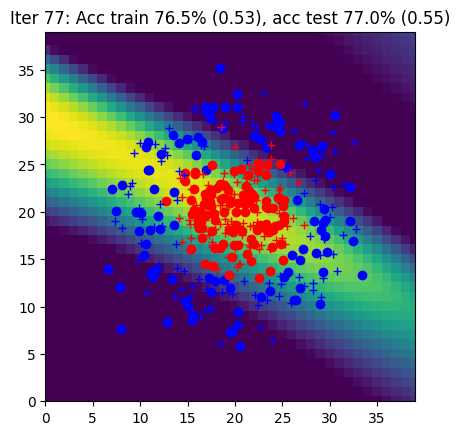

Iter 78: Acc train 75.5% (0.53), acc test 77.5% (0.55)


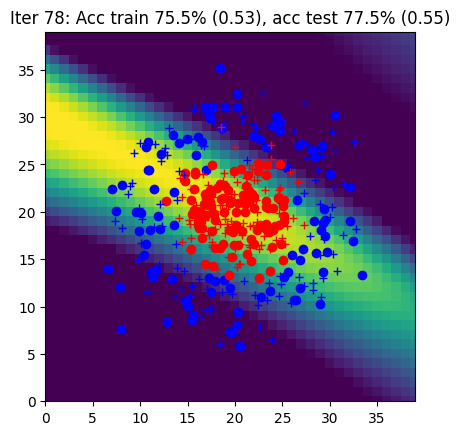

Iter 79: Acc train 76.5% (0.52), acc test 77.0% (0.55)


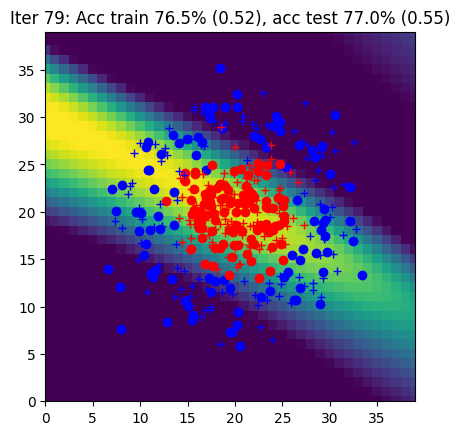

Iter 80: Acc train 77.0% (0.52), acc test 78.0% (0.55)


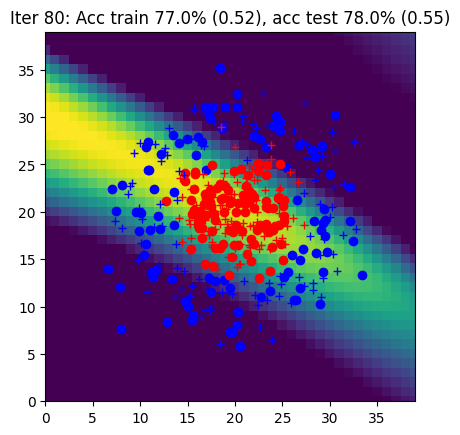

Iter 81: Acc train 76.5% (0.52), acc test 77.5% (0.54)


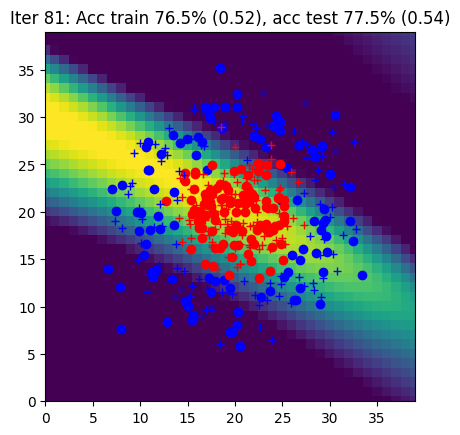

Iter 82: Acc train 77.5% (0.52), acc test 78.0% (0.54)


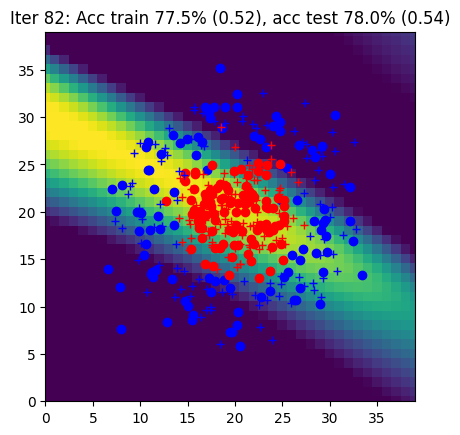

Iter 83: Acc train 76.0% (0.52), acc test 77.0% (0.54)


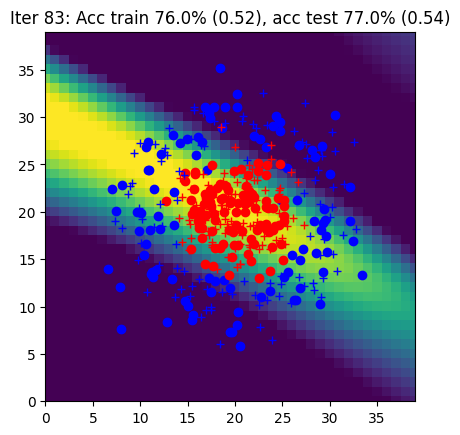

Iter 84: Acc train 76.0% (0.51), acc test 77.0% (0.54)


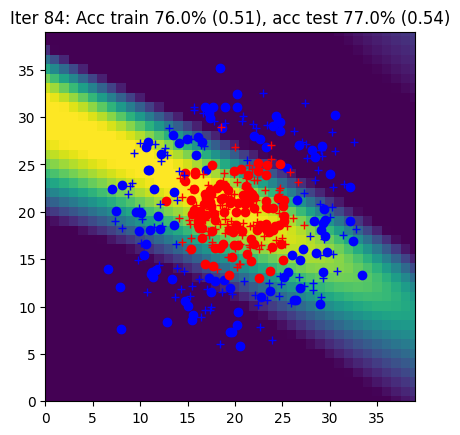

Iter 85: Acc train 76.0% (0.51), acc test 77.0% (0.53)


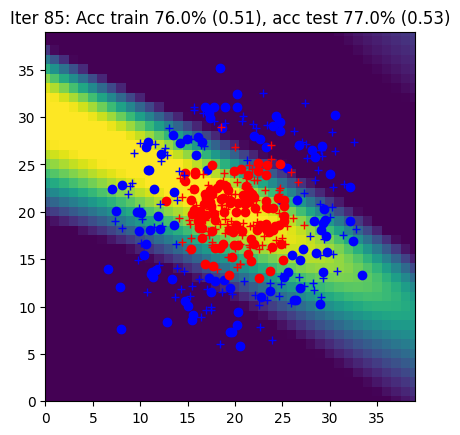

Iter 86: Acc train 75.5% (0.51), acc test 75.5% (0.53)


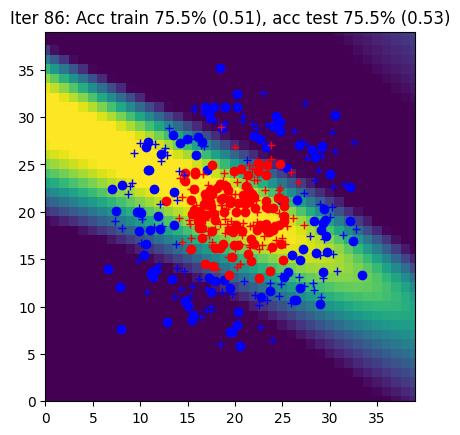

Iter 87: Acc train 76.0% (0.51), acc test 77.0% (0.53)


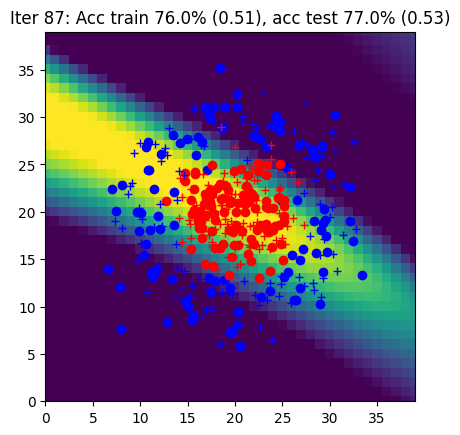

Iter 88: Acc train 76.0% (0.50), acc test 78.0% (0.53)


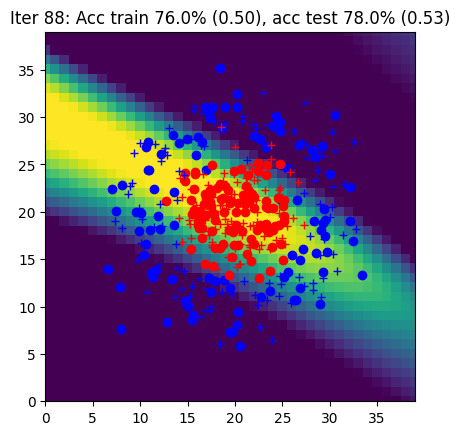

Iter 89: Acc train 77.0% (0.50), acc test 78.0% (0.53)


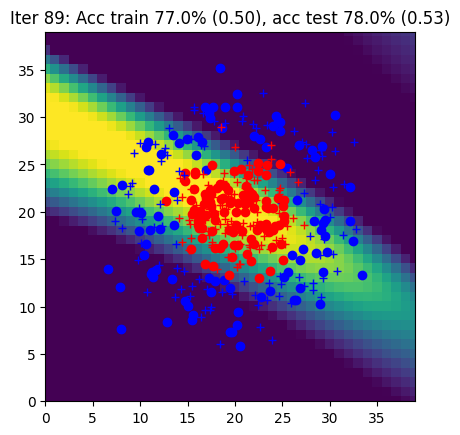

Iter 90: Acc train 76.5% (0.50), acc test 78.0% (0.52)


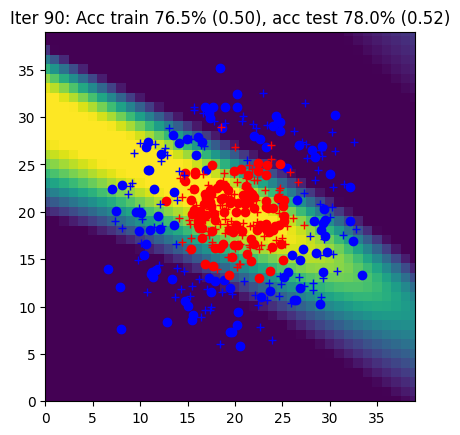

Iter 91: Acc train 76.0% (0.50), acc test 77.0% (0.52)


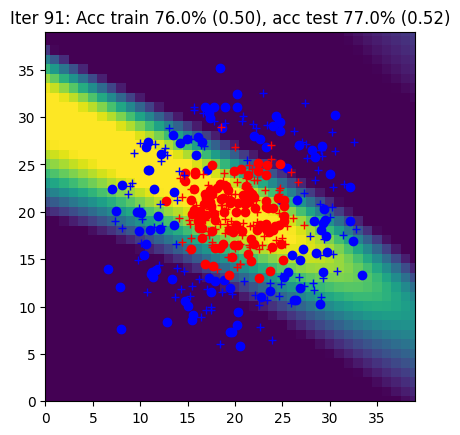

Iter 92: Acc train 78.0% (0.49), acc test 78.0% (0.52)


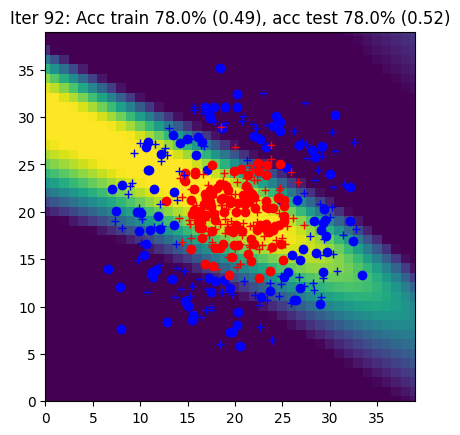

Iter 93: Acc train 78.0% (0.49), acc test 78.0% (0.52)


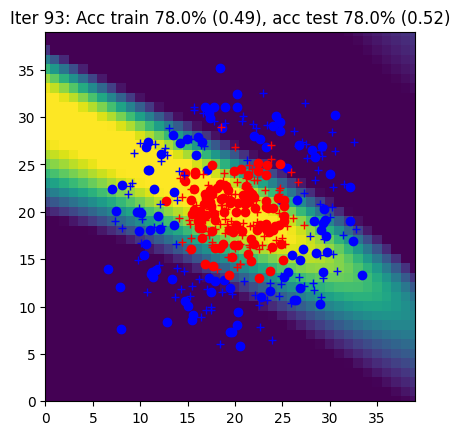

Iter 94: Acc train 78.5% (0.49), acc test 77.5% (0.52)


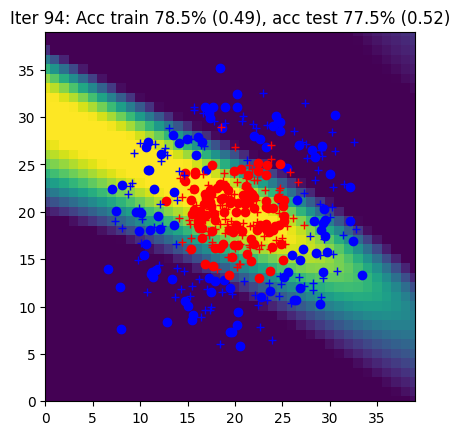

Iter 95: Acc train 78.5% (0.49), acc test 77.5% (0.52)


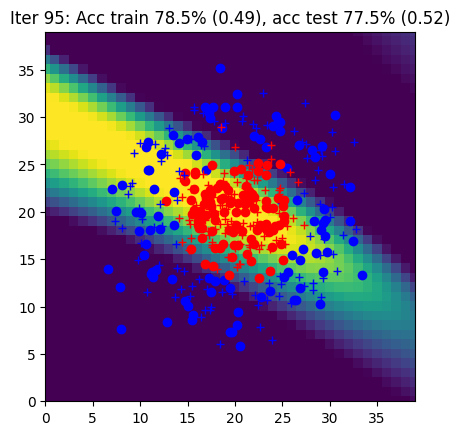

Iter 96: Acc train 79.0% (0.49), acc test 77.0% (0.52)


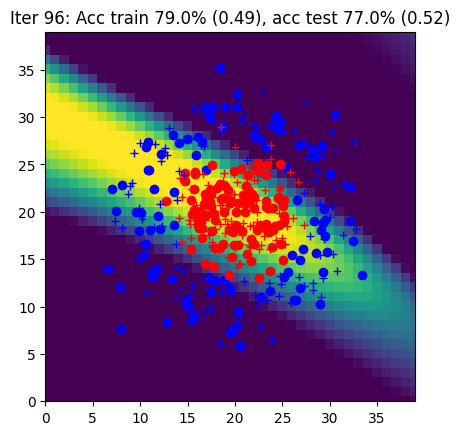

Iter 97: Acc train 78.5% (0.48), acc test 78.5% (0.51)


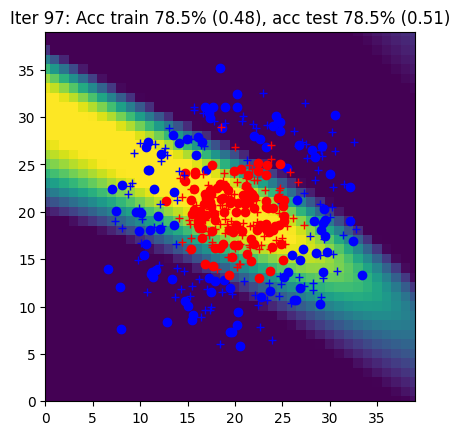

Iter 98: Acc train 77.5% (0.48), acc test 78.0% (0.51)


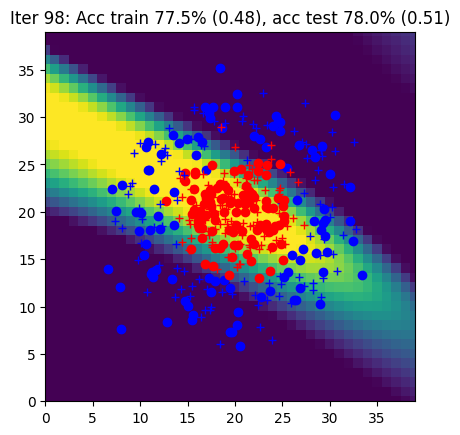

Iter 99: Acc train 78.5% (0.48), acc test 77.5% (0.51)


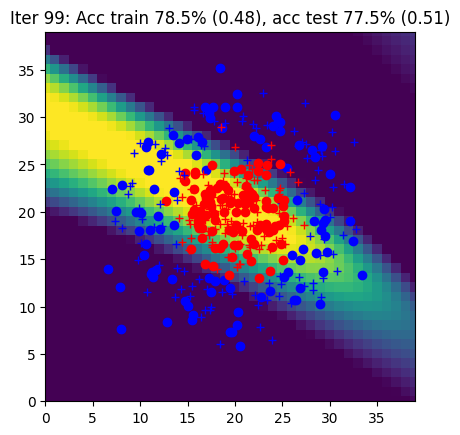

Iter 100: Acc train 79.0% (0.48), acc test 78.0% (0.51)


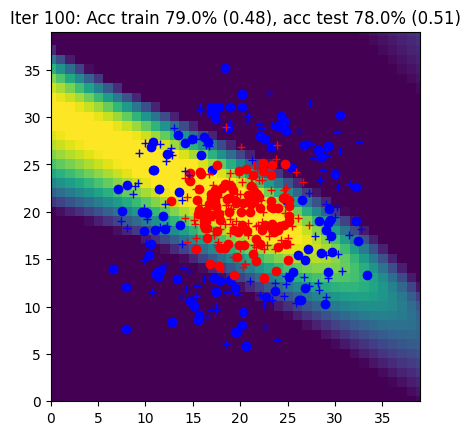

Iter 101: Acc train 78.5% (0.47), acc test 78.5% (0.50)


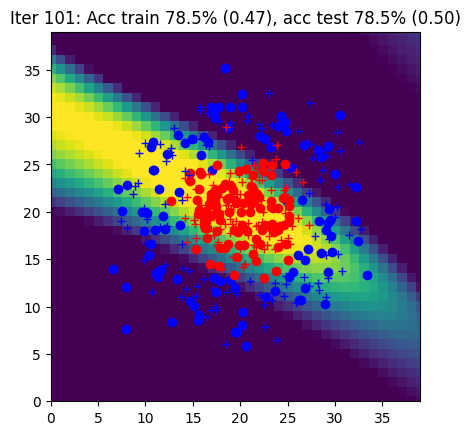

Iter 102: Acc train 78.5% (0.47), acc test 79.0% (0.50)


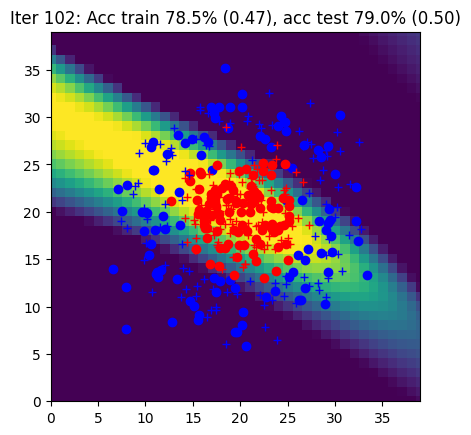

Iter 103: Acc train 78.5% (0.47), acc test 79.5% (0.50)


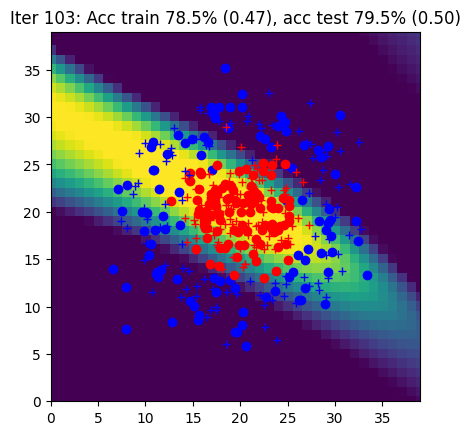

Iter 104: Acc train 79.0% (0.47), acc test 79.5% (0.50)


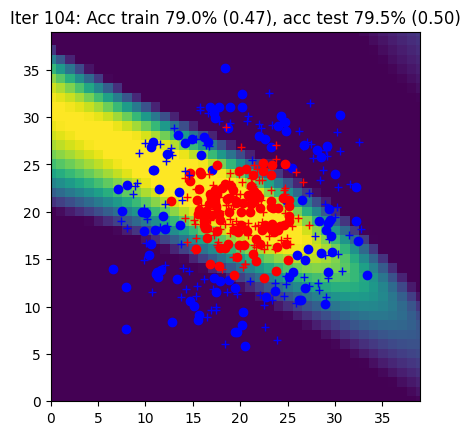

Iter 105: Acc train 79.0% (0.46), acc test 78.5% (0.50)


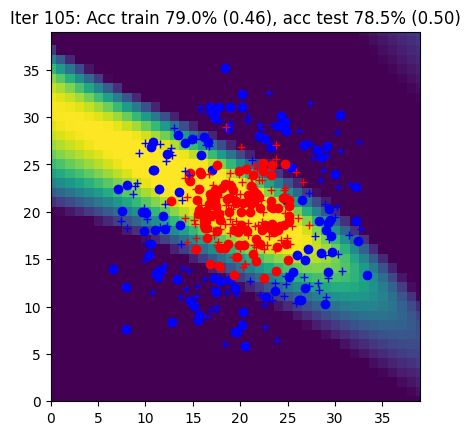

Iter 106: Acc train 79.0% (0.46), acc test 79.5% (0.49)


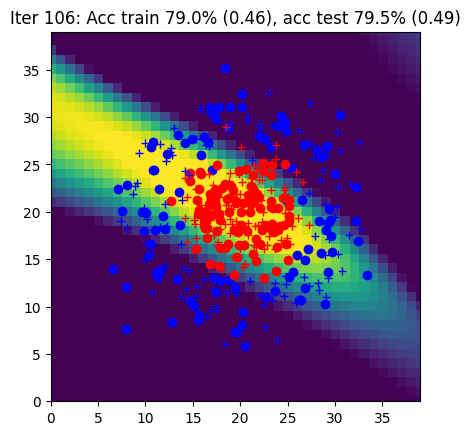

Iter 107: Acc train 79.0% (0.46), acc test 79.5% (0.49)


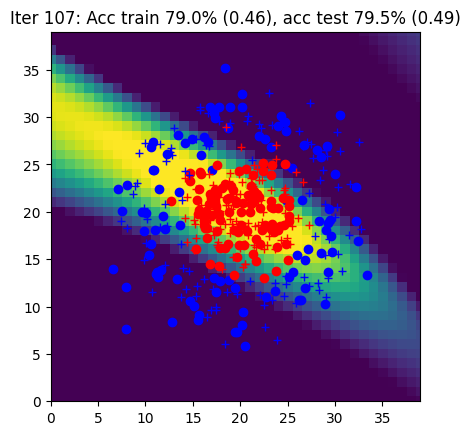

Iter 108: Acc train 79.5% (0.46), acc test 79.5% (0.49)


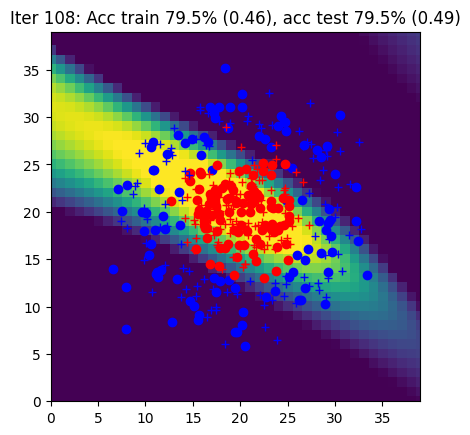

Iter 109: Acc train 80.0% (0.45), acc test 79.5% (0.49)


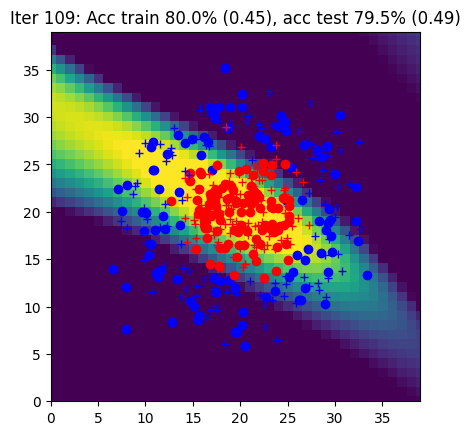

Iter 110: Acc train 79.5% (0.45), acc test 79.5% (0.48)


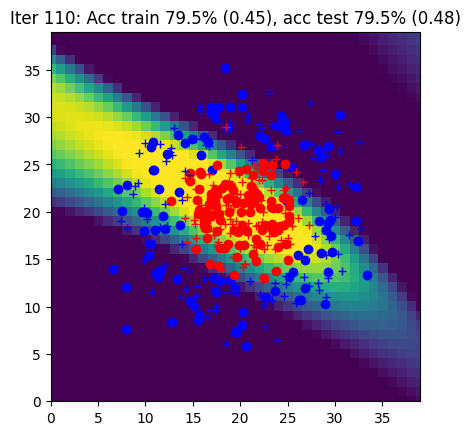

Iter 111: Acc train 79.5% (0.45), acc test 79.5% (0.48)


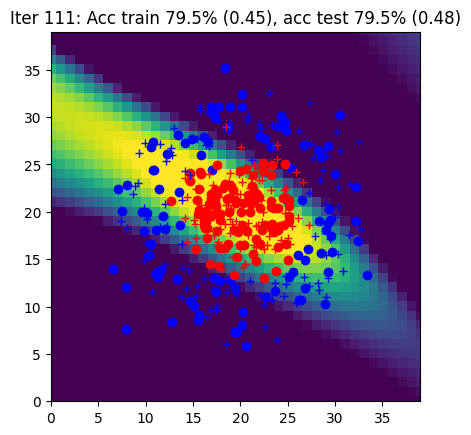

Iter 112: Acc train 79.5% (0.44), acc test 79.5% (0.47)


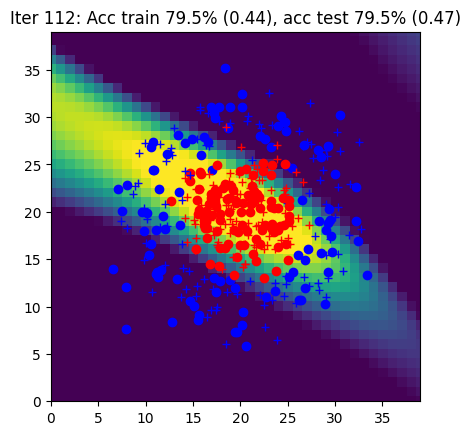

Iter 113: Acc train 80.0% (0.44), acc test 80.0% (0.47)


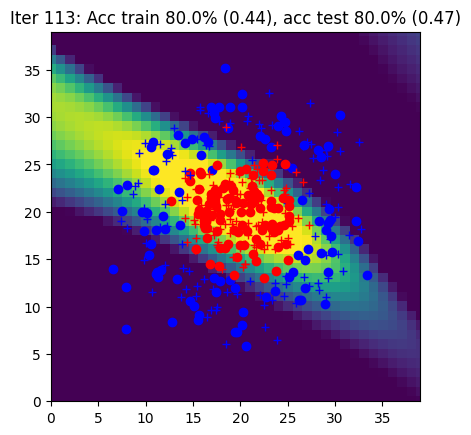

Iter 114: Acc train 79.5% (0.44), acc test 79.5% (0.47)


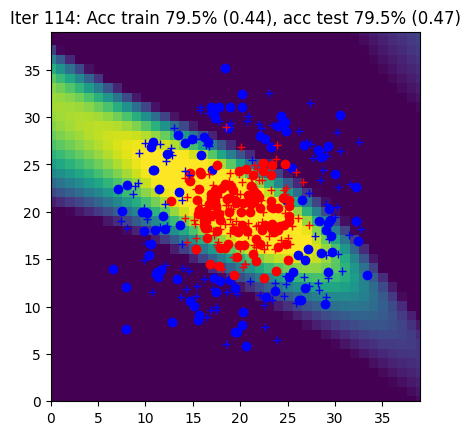

Iter 115: Acc train 80.0% (0.43), acc test 79.5% (0.46)


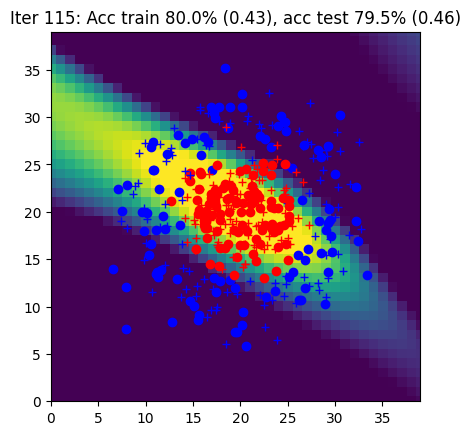

Iter 116: Acc train 80.5% (0.43), acc test 80.0% (0.46)


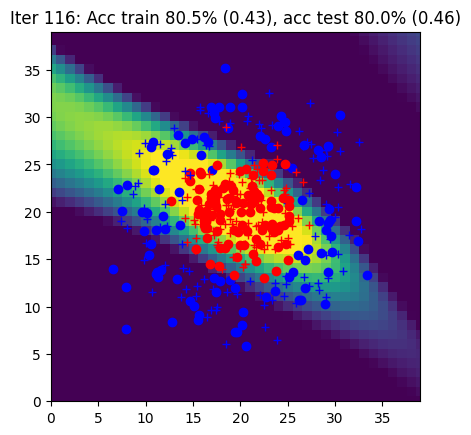

Iter 117: Acc train 80.5% (0.43), acc test 80.5% (0.46)


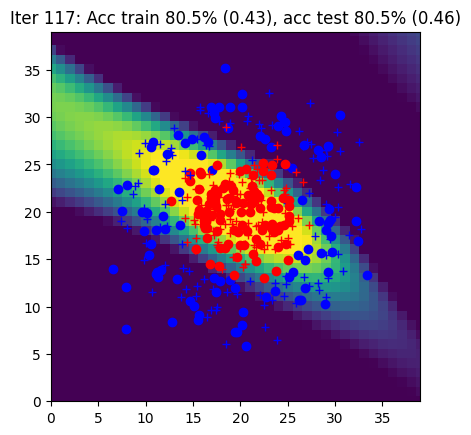

Iter 118: Acc train 80.0% (0.42), acc test 79.5% (0.45)


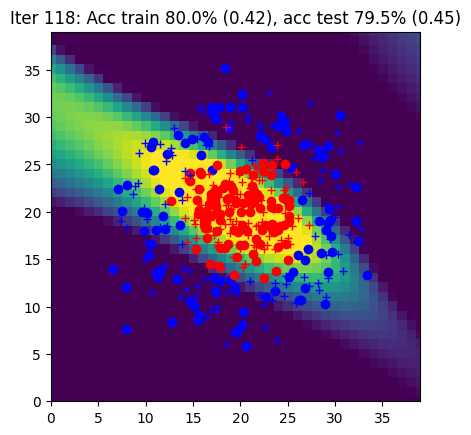

Iter 119: Acc train 82.5% (0.42), acc test 80.5% (0.45)


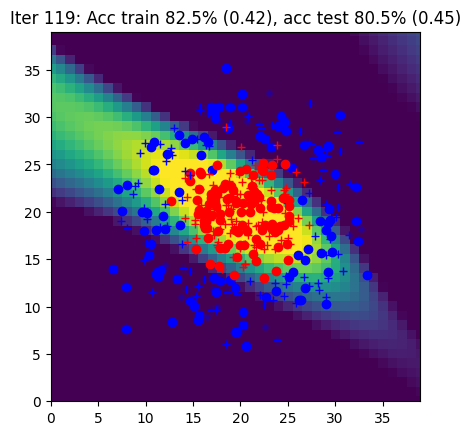

Iter 120: Acc train 82.5% (0.41), acc test 81.0% (0.45)


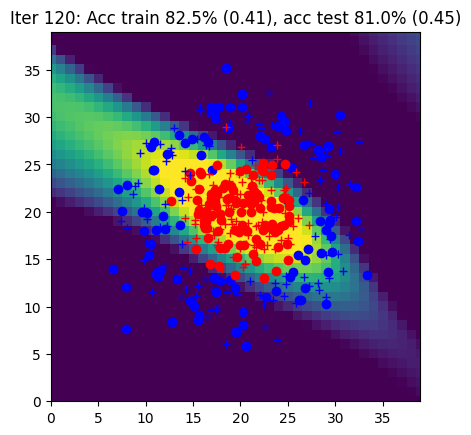

Iter 121: Acc train 83.0% (0.41), acc test 82.0% (0.44)


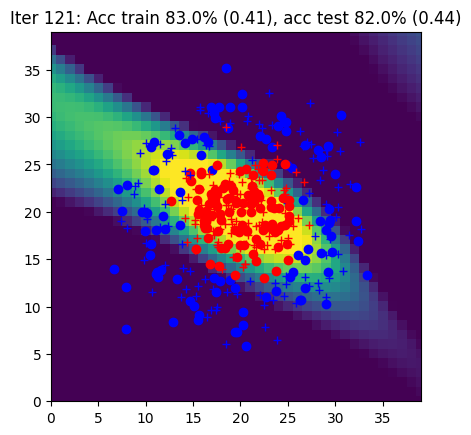

Iter 122: Acc train 83.5% (0.40), acc test 82.0% (0.44)


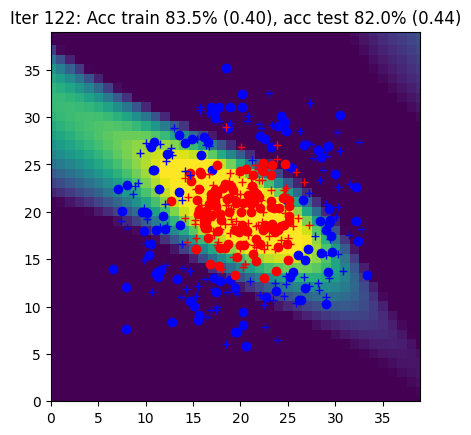

Iter 123: Acc train 83.5% (0.40), acc test 82.0% (0.43)


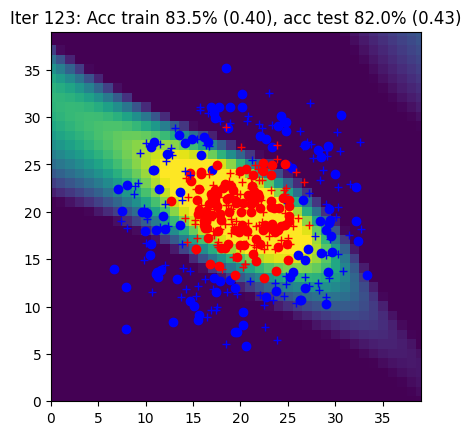

Iter 124: Acc train 84.0% (0.40), acc test 83.5% (0.43)


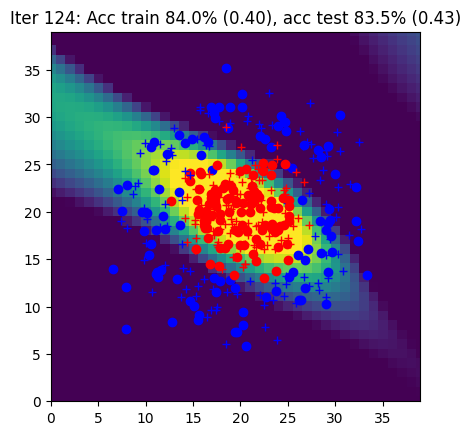

Iter 125: Acc train 84.0% (0.39), acc test 84.0% (0.42)


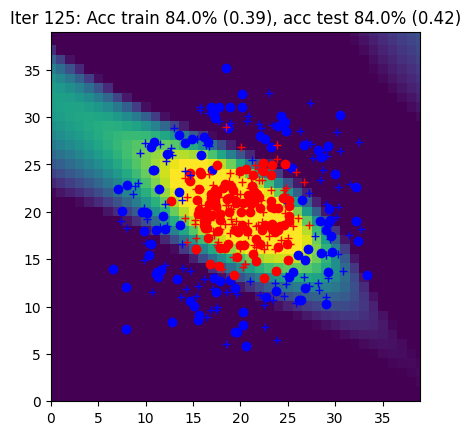

Iter 126: Acc train 85.5% (0.39), acc test 84.5% (0.42)


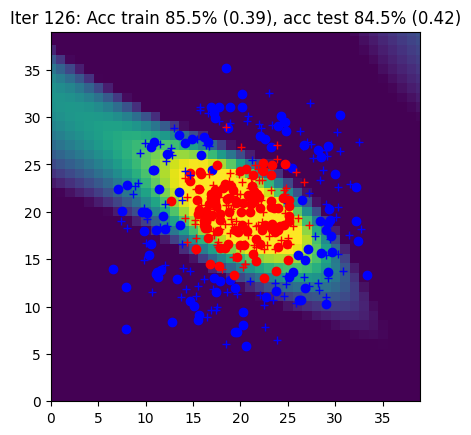

Iter 127: Acc train 85.0% (0.38), acc test 85.0% (0.41)


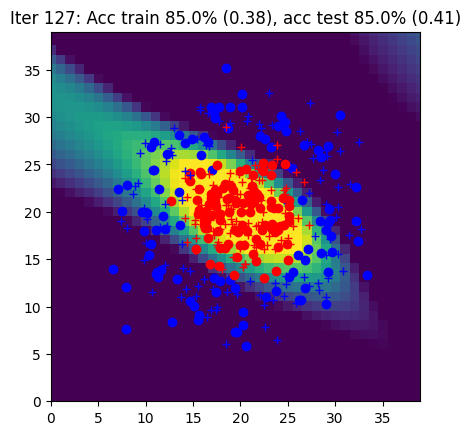

Iter 128: Acc train 85.5% (0.38), acc test 86.0% (0.41)


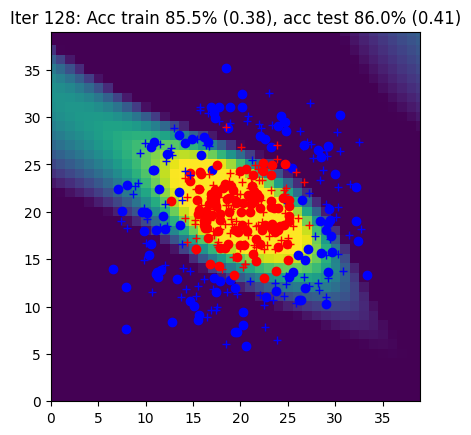

Iter 129: Acc train 85.0% (0.37), acc test 86.0% (0.40)


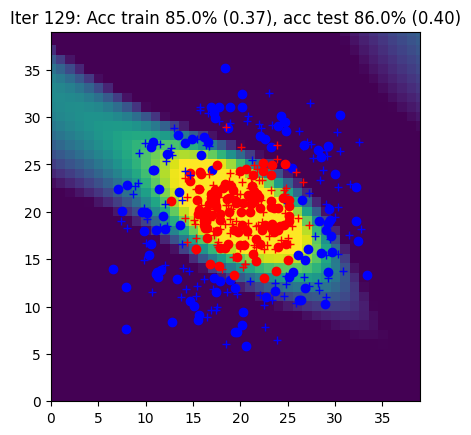

Iter 130: Acc train 85.5% (0.37), acc test 86.0% (0.40)


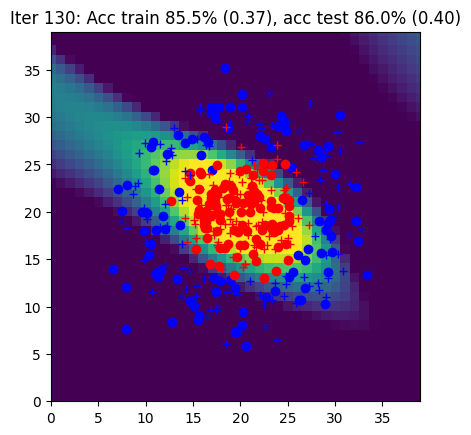

Iter 131: Acc train 87.0% (0.37), acc test 86.0% (0.39)


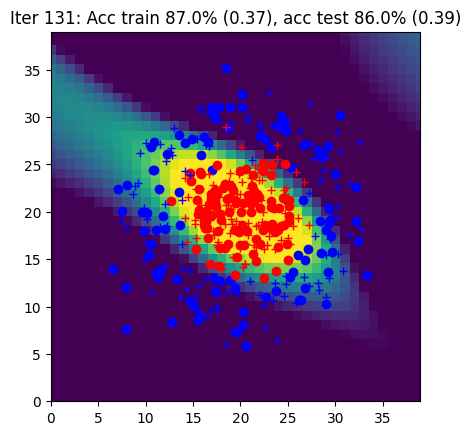

Iter 132: Acc train 86.5% (0.36), acc test 87.0% (0.39)


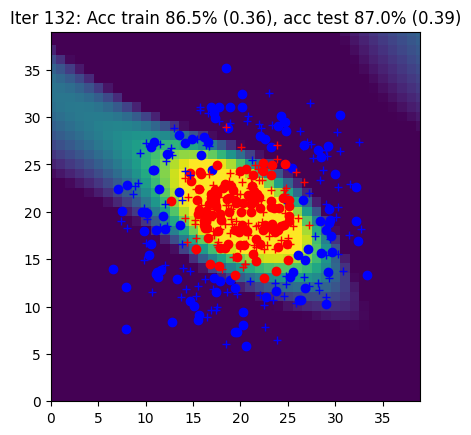

Iter 133: Acc train 86.5% (0.36), acc test 87.0% (0.39)


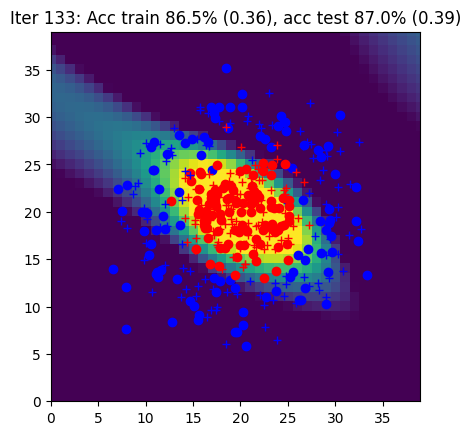

Iter 134: Acc train 86.5% (0.35), acc test 87.5% (0.38)


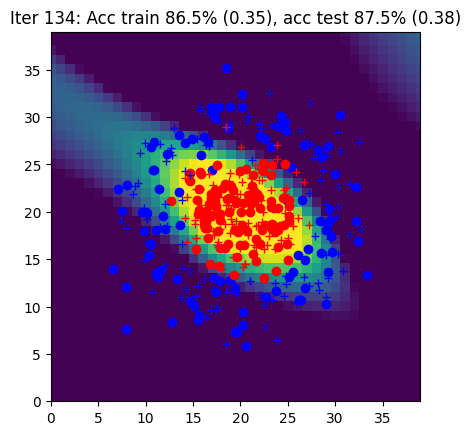

Iter 135: Acc train 86.5% (0.35), acc test 88.5% (0.38)


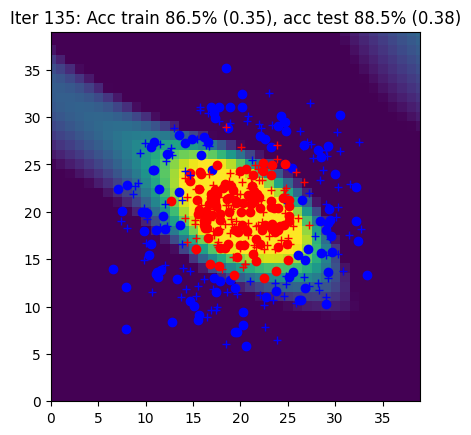

Iter 136: Acc train 87.5% (0.34), acc test 89.5% (0.37)


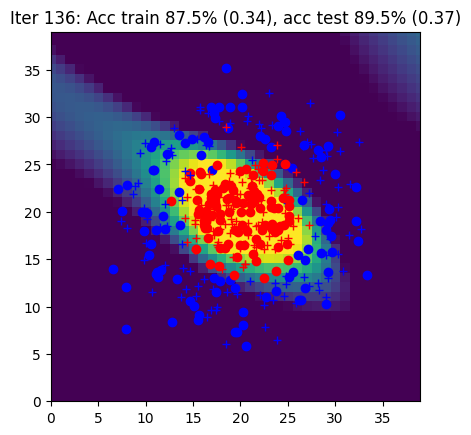

Iter 137: Acc train 88.0% (0.34), acc test 89.5% (0.37)


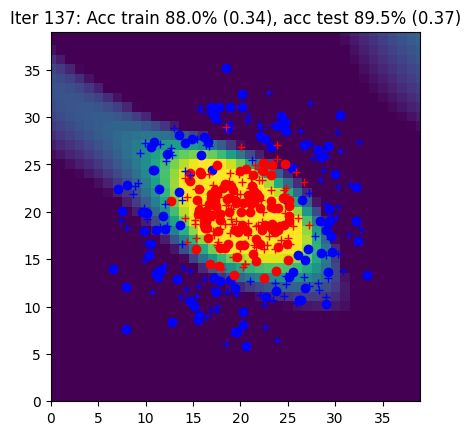

Iter 138: Acc train 89.0% (0.33), acc test 90.0% (0.36)


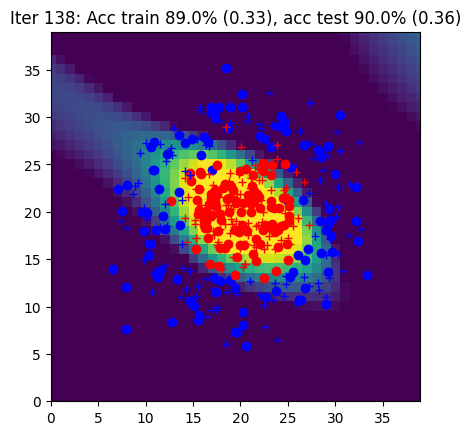

Iter 139: Acc train 90.0% (0.33), acc test 90.0% (0.36)


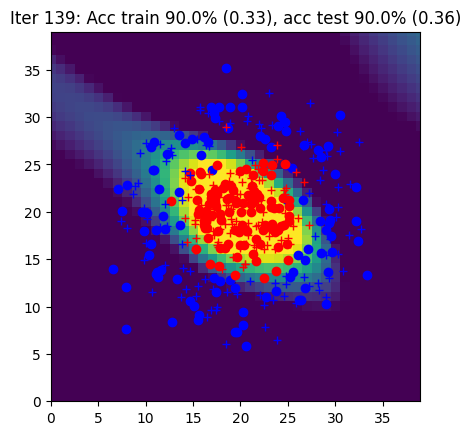

Iter 140: Acc train 91.5% (0.32), acc test 90.0% (0.35)


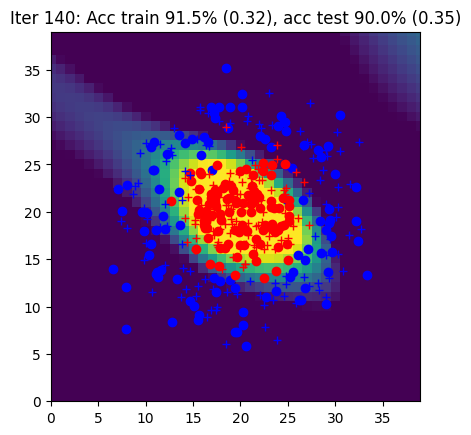

Iter 141: Acc train 91.5% (0.32), acc test 91.0% (0.35)


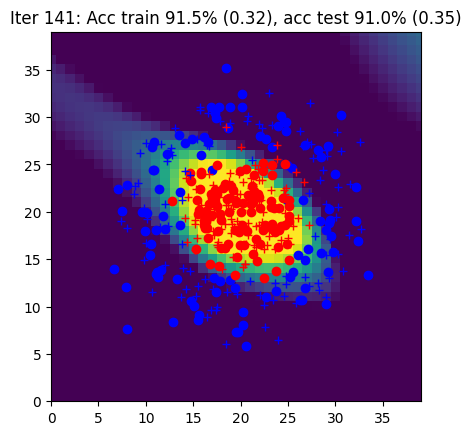

Iter 142: Acc train 91.5% (0.32), acc test 91.5% (0.34)


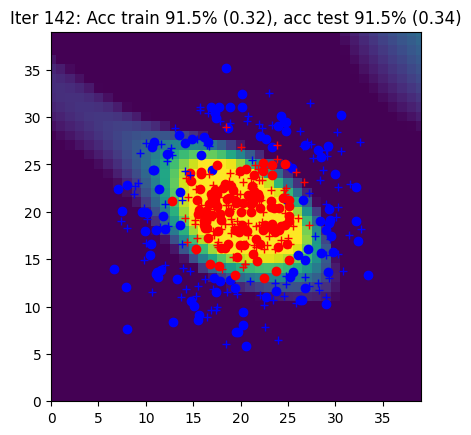

Iter 143: Acc train 92.5% (0.31), acc test 92.5% (0.34)


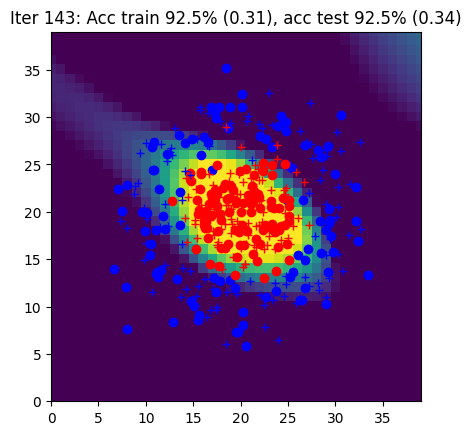

Iter 144: Acc train 92.0% (0.31), acc test 93.0% (0.34)


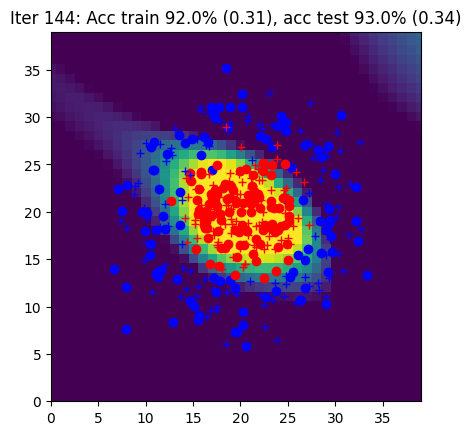

Iter 145: Acc train 92.5% (0.30), acc test 94.0% (0.33)


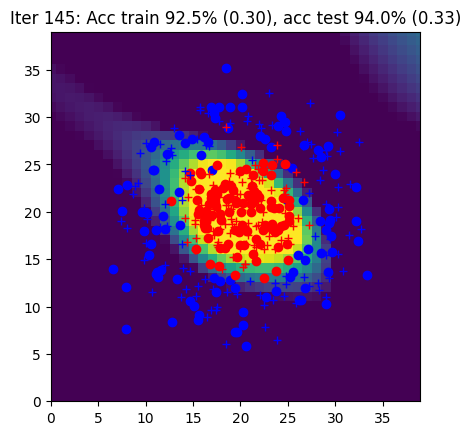

Iter 146: Acc train 92.5% (0.30), acc test 95.0% (0.33)


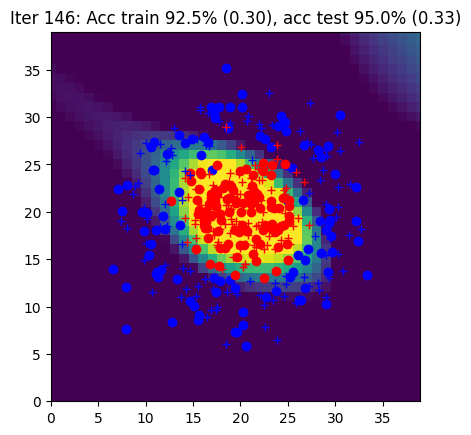

Iter 147: Acc train 92.5% (0.30), acc test 94.5% (0.32)


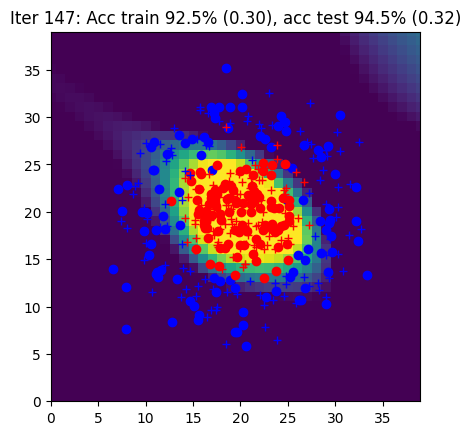

Iter 148: Acc train 93.0% (0.29), acc test 94.5% (0.32)


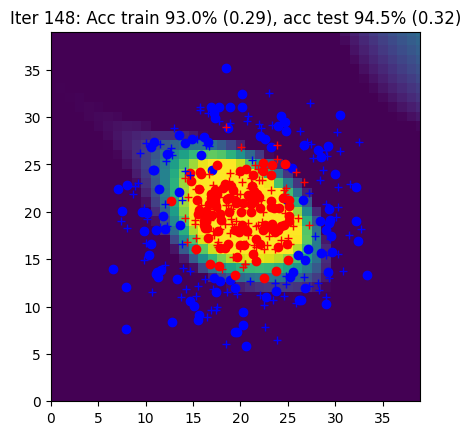

Iter 149: Acc train 93.0% (0.29), acc test 94.5% (0.31)


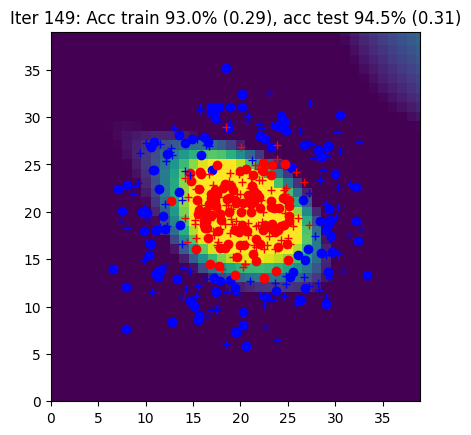

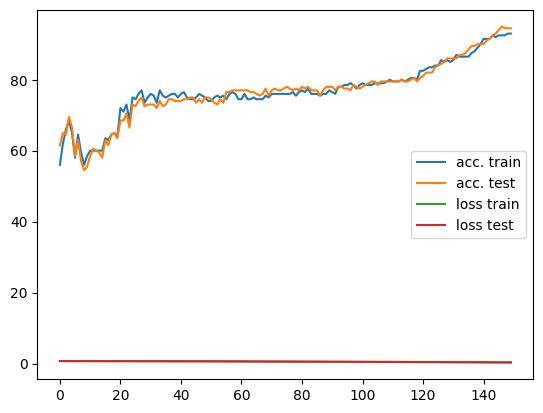

In [ ]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[],[], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j+1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]


        X_tensor = torch.tensor(X, dtype=torch.float32)
        Y_tensor = torch.tensor(Y, dtype=torch.float32)

        # Forward pass: Compute predicted y by passing x to the model
        Y_hat, outputs = forward(params, X_tensor)

        loss, accuracy = loss_accuracy(Y_hat, Y_tensor)

        # Zero the gradients
        for param in params.values():
            if param.grad is not None:
                param.grad.zero_()

        # Backward pass
        loss.backward()

        # Update parameters using SGD
        params = sgd(params, eta)


    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = 'Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})'.format(iteration, acctrain, Ltrain, acctest, Ltest)
    print(title)
    # detach() est utilisé pour détacher les predictions du graphes de calcul autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain)
    curves[1].append(acctest)
    curves[2].append(Ltrain)
    curves[3].append(Ltest)


# Convert any tensors in curves to numpy arrays after detaching them from the computation graph (code generated by ChatGPT)
curves_np = [[c.detach().numpy() if isinstance(c, torch.Tensor) else c for c in curve] for curve in curves]

fig = plt.figure()
plt.plot(curves_np[0], label="acc. train")
plt.plot(curves_np[1], label="acc. test")
plt.plot(curves_np[2], label="loss train")
plt.plot(curves_np[3], label="loss test")
plt.legend()
plt.show()

# Part 3 : Deeper neural network (Bonus)

Fundamentally, adding an additional hidden layer would just add some computations in the forward and backward along with new weights.

Can you adapt the previous code and derivations to train a three layer neural network?

# Part 4 : MNIST (Bonus)


Adapt the previous code to the MNIST dataset MNIST.